# Controller pipeline

## Load utils

### Utils functions

In [ ]:
from skimage.morphology import skeletonize , thin, medial_axis
from skimage.util import invert
from skimage.util import img_as_ubyte
from skimage.measure import find_contours, approximate_polygon, subdivide_polygon
from skimage.filters import threshold_sauvola
import time
from pathlib import Path
import seaborn as sns
from scipy.interpolate import make_interp_spline, BSpline
import matplotlib.pyplot as plt
import numpy as np
from fastai.vision.all import *
from pathlib import Path
from help_funcs import get_shape as get_shape_hf
import cv2 as cv
from sklearn.metrics import mean_squared_error 
from PIL import Image
from fastai.vision.all import *
import dill
from ultralytics import YOLO
import control_utils 
import pandas as pd
import glob
import math

output_path = Path('path_to_buffer_folder/data_real_shapes/test_buffer')
output_path.mkdir(parents=True, exist_ok=True)
buf_path = output_path.joinpath('buf_image.jpg')
buf_path1 = output_path / f'buf_image1.jpg'
buf_path2 = output_path.joinpath('buf_image2.jpg')
buf_path3 = output_path / f'buf_image3.jpg'
buf_path4 = output_path.joinpath('buf_image4.jpg')




### Load models

In [2]:
yolo_model = YOLO('./runs/segment/train10/weights/best.pt') # load a pretrained model.

model = load_learner('./models/export_models/model_2Delstica_HuberLoss_resnet50_trainset_pipeline_update',cpu=False,pickle_module=dill) # load ResNet model


## Load image

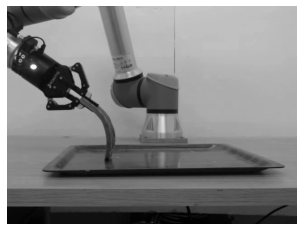

In [3]:
## Load image file
image_path =  './data_real_shapes/video_with_planner/data/beef1/2_-0.38931_-0.009_0.9773843811168237:0.28_0.07_0.7699999999999998_0.14_0.0:-0.20220557092837715_0.11405428253908352_2.3612947313694583.jpg'



img_src = cv.imread(image_path, cv.IMREAD_COLOR_RGB) # cv.IMREAD_GRAYSCALE
plt.imshow(img_src,cmap=plt.cm.gray)
plt.axis('off')
plt.show()

### Testing code

In [ ]:
start_time=time.time()

## get labels 
# inx, labels, base_frame = control_utils.get_label_inx(Path(image_path))
inx, labels, base_frame, TCP_base_frame = control_utils.get_label_inx_real(Path(image_path))
L,l = base_frame[3], base_frame[4]
base_frame = base_frame[:3]

img = cv.imread(str(image_path), cv.IMREAD_COLOR_RGB)

croped_image = control_utils.crop_model(img, yolo_model)


img = cv.imread(str(buf_path), cv.IMREAD_UNCHANGED)
plt.imshow(img, cmap=plt.cm.gray)
plt.title('buf_image')
plt.axis('equal')
plt.axis('off')
plt.show()


angle = -round(np.rad2deg(base_frame[2]))

img = control_utils.rotate_image(img,angle) #-np.rad2deg(base_frame[2]
image_height, image_width = img.shape[0:2]
image_rotated_cropped = control_utils.crop_around_center(
            img,
            *control_utils.largest_rotated_rect(
                image_width*1,
                image_height*1,
                math.radians(angle)
            )
        )
plt.imshow(image_rotated_cropped, cmap=plt.cm.gray)
plt.title('buf_image_rotate')
plt.axis('equal')
plt.axis('off')
plt.show()

pred = control_utils.pipeline(image_rotated_cropped, model)
print(pred)
end_time=time.time()
print(f"total time: {end_time-start_time}")

[shape_error, elastica_error,tangent_error] = control_utils.MSE_model_error_test(labels, pred, L-l, base_frame)
print(f"shape_error: {shape_error},elastica_error: {elastica_error},tangent_error: {tangent_error}")


img = cv.imread(str(buf_path3))
img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
img = control_utils.rotate_image(img,-angle)
image_height, image_width = img.shape[0:2]
image_rotated_cropped = control_utils.crop_around_center(
            img,
            *control_utils.largest_rotated_rect(
                image_width*1,
                image_height*1,
                math.radians(angle)
            )
        )


plt.imshow(image_rotated_cropped, cmap=plt.cm.gray)
plt.title('Current predicted DLO shape')
plt.axis('equal')
plt.axis('off')
plt.show()

# Use the modified function for both alignments
img_buf = cv.imread(str(buf_path), cv.IMREAD_COLOR)  # Read as RGB
aligned_crop = control_utils.align_and_resize_images(croped_image, img_buf, debug=False)
img_buf4 = cv.imread(str(buf_path4), cv.IMREAD_COLOR)  # Read as RGB
aligned_rotated = control_utils.align_and_resize_images(img_buf4, img_buf, debug=False)

# Create the final visualization
fig, ax = plt.subplots(figsize=(8, 8))

# Plot aligned layers
ax.imshow(cv.cvtColor(img_buf, cv.COLOR_BGR2RGB), alpha=0.4, zorder=1)  # Convert BGR to RGB for display
ax.imshow(aligned_rotated, cmap=plt.cm.gray, alpha=0.5, zorder=2)
ax.imshow(aligned_crop, cmap=plt.cm.gray,  alpha=0.5, zorder=3)


# ax.set_title('Aligned Multi-layer Image Overlay')
ax.axis('off')
plt.tight_layout()
plt.show()

## Simulation

### simulation execution


0: 480x640 1 LDO, 10.6ms
Speed: 11.8ms preprocess, 10.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 13


<Figure size 518.4x691.2 with 0 Axes>

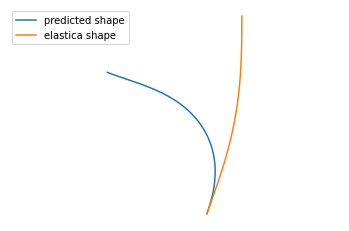

Labels: [2.0, 0.5, 0.985]
preds: [2.061279296875, 0.64599609375, 0.6766181640625]
shape_error: 0.03682444463772, elastica_error: 0.9557349054733911, tangent_error: 0.9928847415563812
--------------------------------------------------------------

0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 19


<Figure size 518.4x691.2 with 0 Axes>

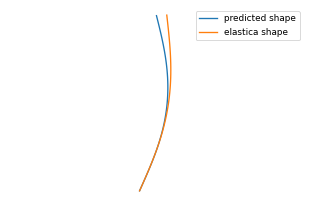

Labels: [2.0, 0.5, 0.965]
preds: [1.9873046875, 0.47900390625, 0.9450322265625]
shape_error: 1.03694945457333e-06, elastica_error: 0.9788325520277024, tangent_error: 7.362028661552743e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 265


<Figure size 518.4x691.2 with 0 Axes>

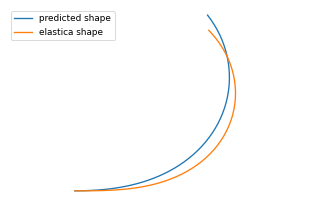

Labels: [1.01, 0.252, 0.095]
preds: [3.76123046875, 1.1259765625, -0.04938476562500005]
shape_error: 5.329900008884189e-08, elastica_error: 0.014650010046641035, tangent_error: 7.01871110582913e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 217


<Figure size 518.4x691.2 with 0 Axes>

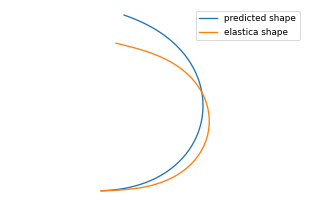

Labels: [2.0, 0.5, 0.135]
preds: [2.79736328125, 0.9091796875, 0.04591650390624996]
shape_error: 1.8604892480028642e-05, elastica_error: 0.6939828912734985, tangent_error: 0.0007664863515880406
--------------------------------------------------------------

0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 247


<Figure size 518.4x691.2 with 0 Axes>

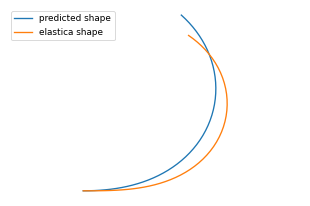

Labels: [1.36, 0.34, 0.07]
preds: [3.4873046875, 1.08984375, 0.00415527343749994]
shape_error: 1.0402461610584322e-06, elastica_error: 0.11611327730814619, tangent_error: 0.0002727042527659102
--------------------------------------------------------------

0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 49


<Figure size 518.4x691.2 with 0 Axes>

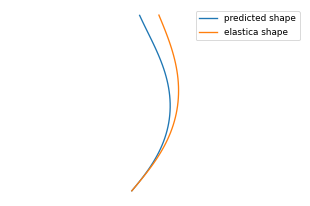

Labels: [2.0, 0.5, 0.855]
preds: [1.873046875, 0.501953125, 0.8365244140625001]
shape_error: 2.223043104864509e-05, elastica_error: 1.0206625907897948, tangent_error: 0.00028767762233605657
--------------------------------------------------------------

0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 31


<Figure size 518.4x691.2 with 0 Axes>

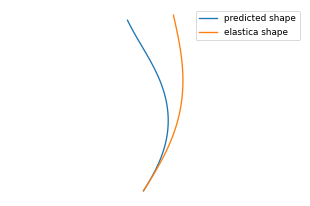

Labels: [2.0, 0.5, 0.925]
preds: [1.769775390625, 0.485107421875, 0.852943359375]
shape_error: 0.0006582561100646938, elastica_error: 1.061186007708311, tangent_error: 0.010344987650411244
--------------------------------------------------------------

0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 229


<Figure size 518.4x691.2 with 0 Axes>

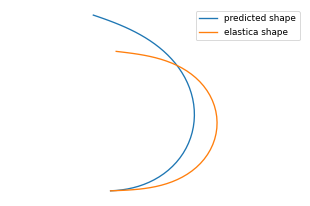

Labels: [2.0, 0.5, 0.075]
preds: [2.68603515625, 0.970703125, 0.005939941406249982]
shape_error: 0.00018666126893860827, elastica_error: 0.7313615171114604, tangent_error: 0.004465086543199502
--------------------------------------------------------------

0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 7


<Figure size 518.4x691.2 with 0 Axes>

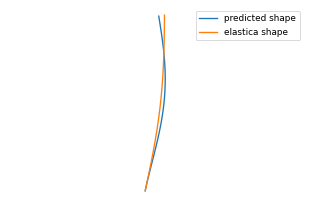

Labels: [2.0, 0.5, 0.995]
preds: [1.659912109375, 0.24658203125, 0.9792978515624999]
shape_error: 9.47729309889866e-08, elastica_error: 1.1202476223389308, tangent_error: 0.00014823201419283803
--------------------------------------------------------------

0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
frame num 187


<Figure size 518.4x691.2 with 0 Axes>

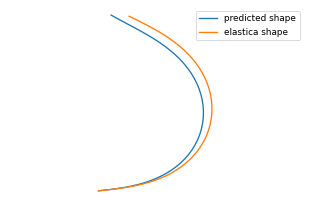

Labels: [2.0, 0.5, 0.275]
preds: [1.89208984375, 0.484619140625, 0.29184375]
shape_error: 5.449280468351504e-06, elastica_error: 1.0334652944902578, tangent_error: 0.00016489702332685198
--------------------------------------------------------------

0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 25


<Figure size 518.4x691.2 with 0 Axes>

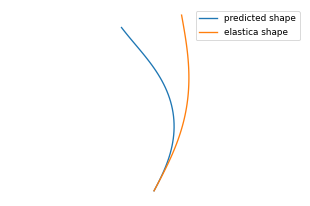

Labels: [2.0, 0.5, 0.945]
preds: [1.83203125, 0.49267578125, 0.827244140625]
shape_error: 0.0017883552634948721, elastica_error: 1.03784529941082, tangent_error: 0.040331182714226047
--------------------------------------------------------------

0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 253


<Figure size 518.4x691.2 with 0 Axes>

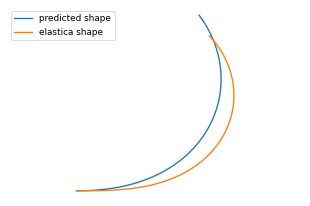

Labels: [1.18, 0.295, 0.07]
preds: [3.7216796875, 1.1630859375, 0.03270996093749995]
shape_error: 5.784879723457945e-07, elastica_error: 0.048816821956634504, tangent_error: 0.00030237298774265034
--------------------------------------------------------------

0: 480x640 1 LDO, 8.9ms
Speed: 1.4ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 235


<Figure size 518.4x691.2 with 0 Axes>

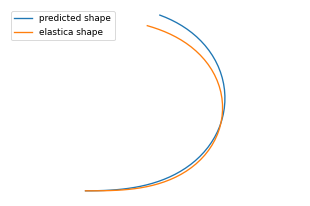

Labels: [1.75, 0.437, 0.07]
preds: [2.72265625, 0.73974609375, 0.00022900390624996936]
shape_error: 3.3630710950469486e-07, elastica_error: 0.5021977760534287, tangent_error: 9.340317180400134e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 10.2ms
Speed: 1.5ms preprocess, 10.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 85


<Figure size 518.4x691.2 with 0 Axes>

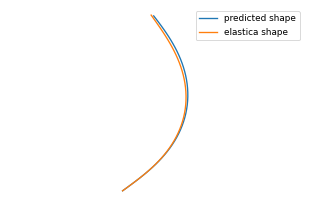

Labels: [2.0, 0.5, 0.71]
preds: [2.0927734375, 0.52294921875, 0.6923232421875001]
shape_error: 1.4335288479970781e-08, elastica_error: 0.939445256304741, tangent_error: 4.5580514332593316e-07
--------------------------------------------------------------

0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 97


<Figure size 518.4x691.2 with 0 Axes>

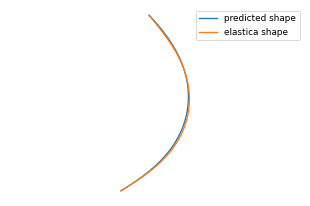

Labels: [2.0, 0.5, 0.66]
preds: [2.2158203125, 0.591796875, 0.6302167968750001]
shape_error: 1.4782419216940458e-09, elastica_error: 0.8915579336802164, tangent_error: 4.7549303207543095e-07
--------------------------------------------------------------

0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 127


<Figure size 518.4x691.2 with 0 Axes>

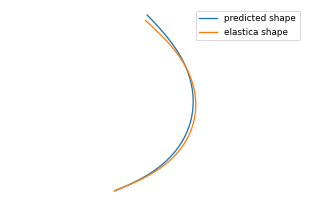

Labels: [2.0, 0.5, 0.535]
preds: [2.13232421875, 0.580078125, 0.554546875]
shape_error: 6.612261303194172e-08, elastica_error: 0.928135873667399, tangent_error: 5.625185871122845e-06
--------------------------------------------------------------

0: 480x640 1 LDO, 8.9ms
Speed: 1.2ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 211


<Figure size 518.4x691.2 with 0 Axes>

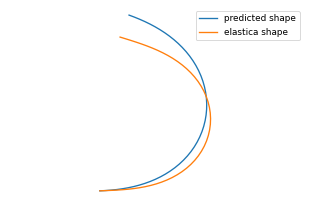

Labels: [2.0, 0.5, 0.165]
preds: [2.640625, 0.8154296875, 0.09374560546874994]
shape_error: 7.94272405272696e-06, elastica_error: 0.748517432721456, tangent_error: 0.0003506794648652436
--------------------------------------------------------------

0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)
frame num 73


<Figure size 518.4x691.2 with 0 Axes>

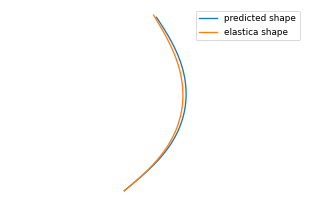

Labels: [2.0, 0.5, 0.76]
preds: [1.9931640625, 0.470458984375, 0.7437216796874999]
shape_error: 7.2476416552466e-08, elastica_error: 0.9785946461379528, tangent_error: 1.2756623578090474e-06
--------------------------------------------------------------

0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 91


<Figure size 518.4x691.2 with 0 Axes>

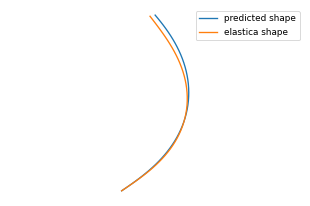

Labels: [2.0, 0.5, 0.685]
preds: [2.3330078125, 0.62548828125, 0.647349609375]
shape_error: 1.0446045677763841e-07, elastica_error: 0.8478718850533168, tangent_error: 7.435031227103539e-06
--------------------------------------------------------------

0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 61


<Figure size 518.4x691.2 with 0 Axes>

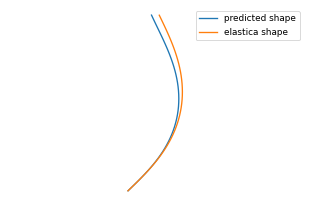

Labels: [2.0, 0.5, 0.81]
preds: [1.857666015625, 0.46240234375, 0.8101113281250001]
shape_error: 6.059638160443533e-07, elastica_error: 1.0298515436569848, tangent_error: 1.2046930778965473e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
frame num 259


<Figure size 518.4x691.2 with 0 Axes>

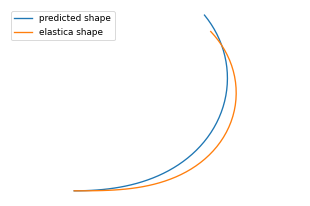

Labels: [1.03, 0.257, 0.07]
preds: [3.81689453125, 1.1484375, -0.08400732421875001]
shape_error: 1.0458813877429249e-07, elastica_error: 0.01491438723373413, tangent_error: 9.62787149048698e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 121


<Figure size 518.4x691.2 with 0 Axes>

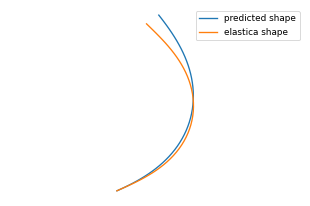

Labels: [2.0, 0.5, 0.56]
preds: [2.320556640625, 0.66650390625, 0.5973789062500001]
shape_error: 2.151597429833741e-06, elastica_error: 0.8570852046728135, tangent_error: 0.00025956118329812706
--------------------------------------------------------------

0: 480x640 1 LDO, 9.1ms
Speed: 1.4ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 103


<Figure size 518.4x691.2 with 0 Axes>

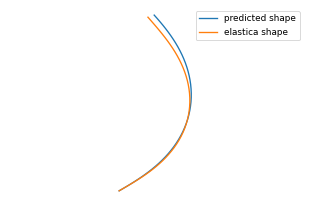

Labels: [2.0, 0.5, 0.635]
preds: [2.260498046875, 0.6025390625, 0.615939453125]
shape_error: 1.6219176844245405e-07, elastica_error: 0.8761325780868531, tangent_error: 1.0267083096548893e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
frame num 181


<Figure size 518.4x691.2 with 0 Axes>

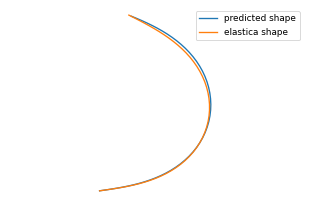

Labels: [2.0, 0.5, 0.3]
preds: [2.140380859375, 0.54931640625, 0.250439453125]
shape_error: 4.674164510218691e-09, elastica_error: 0.9302006381750108, tangent_error: 2.665363360208871e-06
--------------------------------------------------------------

0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 67


<Figure size 518.4x691.2 with 0 Axes>

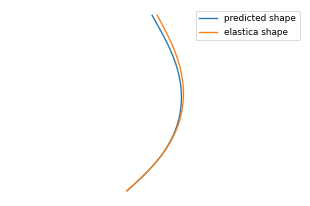

Labels: [2.0, 0.5, 0.785]
preds: [1.9345703125, 0.482666015625, 0.7815566406250001]
shape_error: 7.345448961161138e-08, elastica_error: 0.9997161728560924, tangent_error: 1.5298438472223066e-06
--------------------------------------------------------------

0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 79


<Figure size 518.4x691.2 with 0 Axes>

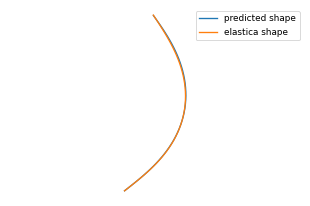

Labels: [2.0, 0.5, 0.735]
preds: [2.103759765625, 0.53564453125, 0.7173085937500001]
shape_error: 4.544798101712962e-11, elastica_error: 0.9342796064138413, tangent_error: 1.9221008049486444e-07
--------------------------------------------------------------

0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 175


<Figure size 518.4x691.2 with 0 Axes>

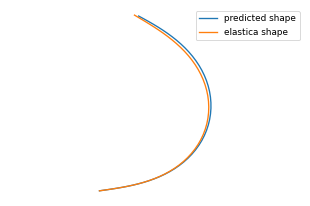

Labels: [2.0, 0.5, 0.33]
preds: [2.07373046875, 0.5205078125, 0.3068349609375]
shape_error: 2.2053626914302203e-08, elastica_error: 0.9572112238883972, tangent_error: 9.548985340279243e-07
--------------------------------------------------------------

0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 223


<Figure size 518.4x691.2 with 0 Axes>

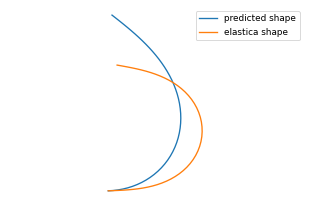

Labels: [2.0, 0.5, 0.105]
preds: [2.9892578125, 1.216796875, 0.01629101562499996]
shape_error: 0.00032540203201576794, elastica_error: 0.6250090282440185, tangent_error: 0.01576616181084894
--------------------------------------------------------------

0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 157


<Figure size 518.4x691.2 with 0 Axes>

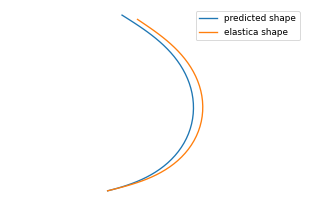

Labels: [2.0, 0.5, 0.405]
preds: [2.1279296875, 0.59716796875, 0.38321875]
shape_error: 6.4110296740756e-06, elastica_error: 0.9301401659727097, tangent_error: 9.874370822982045e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 9.2ms
Speed: 1.2ms preprocess, 9.2ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 151


<Figure size 518.4x691.2 with 0 Axes>

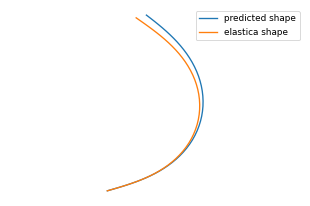

Labels: [2.0, 0.5, 0.43]
preds: [2.07080078125, 0.52099609375, 0.44603906249999997]
shape_error: 5.547646906001467e-07, elastica_error: 0.9576332737684249, tangent_error: 2.0323904234545234e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 163


<Figure size 518.4x691.2 with 0 Axes>

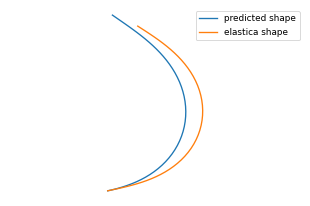

Labels: [2.0, 0.5, 0.38]
preds: [2.22021484375, 0.69091796875, 0.35751953124999997]
shape_error: 6.999949999997218e-05, elastica_error: 0.8927286879301071, tangent_error: 0.0011821302264209954
--------------------------------------------------------------

0: 480x640 1 LDO, 8.7ms
Speed: 1.1ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 139


<Figure size 518.4x691.2 with 0 Axes>

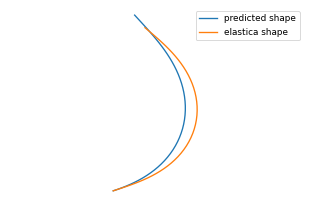

Labels: [2.0, 0.5, 0.485]
preds: [2.206298828125, 0.68017578125, 0.5124287109374999]
shape_error: 1.4626070599710648e-05, elastica_error: 0.8983667747894923, tangent_error: 0.00029343022492857486
--------------------------------------------------------------

0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
frame num 115


<Figure size 518.4x691.2 with 0 Axes>

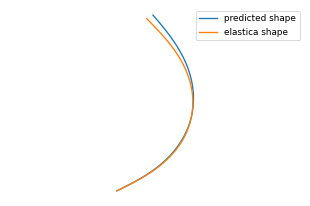

Labels: [2.0, 0.5, 0.585]
preds: [2.09130859375, 0.544921875, 0.607373046875]
shape_error: 1.1356033120668229e-07, elastica_error: 0.9436748827616374, tangent_error: 1.022547787832129e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
frame num 109


<Figure size 518.4x691.2 with 0 Axes>

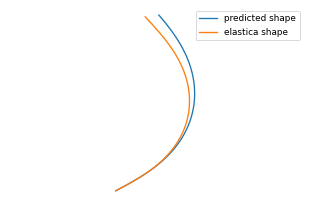

Labels: [2.0, 0.5, 0.61]
preds: [2.165283203125, 0.54833984375, 0.615939453125]
shape_error: 2.809794775368268e-06, elastica_error: 0.9150263254563015, tangent_error: 7.936355368927297e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 43


<Figure size 518.4x691.2 with 0 Axes>

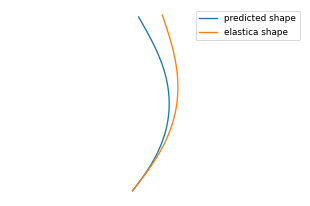

Labels: [2.0, 0.5, 0.88]
preds: [2.083984375, 0.57568359375, 0.8279580078125]
shape_error: 3.6906941542502854e-05, elastica_error: 0.9373477474927903, tangent_error: 0.0006727794738577465
--------------------------------------------------------------

0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 241


<Figure size 518.4x691.2 with 0 Axes>

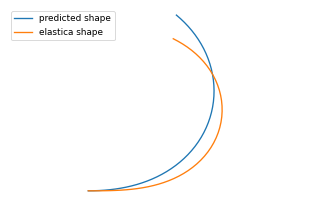

Labels: [1.54, 0.385, 0.07]
preds: [3.5576171875, 1.150390625, -0.018688476562500056]
shape_error: 1.6856493407915824e-06, elastica_error: 0.1788275215148926, tangent_error: 0.0006151967910814817
--------------------------------------------------------------

0: 480x640 1 LDO, 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 199


<Figure size 518.4x691.2 with 0 Axes>

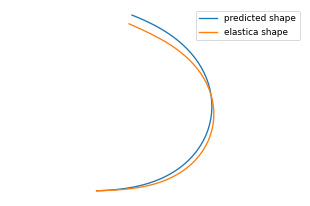

Labels: [2.0, 0.5, 0.225]
preds: [2.31982421875, 0.6484375, 0.17476953125]
shape_error: 2.9615362584425937e-07, elastica_error: 0.8640942923227946, tangent_error: 1.0751297267082541e-05
--------------------------------------------------------------

0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 55


<Figure size 518.4x691.2 with 0 Axes>

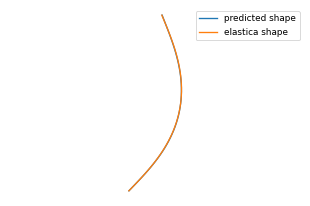

Labels: [2.0, 0.5, 0.835]
preds: [1.930908203125, 0.474609375, 0.8415214843750001]
shape_error: 4.531048910001062e-13, elastica_error: 1.0012355404218038, tangent_error: 2.173755833933882e-08
--------------------------------------------------------------

0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 169


<Figure size 518.4x691.2 with 0 Axes>

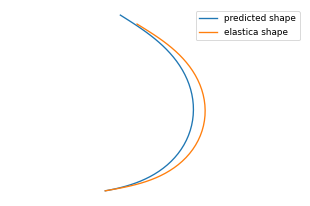

Labels: [2.0, 0.5, 0.355]
preds: [2.190185546875, 0.64208984375, 0.3396728515625]
shape_error: 1.395323874786941e-05, elastica_error: 0.9077015824397404, tangent_error: 0.00024120515386007283
--------------------------------------------------------------

0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 37


<Figure size 518.4x691.2 with 0 Axes>

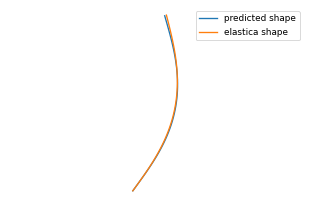

Labels: [2.0, 0.5, 0.905]
preds: [1.926513671875, 0.458251953125, 0.8986308593750001]
shape_error: 7.166081713833543e-10, elastica_error: 1.0030832047641278, tangent_error: 2.7161913129385793e-07
--------------------------------------------------------------

0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 205


<Figure size 518.4x691.2 with 0 Axes>

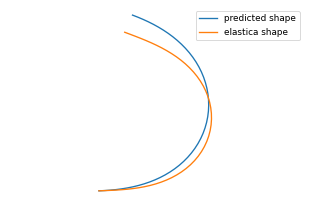

Labels: [2.0, 0.5, 0.195]
preds: [2.587890625, 0.77978515625, 0.11159228515624992]
shape_error: 3.598419474503792e-06, elastica_error: 0.7649887166102727, tangent_error: 0.00015551349891978236
--------------------------------------------------------------

0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 145


<Figure size 518.4x691.2 with 0 Axes>

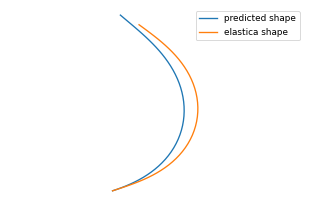

Labels: [2.0, 0.5, 0.455]
preds: [2.15576171875, 0.65234375, 0.46031640625]
shape_error: 3.110316145759481e-05, elastica_error: 0.9172808508555095, tangent_error: 0.0005042059958423647
--------------------------------------------------------------

0: 480x640 1 LDO, 9.1ms
Speed: 1.4ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 133


<Figure size 518.4x691.2 with 0 Axes>

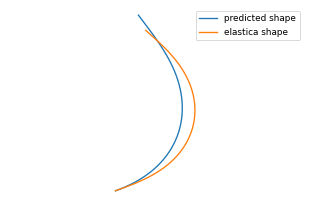

Labels: [2.0, 0.5, 0.51]
preds: [2.25244140625, 0.72802734375, 0.5538330078125]
shape_error: 1.8787105295662544e-05, elastica_error: 0.8798825703382492, tangent_error: 0.0005647871772264397
--------------------------------------------------------------

0: 480x640 1 LDO, 10.3ms
Speed: 1.1ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 193


<Figure size 518.4x691.2 with 0 Axes>

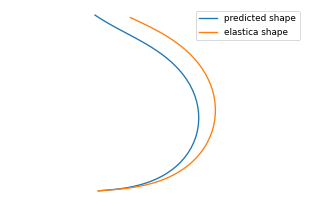

Labels: [2.0, 0.5, 0.25]
preds: [1.797607421875, 0.470458984375, 0.27328320312499993]
shape_error: 8.189536363518446e-05, elastica_error: 1.0724672488868237, tangent_error: 0.002648254230677866
--------------------------------------------------------------


<Figure size 384x256 with 0 Axes>

In [8]:
sim_dat_path = '/home/itay/pythonProject/Meatrain/path_to_test_sim/test4/'

start_time = time.time()
fig, ax = plt.subplots()
x =[]
y= []
df = pd.DataFrame({'frame':[],'x_shape':[],'y_shape':[],'x_sorce':[],'y_sorce':[],'shape_error':[],'elastica_error':[], 'tangent_error':[]})
for inx,filename in enumerate(glob.glob(sim_dat_path+'*.jpg')): #assuming jpg

    inx, labels, base_frame = control_utils.get_label_inx(Path(filename))
    # inx, labels, base_frame = get_label_sim(Path(filename))

    L,l = base_frame[3], base_frame[4]
    base_frame = base_frame[:3]
    im=cv.imread(str(filename), cv.IMREAD_UNCHANGED)
    croped_image = control_utils.crop_model(im,yolo_model)
    im = cv.imread(str(buf_path), cv.IMREAD_UNCHANGED)
    angle = -round(np.rad2deg(base_frame[2]))
    
    im=control_utils.rotate_image(im,angle)
    image_height, image_width = im.shape[0:2]
    img = control_utils.crop_around_center(
            im,
            *control_utils.largest_rotated_rect(
                image_width*1,
                image_height*1,
                math.radians(angle)
            )
        )
    
    print(f"frame num {inx}")
    pred = control_utils.pipeline(img, model)
    [shape_error, elastica_error, tangent_error] = control_utils.MSE_model_error_test(labels,pred,L-l, base_frame)
    L_gal2, S02, mu2 = control_utils.unormlized(L_gal=pred[0], S0=pred[1], mu=pred[2])
    print("Labels:", labels)
    print("preds:", [L_gal2, S02, mu2])
    x, y, phi = control_utils.get_shape_hf(base_frame[0],base_frame[1],base_frame[2], L_gal=L_gal2, s0=S02, mu=mu2, s=np.linspace(start=0, stop=1,num=100))
    x_sorc, y_sorc, phi_sorc = control_utils.get_shape_hf(base_frame[0],base_frame[1],base_frame[2], L_gal=labels[0], s0=labels[1], mu=labels[2], s=np.linspace(start=0, stop=L-l,num=100))
    new_row = {'frame':int(inx),'x_shape':x*(L-l),'y_shape':y*(L-l), 'x_sorce':x_sorc,'y_sorce':y_sorc,'shape_error':shape_error,'elastica_error':elastica_error, 'tangent_error':tangent_error}
    df = df._append(new_row, ignore_index=True)
    print(f"shape_error: {shape_error}, elastica_error: {elastica_error}, tangent_error: {tangent_error}")
    print("--------------------------------------------------------------")
df.sort_values("frame",ascending=True, inplace=True)
df.reset_index(drop=True, inplace=True)
end_time = time.time()
total_time = end_time-start_time

### Figure Display

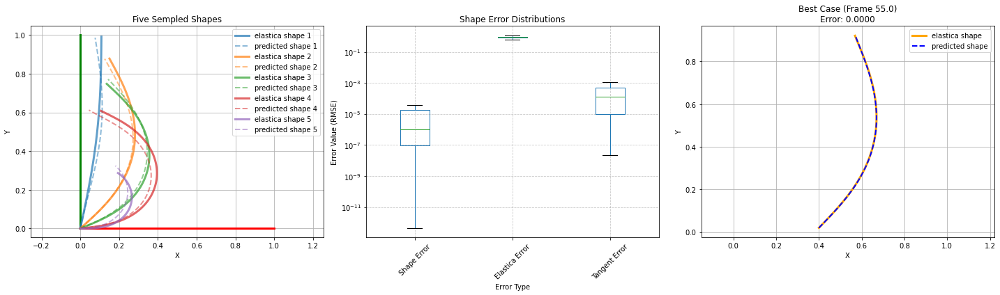


Best 5 Cases Statistics:
    frame   shape_error  elastica_error  tangent_error
0     7.0  9.477293e-08        1.120248       0.000148
10   67.0  7.345449e-08        0.999716       0.000002
20  127.0  6.612261e-08        0.928136       0.000006
30  187.0  5.449280e-06        1.033465       0.000165
40  247.0  1.040246e-06        0.116113       0.000273


In [10]:
# Create a figure with 3 subplots
plt.figure(figsize=(20, 6), facecolor='white')

# 1. Best 5 Trajectories
plt.subplot(131)
# best_5_idx = df.shape_error.nsmallest(5).index
sampled_idx = df.index[::10]
colors = sns.color_palette('tab10', n_colors=len(sampled_idx))
x_target=np.linspace(0,L,100)
y_target=np.zeros(100)
plt.plot(x_target,y_target,'-r',linewidth = 3)
x_start=np.zeros(100)
y_satrt=np.linspace(0,L,100)
plt.plot(x_start,y_satrt,'-g',linewidth = 3)
for i,idx in enumerate(sampled_idx):
    x, y = df.iloc[idx].x_shape, df.iloc[idx].y_shape
    x_src, y_src = df.iloc[idx].x_sorce, df.iloc[idx].y_sorce
    plt.plot(x_src-x_src[0], y_src-y_src[0], '-', alpha=0.7, linewidth=3, 
             label=f'elastica shape {i+1}', color=colors[i])
    plt.plot((x-x[0]), (y-y[0]), '--', alpha=0.5, linewidth=2, 
             label=f'predicted shape {i+1}', color=colors[i])
plt.title('Five Sempled Shapes')
plt.xlabel('X')
plt.ylabel('Y')
plt.axis('equal')
plt.grid(True)
plt.legend(loc='upper right') 

# 2. Error Distribution
plt.subplot(132)
errors = pd.DataFrame({
    'Shape Error': df.shape_error,
    'Elastica Error': df.elastica_error,
    'Tangent Error': df.tangent_error
})
errors.boxplot(showfliers=False)
# Customize the plot
plt.title('Shape Error Distributions')
plt.xlabel('Error Type')
plt.ylabel('Error Value (RMSE)')
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(rotation=45)
plt.yscale('log')


# 3. Best Case Analysis
plt.subplot(133)
best_idx = df.shape_error.argmin()
plt.plot(df.iloc[best_idx].x_sorce, df.iloc[best_idx].y_sorce, 
         '-',color='orange', linewidth=3, label='elastica shape')
plt.plot(df.iloc[best_idx].x_shape, df.iloc[best_idx].y_shape, 
         'b--', linewidth=2, label='predicted shape')
plt.title(f'Best Case (Frame {df.iloc[best_idx].frame})\nError: {df.iloc[best_idx].shape_error:.4f}')
plt.xlabel('X')
plt.ylabel('Y')
plt.axis('equal')
plt.grid(True)
plt.legend()

plt.tight_layout()
plt.show()

# Print statistics for the 5 best cases
print("\nBest 5 Cases Statistics:")
print(df.iloc[sampled_idx][['frame', 'shape_error', 'elastica_error', 'tangent_error']].to_string())


### Compute the simulation of 22 trajectorys


0: 480x640 1 LDO, 10.8ms
Speed: 17.6ms preprocess, 10.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

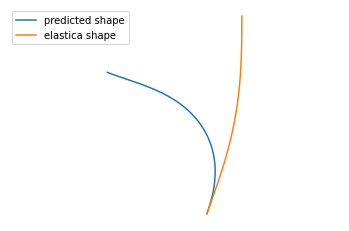


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

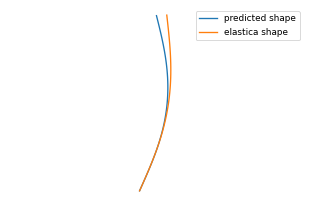


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

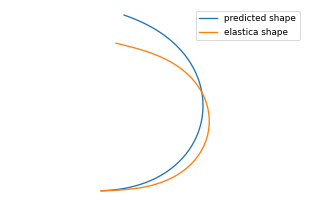


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

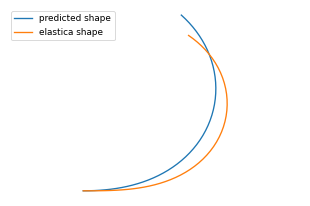


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

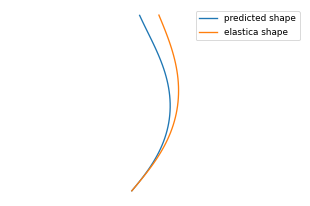


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

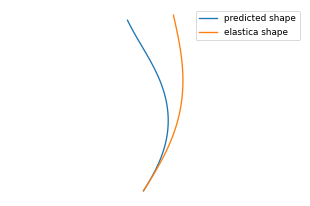


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

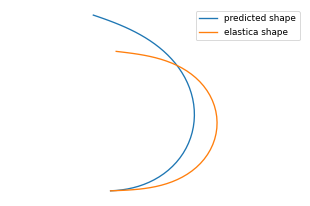


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

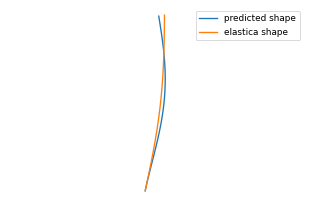


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

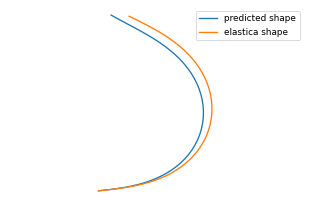


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

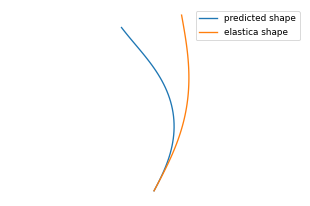


0: 480x640 1 LDO, 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

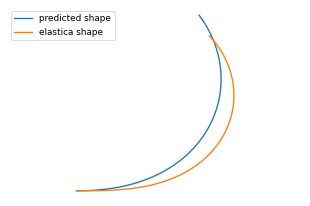


0: 480x640 1 LDO, 9.3ms
Speed: 1.4ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

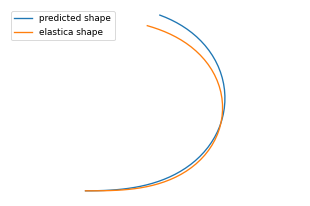


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

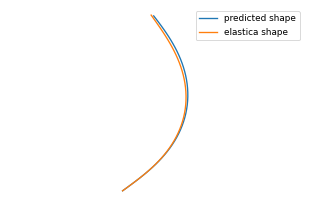


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

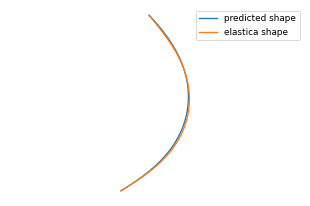


0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

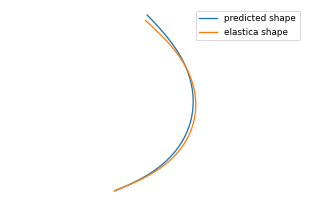


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

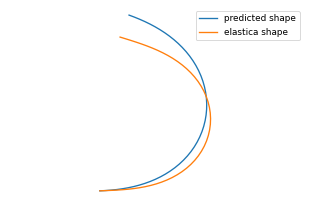


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

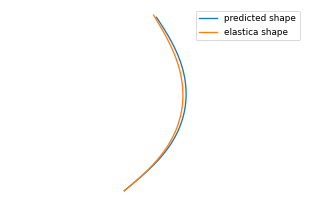


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

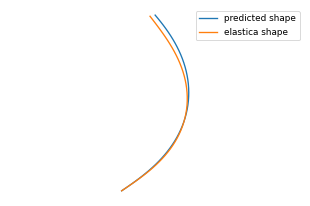


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

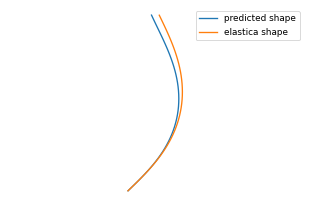


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

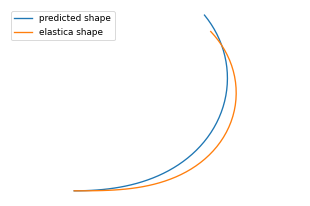


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

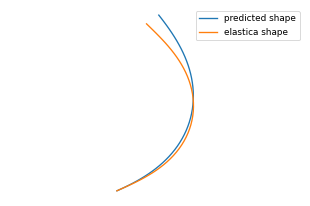


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

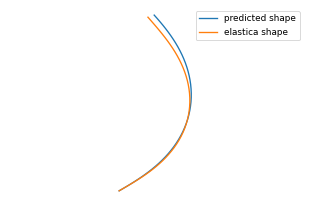


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

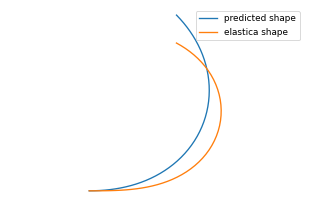


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

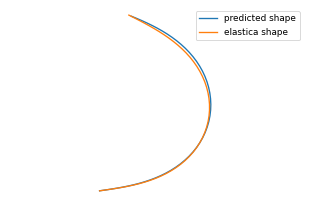


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

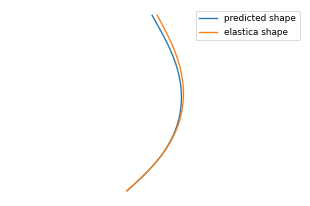


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

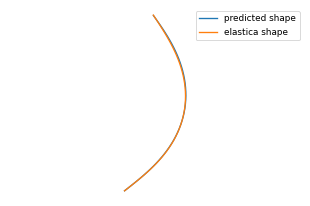


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

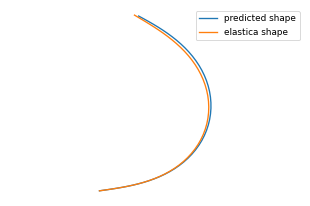


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

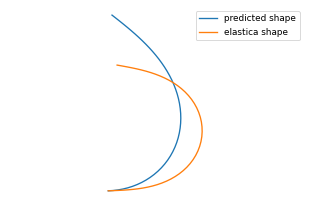


0: 480x640 1 LDO, 10.4ms
Speed: 1.0ms preprocess, 10.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

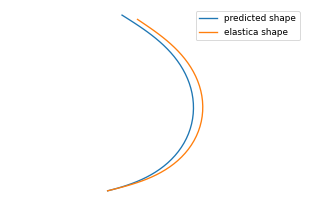


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

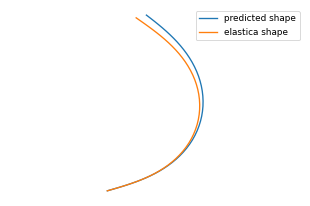


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

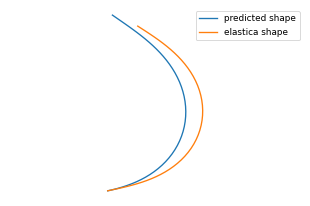


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

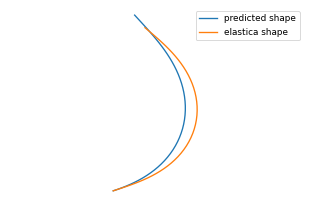


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

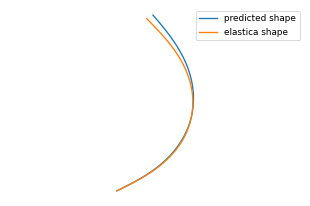


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

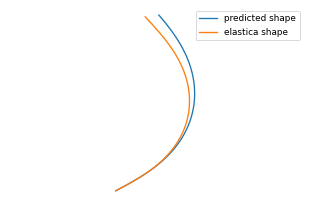


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

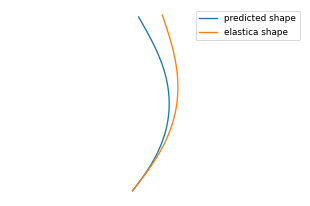


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

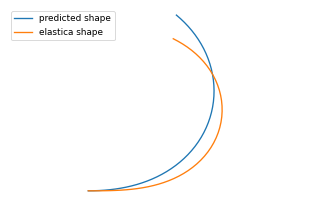


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

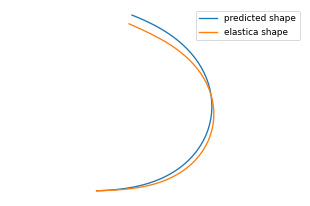


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

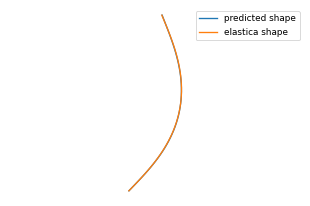


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

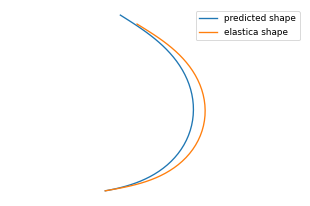


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

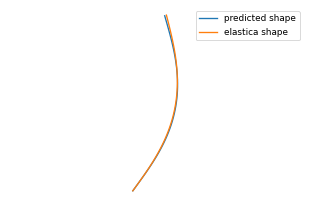


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

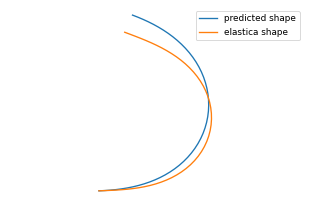


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

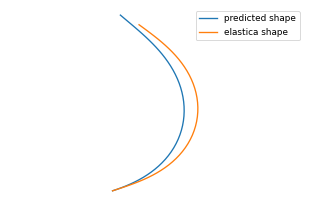


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

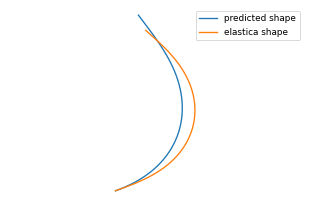


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

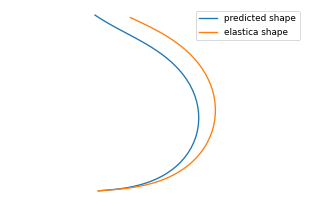

total time: 13.690890073776245


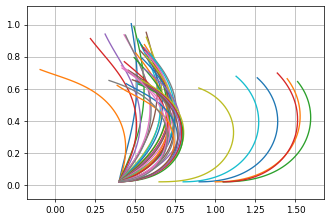


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

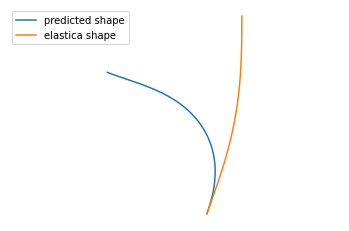


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

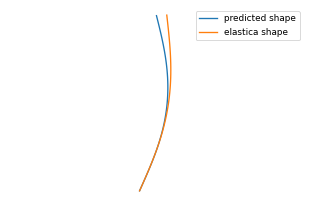


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

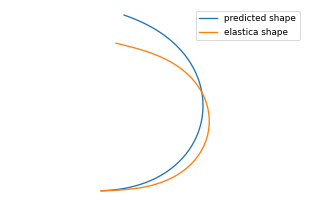


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

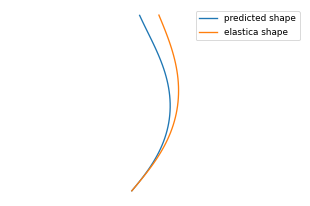


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

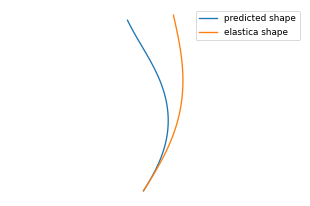


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

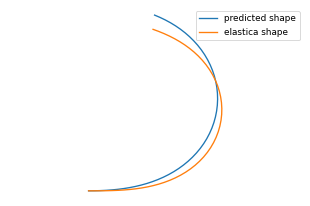


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

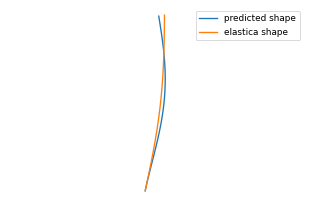


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

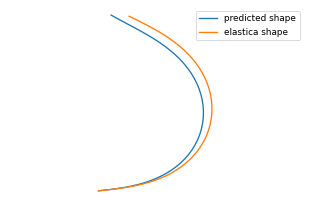


0: 480x640 1 LDO, 9.2ms
Speed: 1.2ms preprocess, 9.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

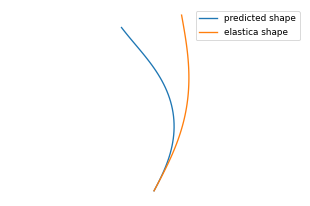


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

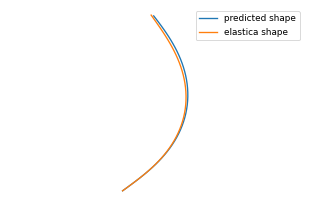


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

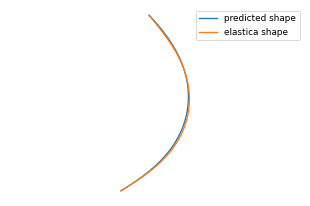


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

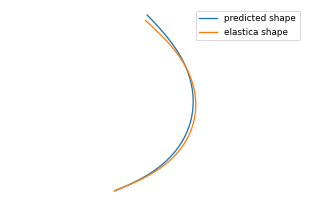


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

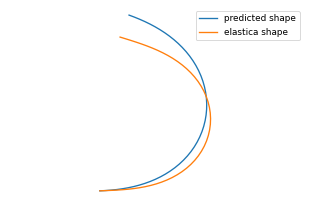


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

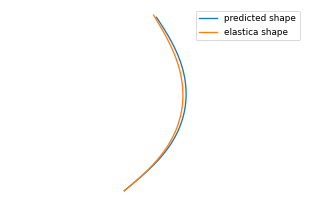


0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

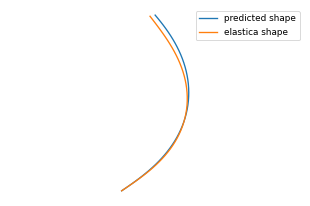


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

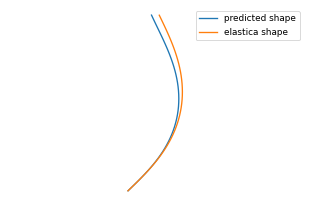


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

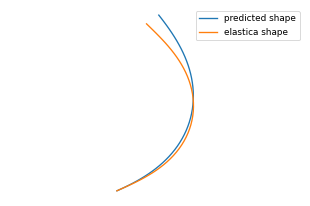


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

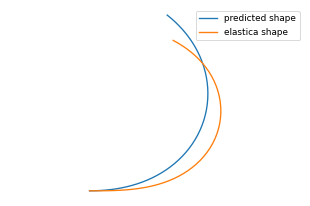


0: 480x640 1 LDO, 8.8ms
Speed: 1.2ms preprocess, 8.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

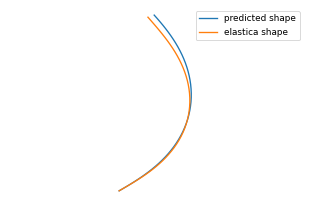


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

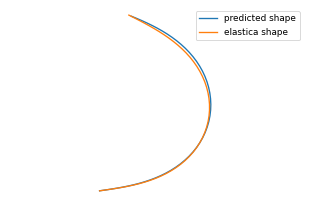


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

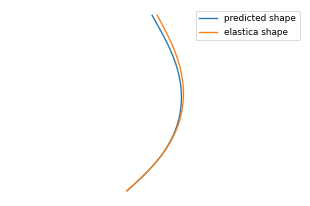


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

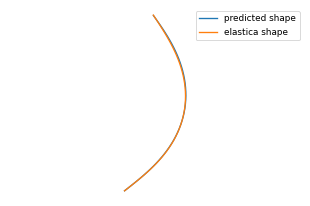


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

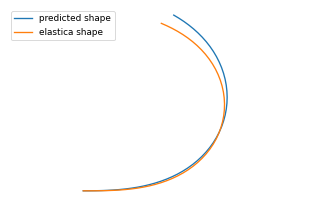


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

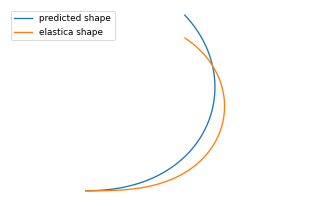


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

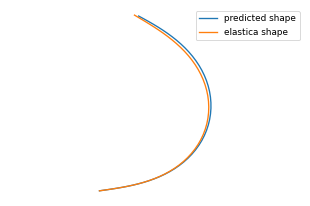


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

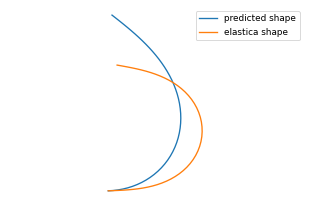


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

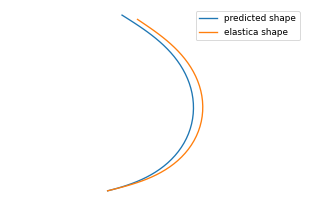


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

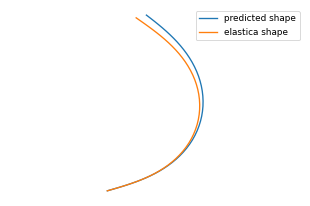


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

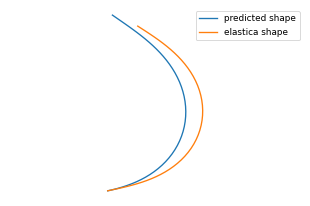


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

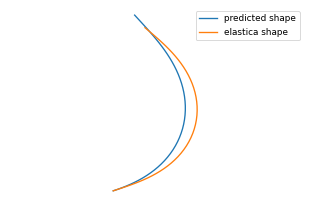


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

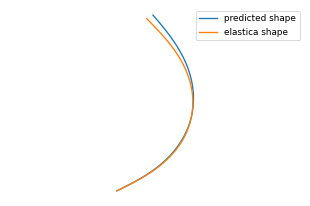


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

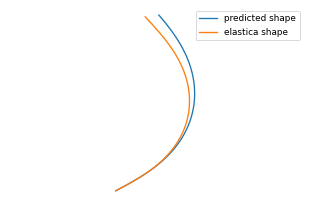


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

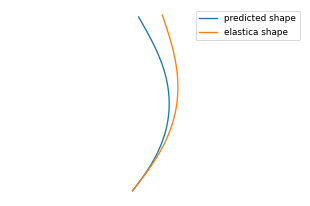


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

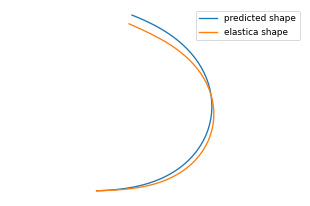


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

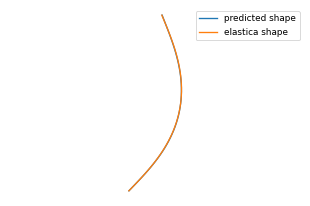


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

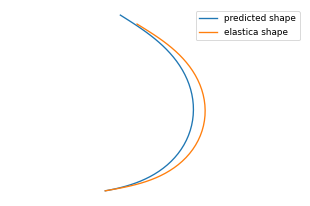


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

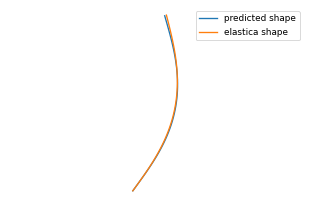


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

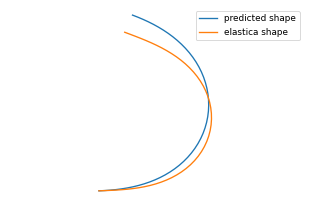


0: 480x640 1 LDO, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

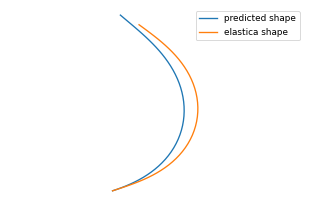


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

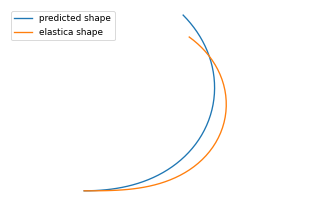


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

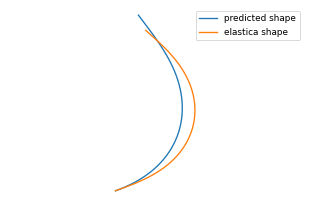


0: 480x640 1 LDO, 10.4ms
Speed: 1.2ms preprocess, 10.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

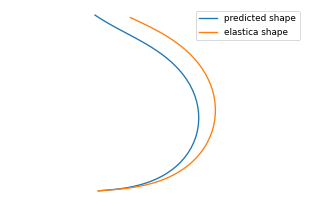

total time: 26.885061502456665


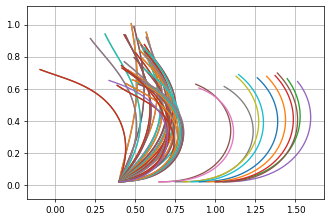


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

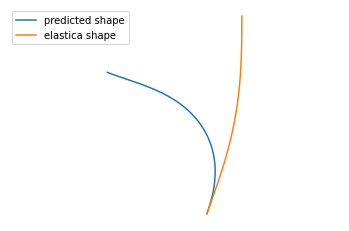


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

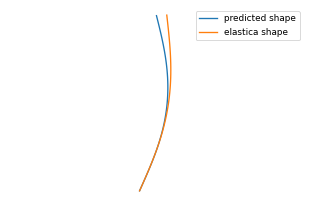


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

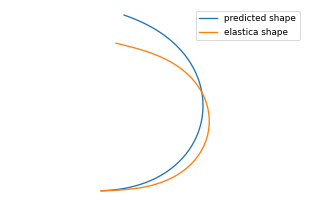


0: 480x640 (no detections), 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

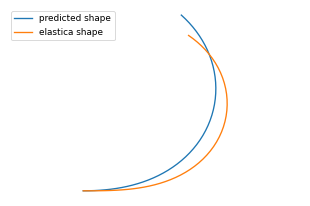


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

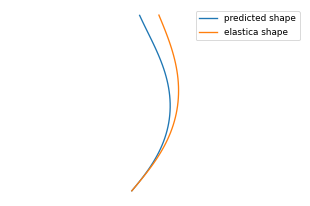


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

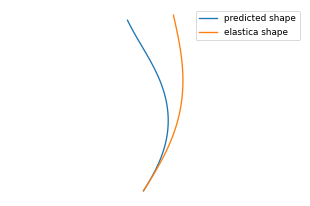


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

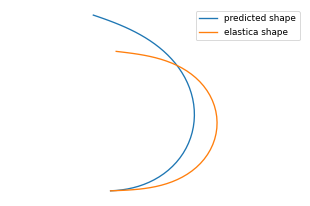


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

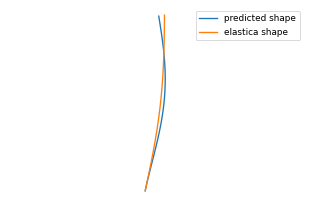


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

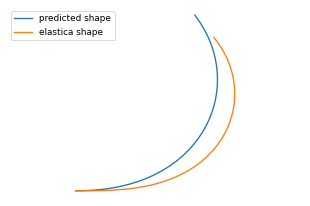


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

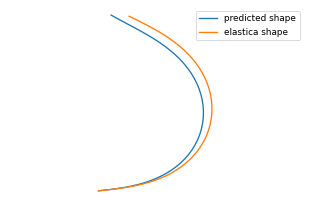


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

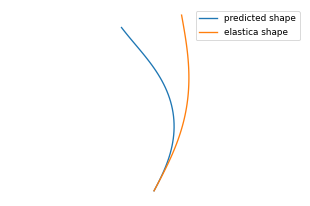


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

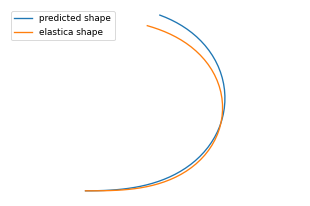


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

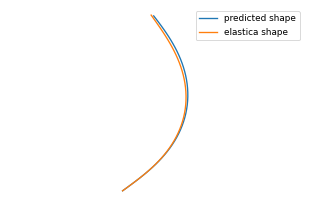


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

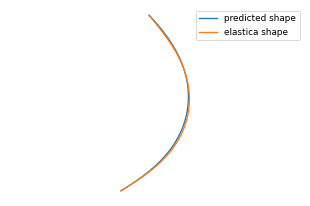


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

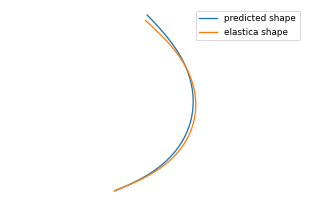


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

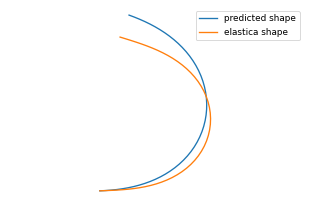


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

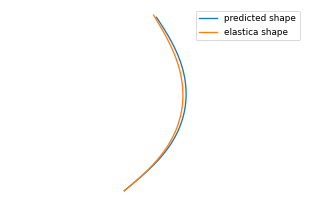


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

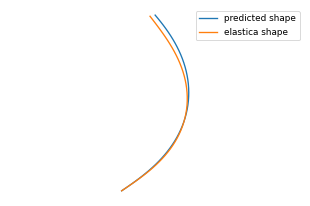


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

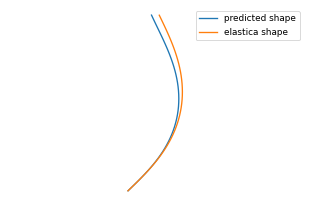


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

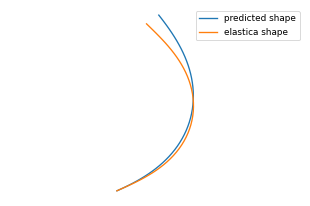


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

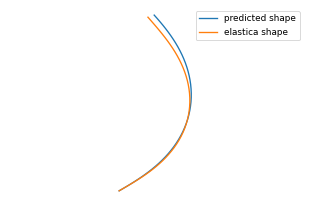


0: 480x640 1 LDO, 10.0ms
Speed: 1.4ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

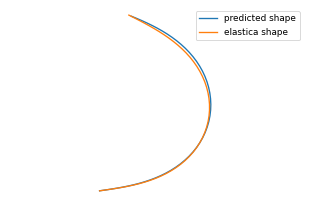


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

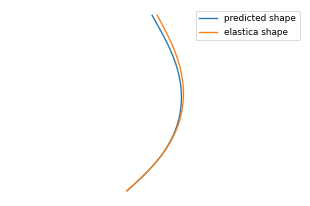


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

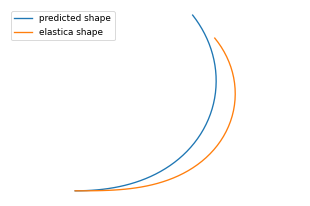


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

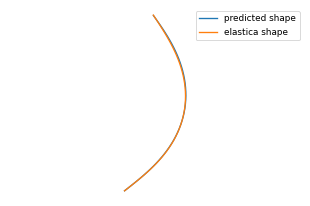


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

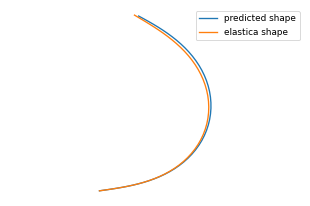


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

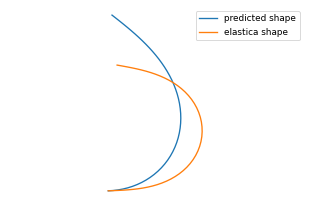


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

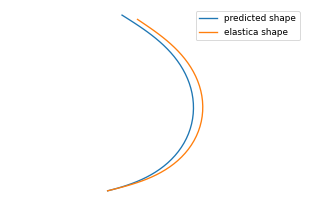


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

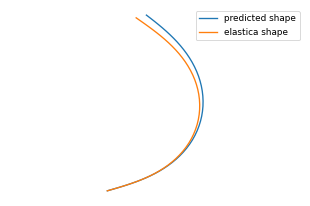


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

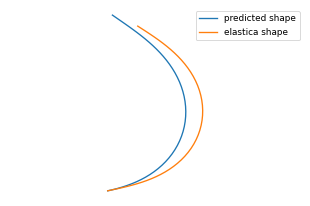


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

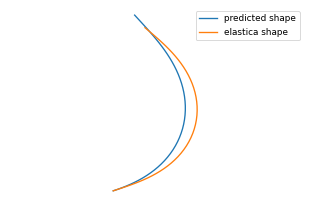


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

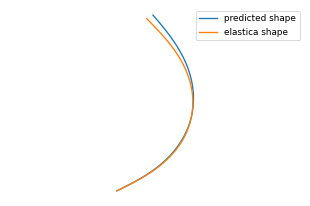


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

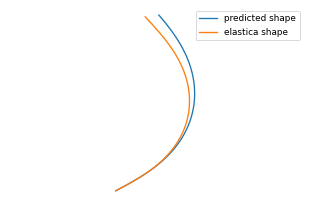


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

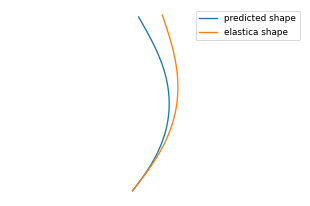


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

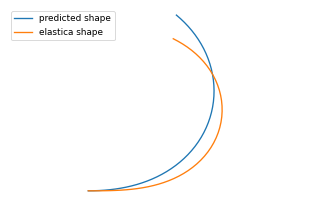


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

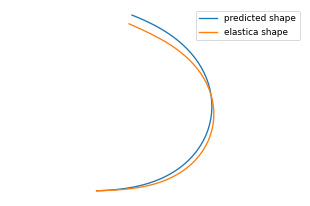


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

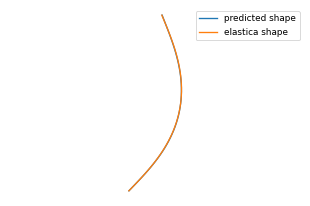


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

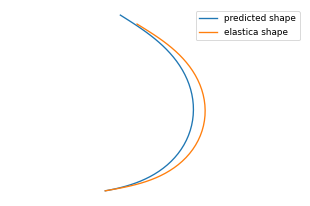


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

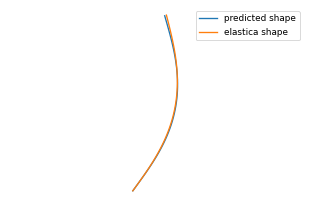


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

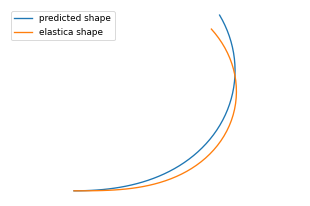


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

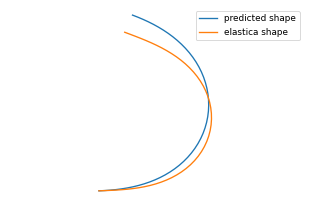


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

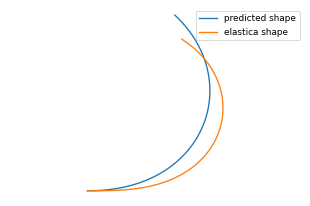


0: 480x640 1 LDO, 8.7ms
Speed: 1.1ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

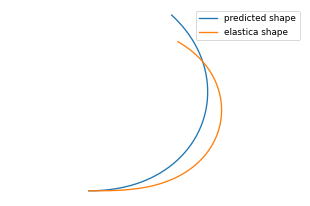


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

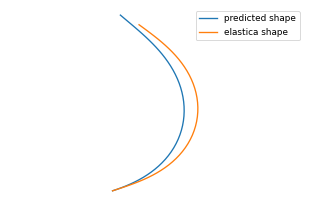


0: 480x640 1 LDO, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

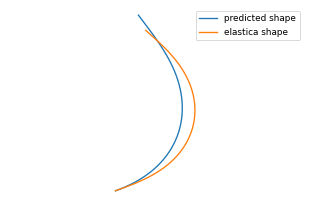


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

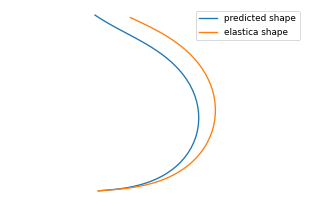

total time: 41.80755829811096


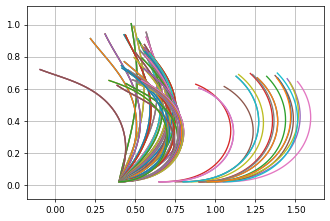


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

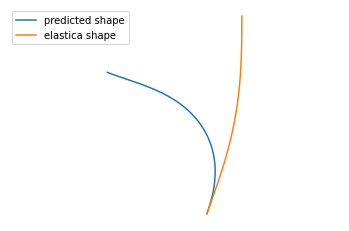


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

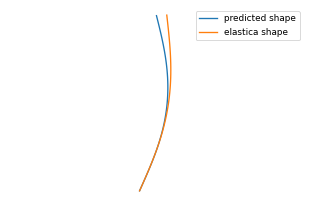


0: 480x640 1 LDO, 10.2ms
Speed: 1.9ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

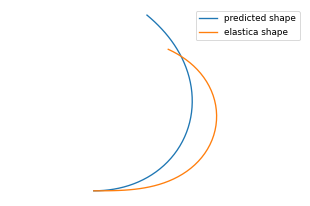


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

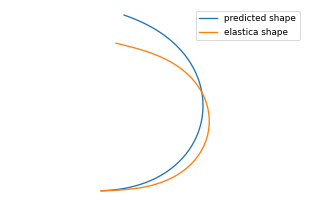


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

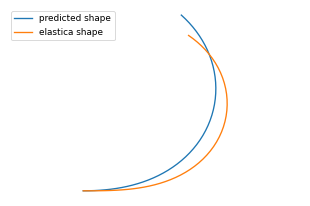


0: 480x640 1 LDO, 9.2ms
Speed: 1.3ms preprocess, 9.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

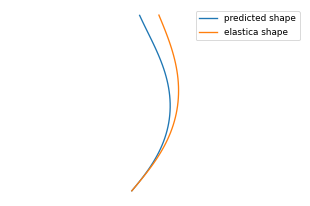


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

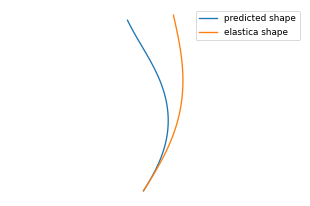


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

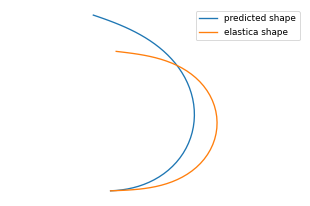


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

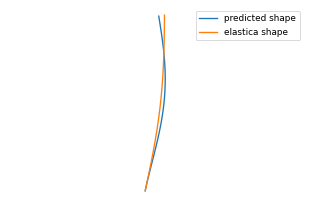


0: 480x640 1 LDO, 8.7ms
Speed: 1.1ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

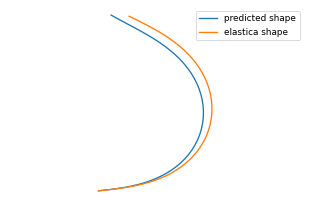


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

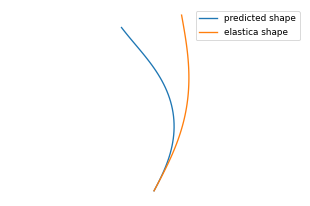


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

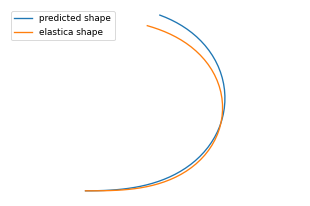


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

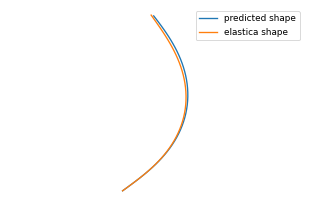


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

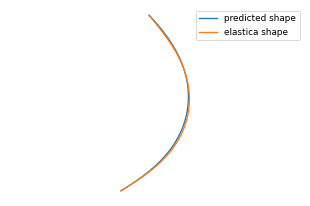


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

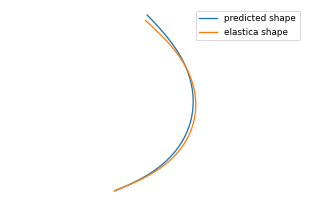


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

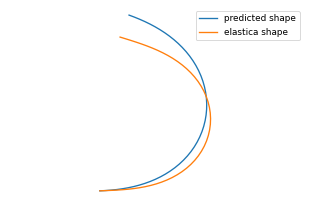


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

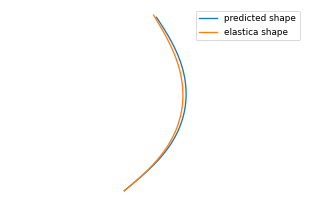


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

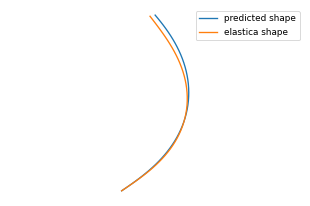


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

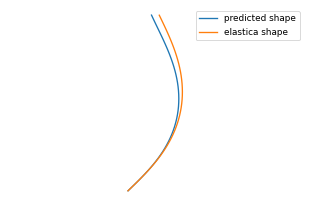


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

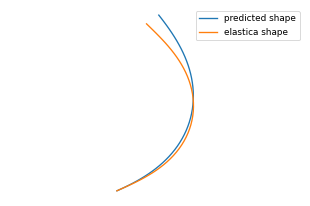


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

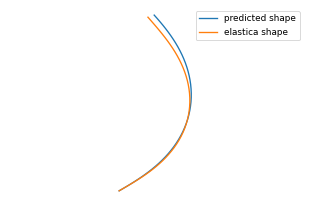


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

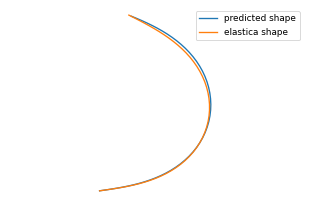


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

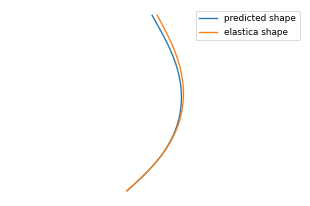


0: 480x640 1 LDO, 8.7ms
Speed: 1.0ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

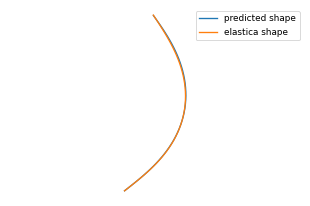


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

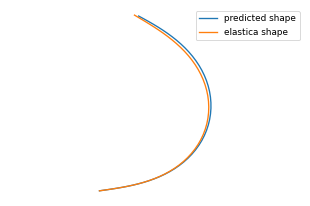


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

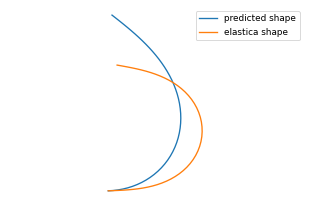


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

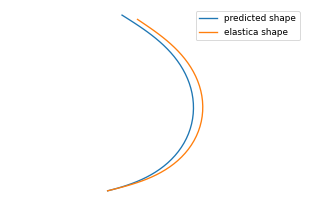


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

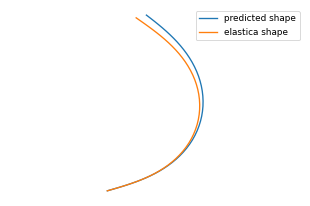


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

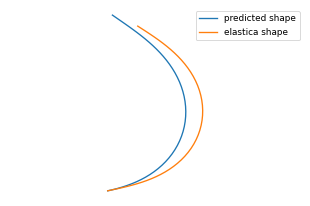


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

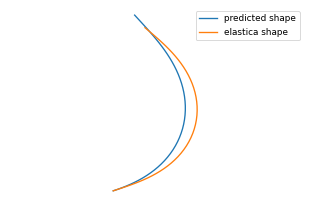


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

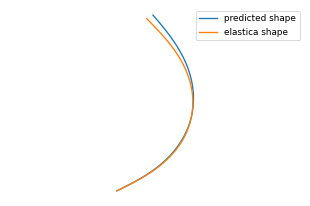


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

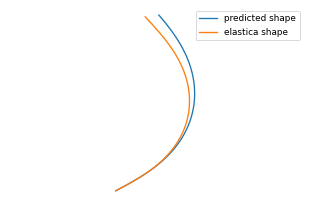


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

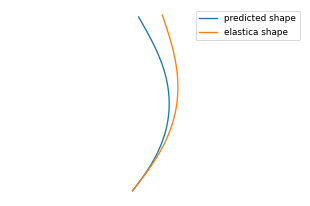


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

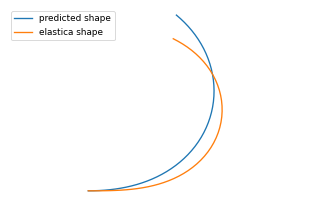


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

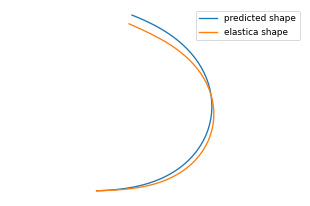


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

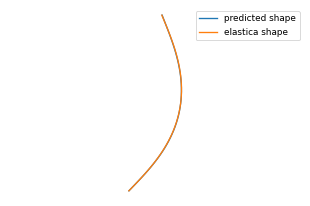


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

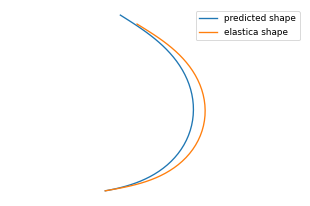


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

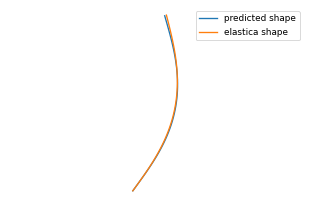


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

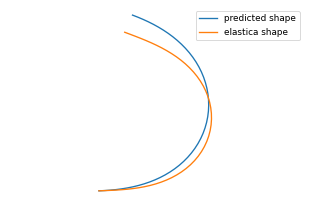


0: 480x640 1 LDO, 8.7ms
Speed: 1.3ms preprocess, 8.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

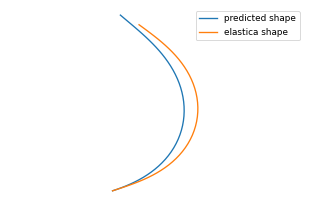


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

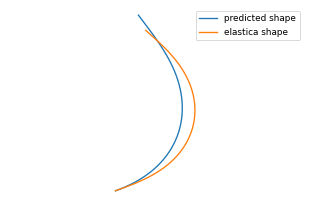


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

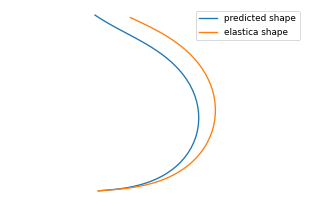

total time: 55.090232610702515


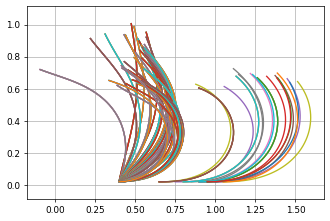


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

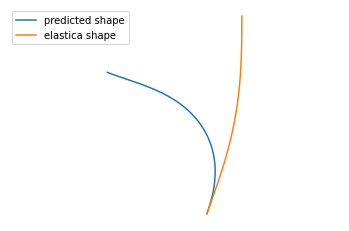


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

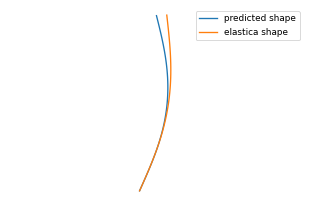


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

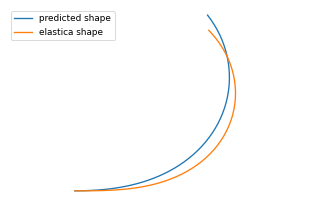


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

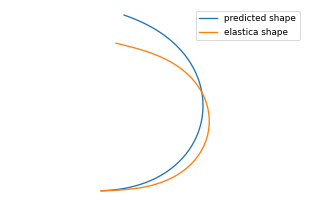


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

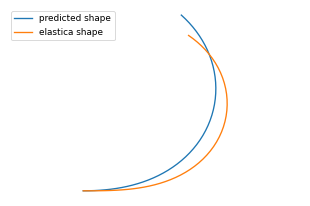


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

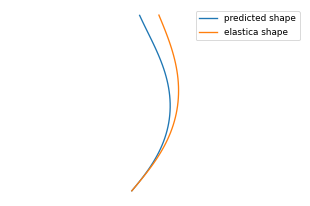


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

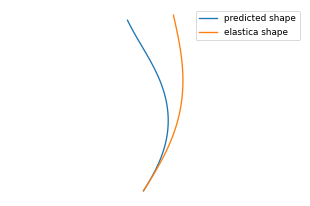


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

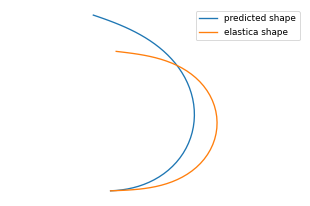


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

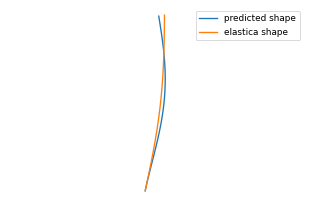


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

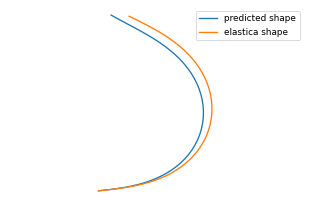


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

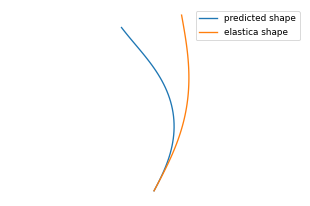


0: 480x640 1 LDO, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

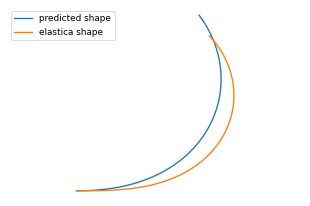


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

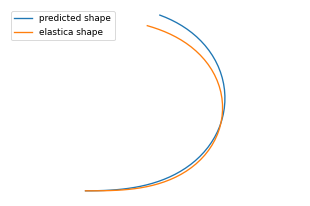


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

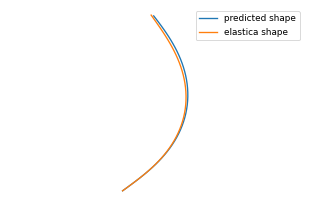


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

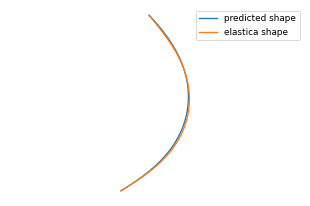


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

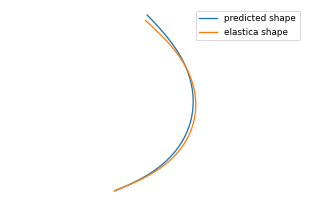


0: 480x640 1 LDO, 9.7ms
Speed: 1.6ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

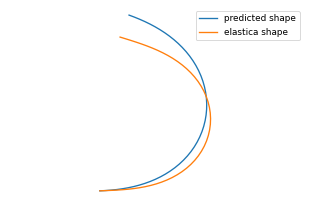


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

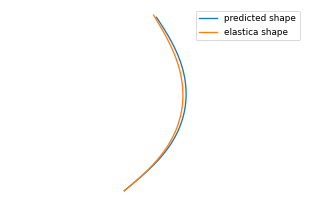


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

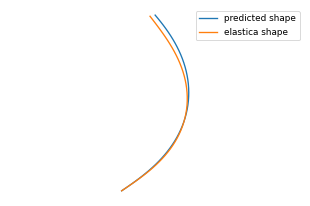


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

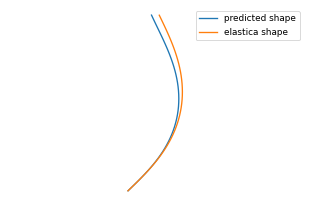


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

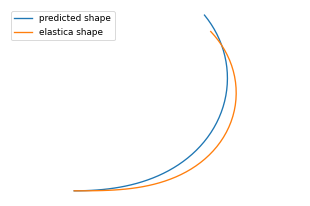


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

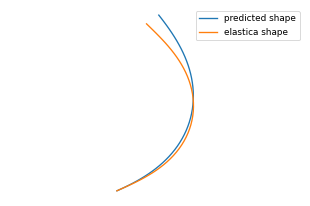


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

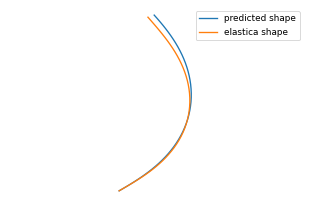


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

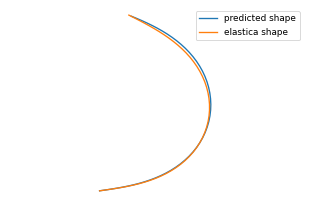


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

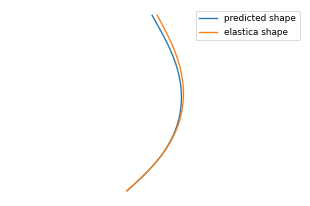


0: 480x640 1 LDO, 9.5ms
Speed: 1.7ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

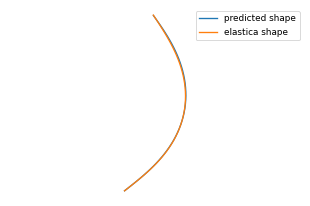


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

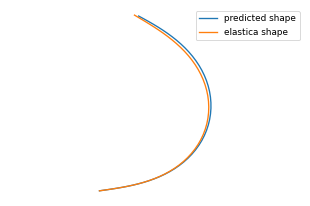


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

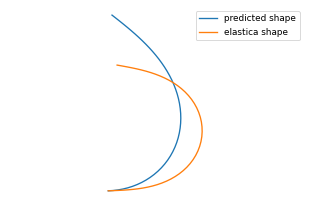


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

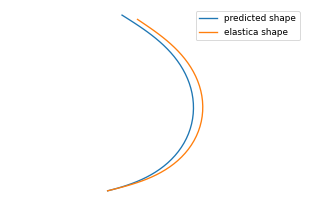


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

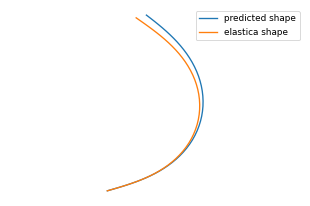


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

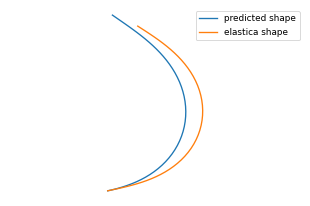


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

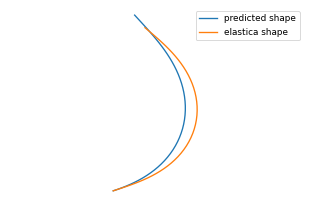


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

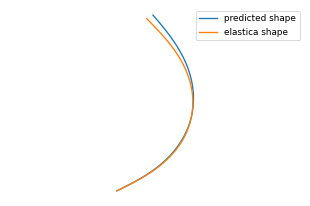


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

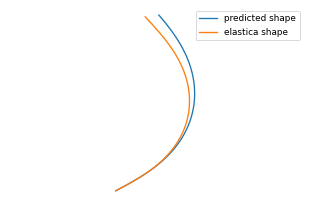


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

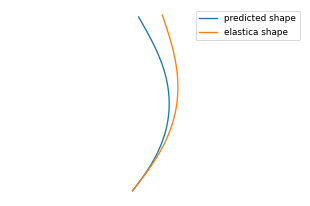


0: 480x640 1 LDO, 9.5ms
Speed: 1.5ms preprocess, 9.5ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

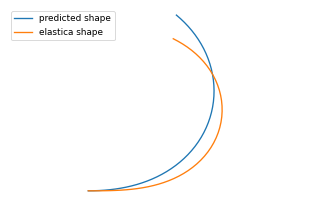


0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

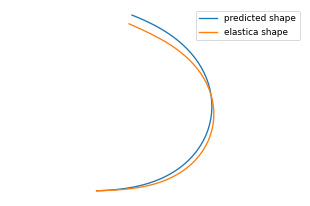


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

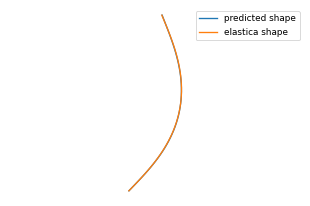


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

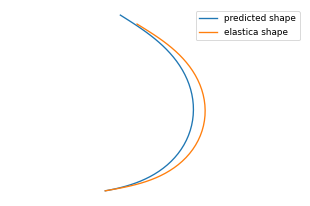


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

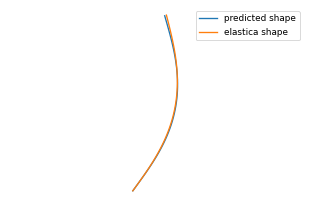


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

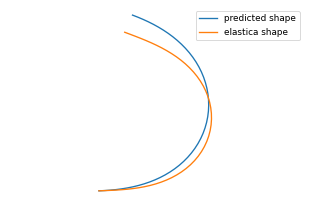


0: 480x640 1 LDO, 8.7ms
Speed: 1.0ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

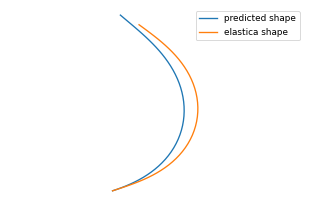


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

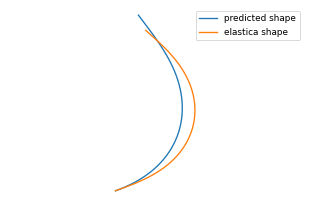


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

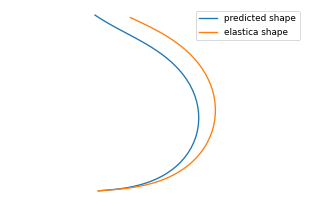

total time: 69.44677019119263


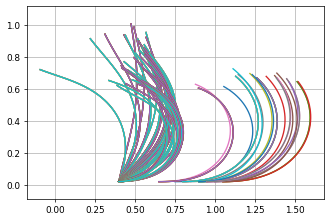


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

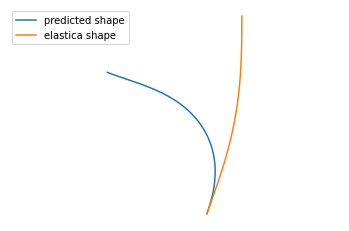


0: 480x640 1 LDO, 9.8ms
Speed: 1.2ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

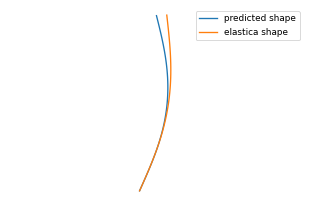


0: 480x640 1 LDO, 9.3ms
Speed: 1.5ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

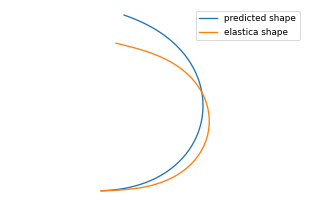


0: 480x640 1 LDO, 9.3ms
Speed: 1.6ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

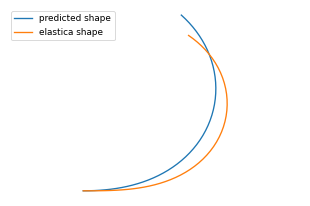


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

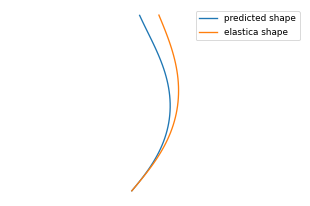


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

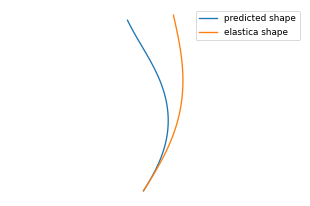


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

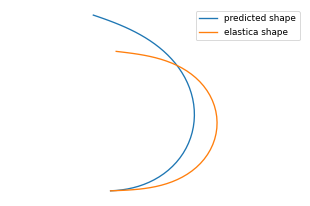


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

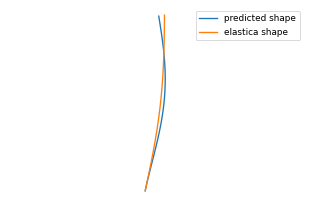


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

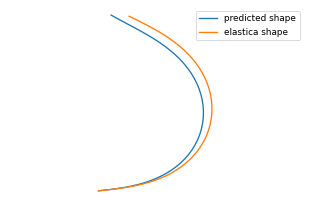


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

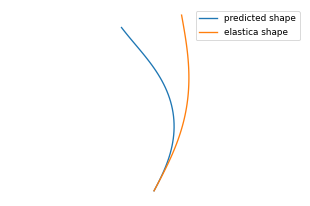


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

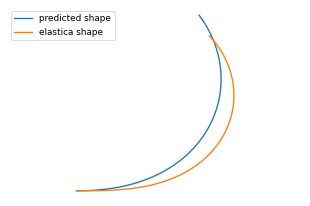


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

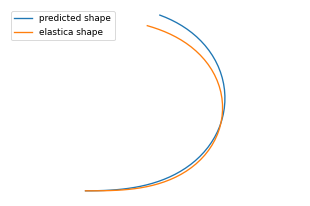


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

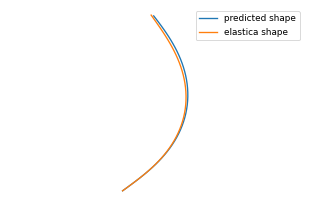


0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

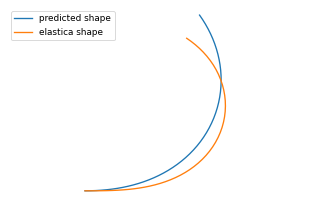


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

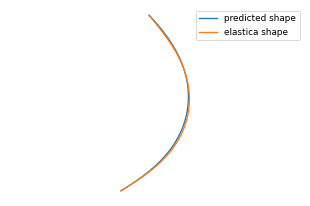


0: 480x640 1 LDO, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

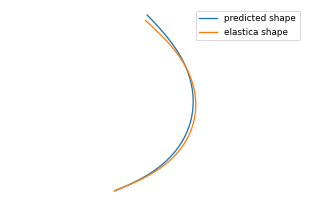


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

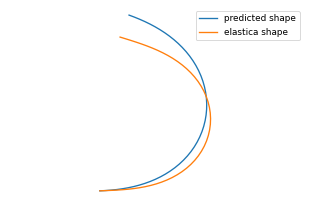


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

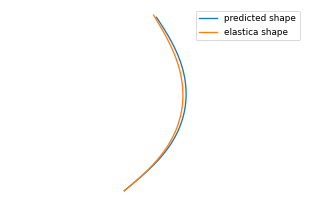


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

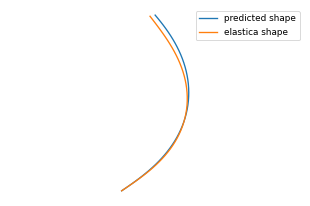


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

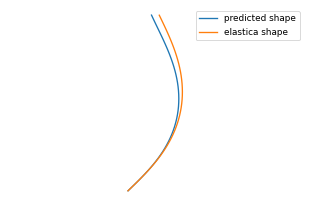


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

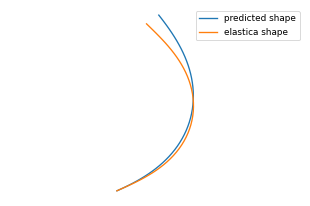


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

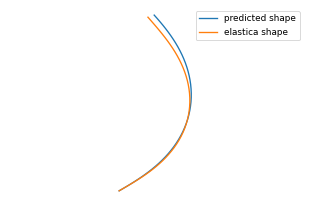


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

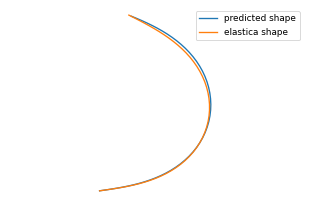


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

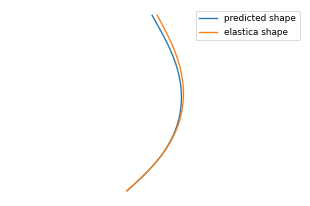


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

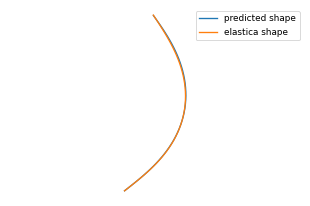


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

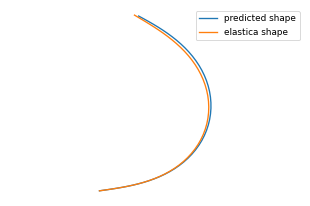


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

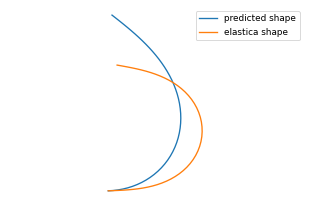


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

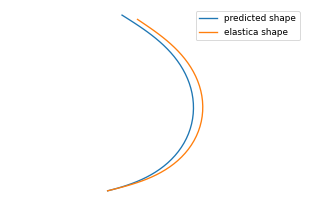


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

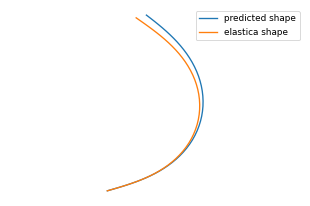


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

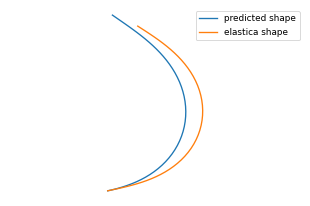


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

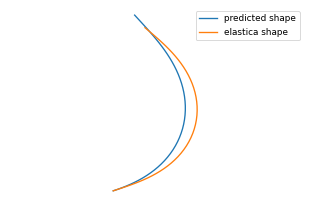


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

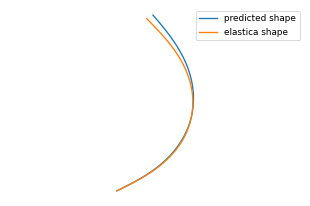


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

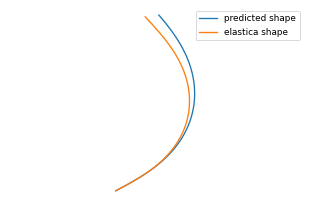


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

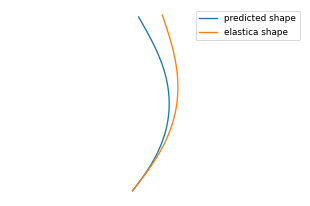


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

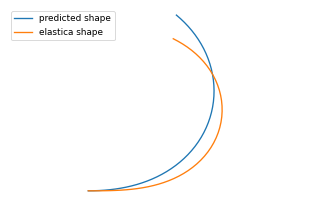


0: 480x640 1 LDO, 9.2ms
Speed: 1.1ms preprocess, 9.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

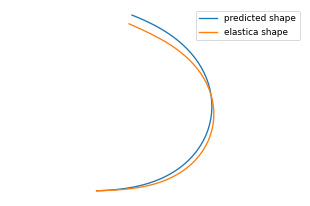


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

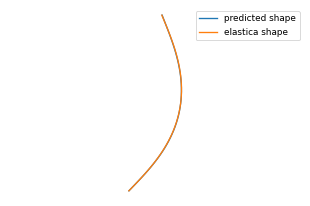


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

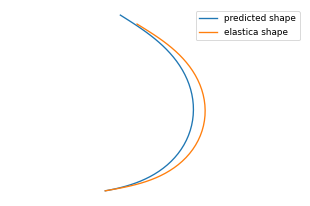


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

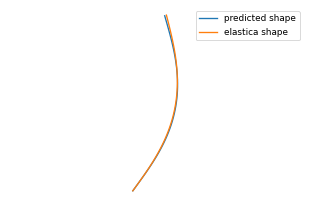


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

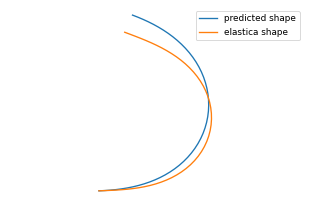


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

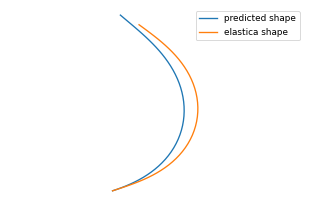


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

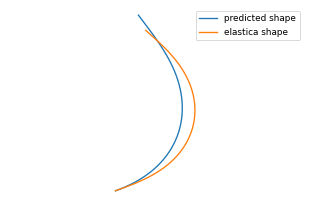


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

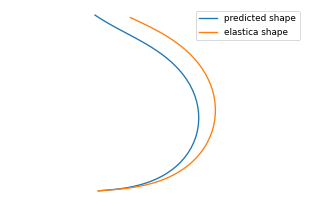

total time: 83.14396071434021


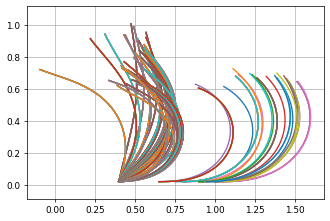


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

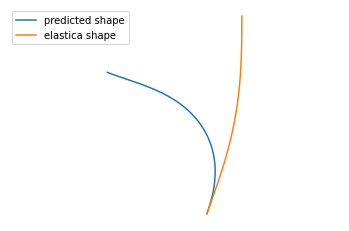


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

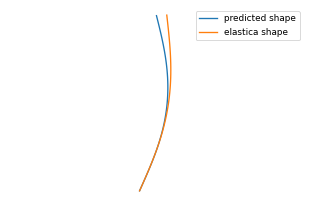


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

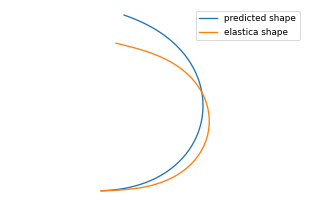


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

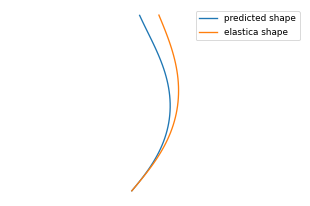


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

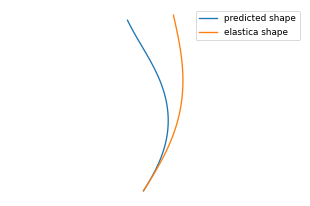


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

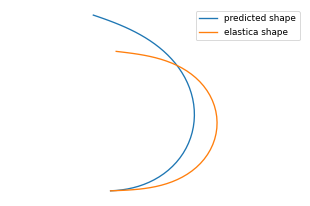


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

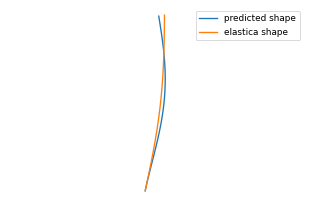


0: 480x640 1 LDO, 9.7ms
Speed: 1.4ms preprocess, 9.7ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

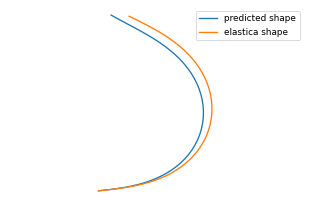


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

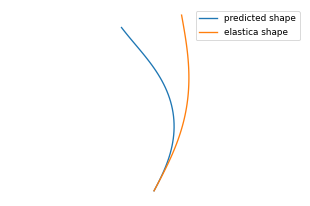


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

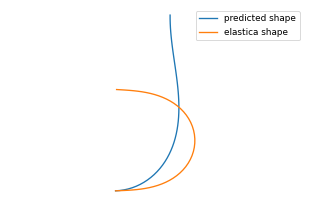


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

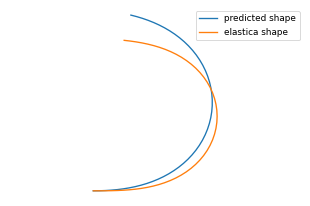


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

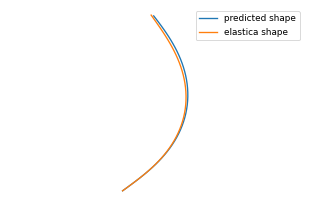


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

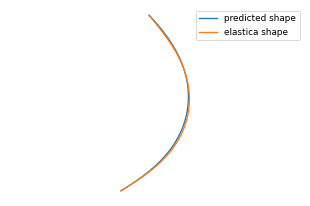


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

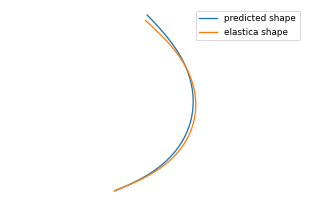


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

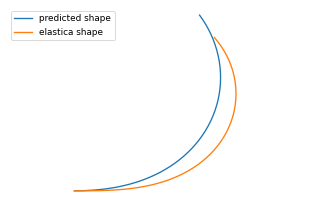


0: 480x640 1 LDO, 8.5ms
Speed: 1.0ms preprocess, 8.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

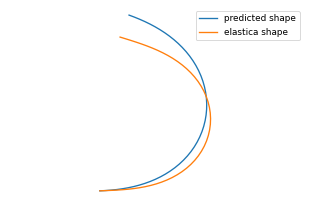


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

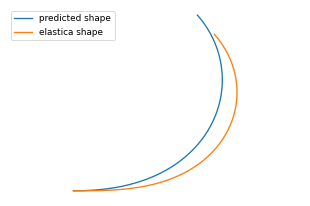


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

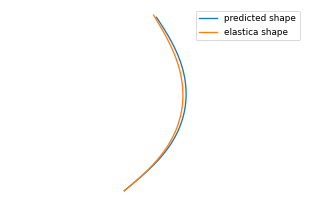


0: 480x640 1 LDO, 8.6ms
Speed: 1.6ms preprocess, 8.6ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

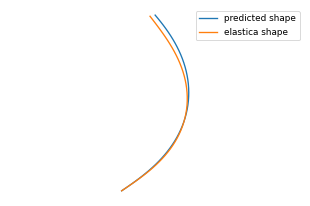


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

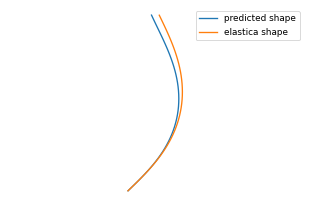


0: 480x640 1 LDO, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

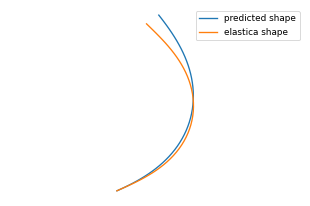


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

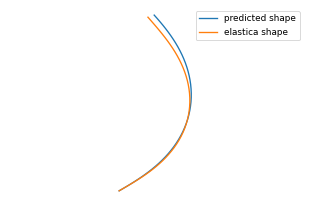


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

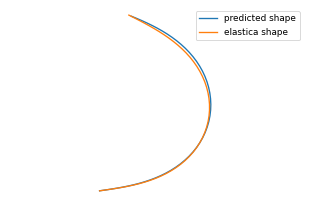


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

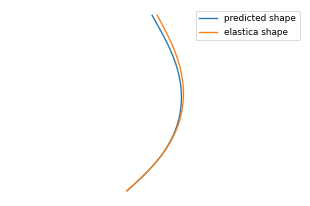


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

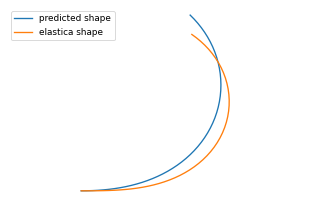


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

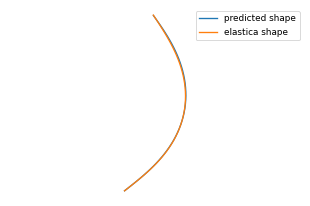


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

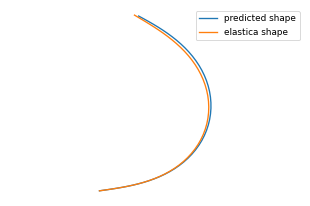


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

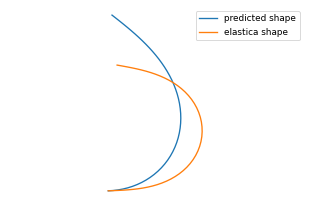


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

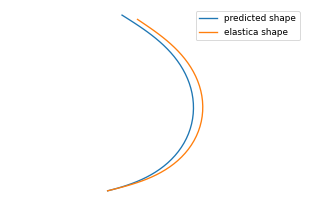


0: 480x640 1 LDO, 8.9ms
Speed: 1.5ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

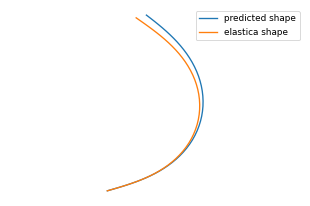


0: 480x640 1 LDO, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

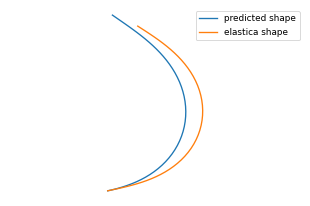


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

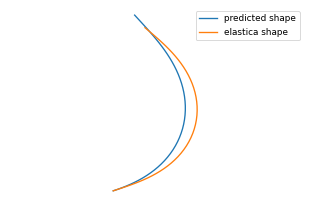


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

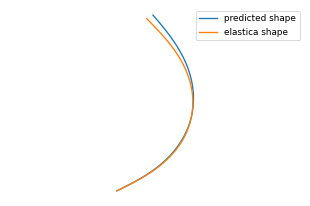


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

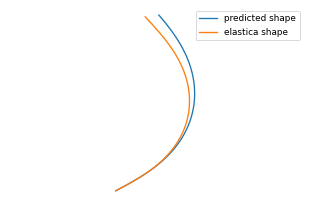


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

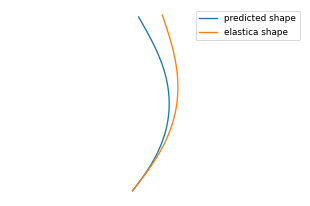


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

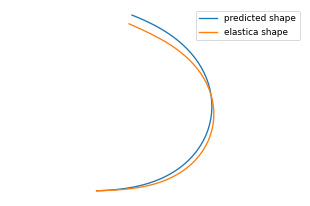


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

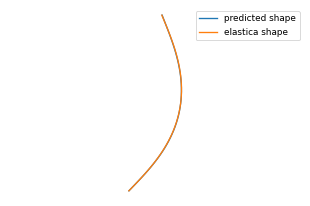


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

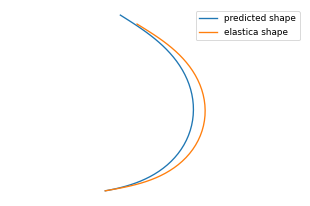


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

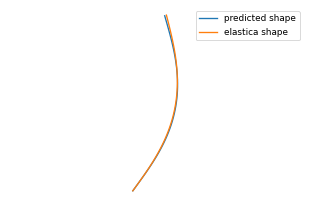


0: 480x640 1 LDO, 10.3ms
Speed: 1.1ms preprocess, 10.3ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

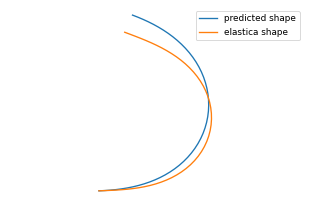


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

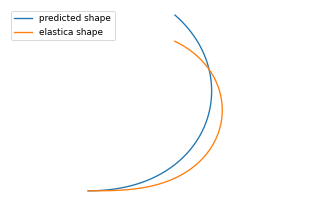


0: 480x640 1 LDO, 9.7ms
Speed: 1.7ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

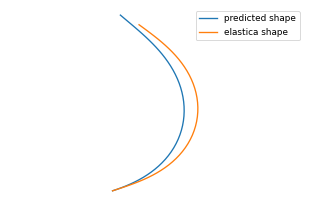


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

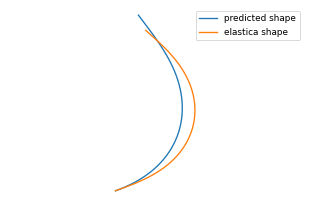


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

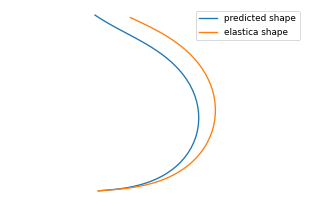

total time: 97.04703736305237


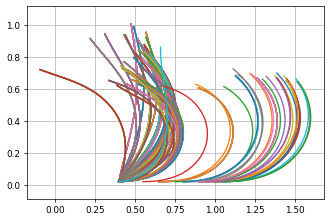


0: 480x640 1 LDO, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

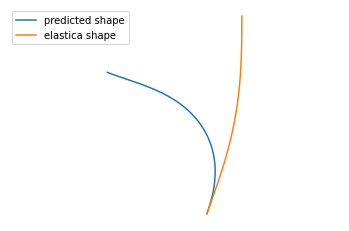


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

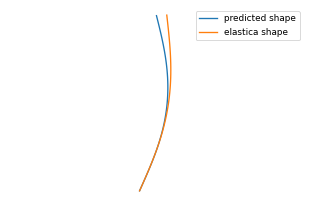


0: 480x640 1 LDO, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

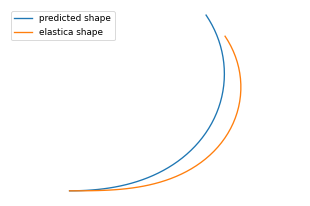


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

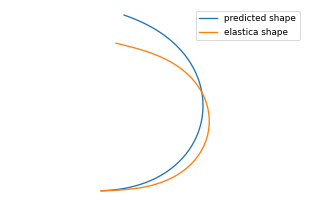


0: 480x640 1 LDO, 9.9ms
Speed: 1.7ms preprocess, 9.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

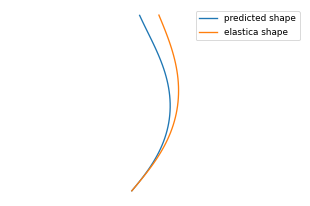


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

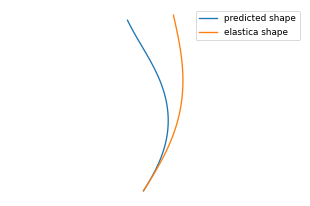


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

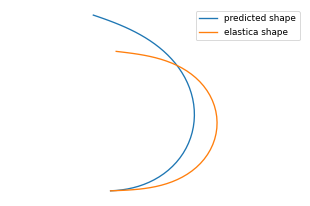


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

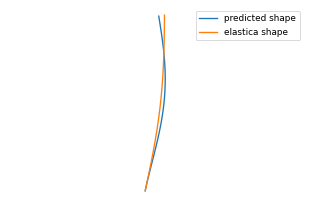


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

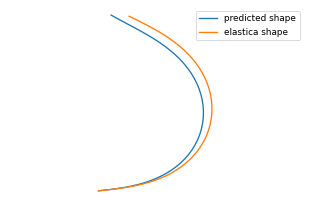


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

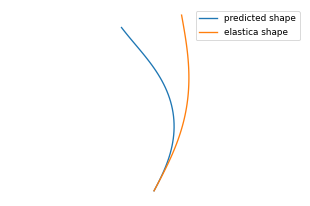


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

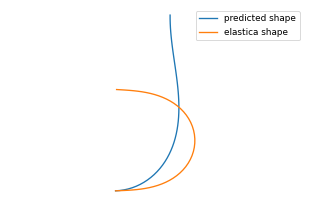


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

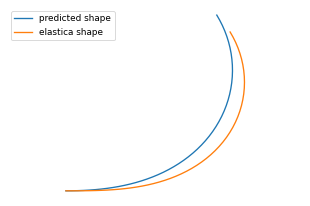


0: 480x640 1 LDO, 9.2ms
Speed: 1.3ms preprocess, 9.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

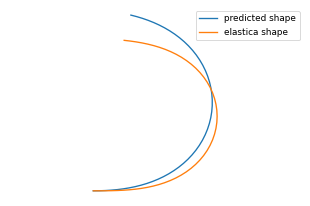


0: 480x640 1 LDO, 9.1ms
Speed: 1.4ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

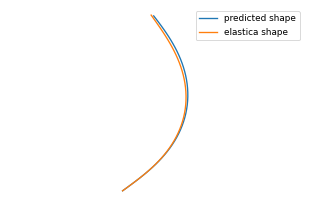


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

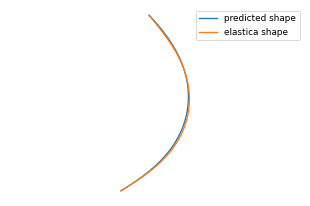


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

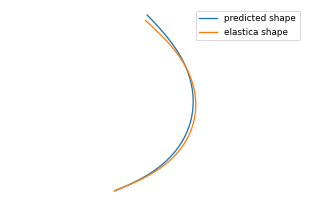


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

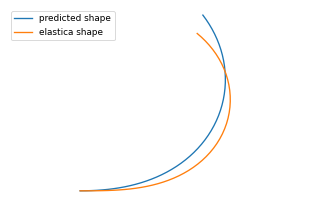


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

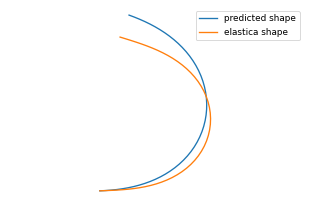


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

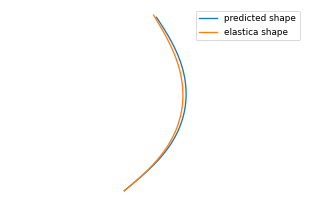


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

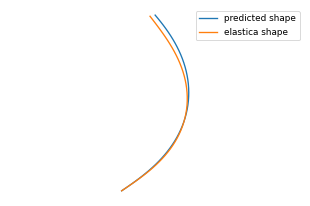


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

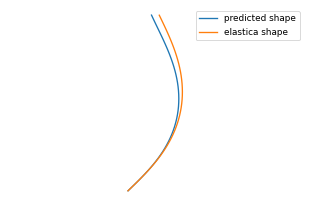


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

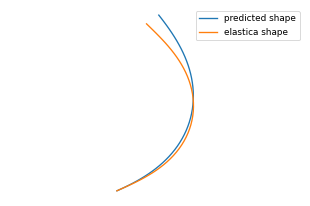


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

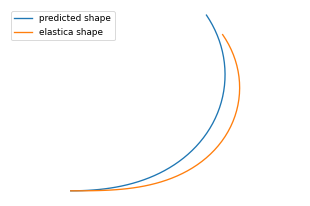


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

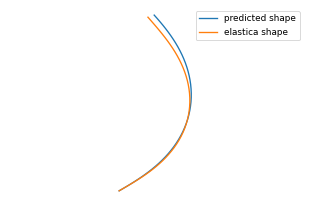


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

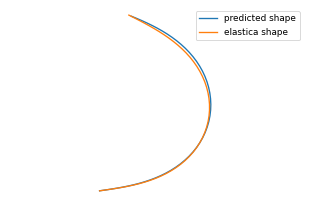


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

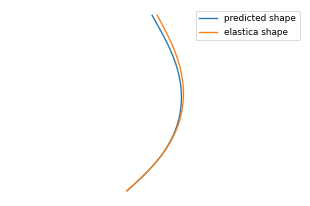


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

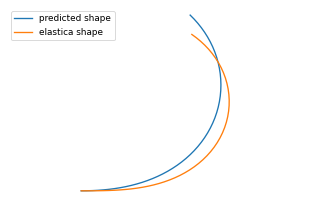


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

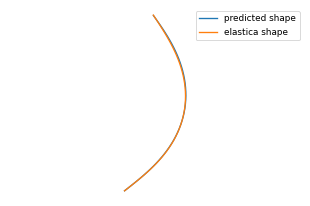


0: 480x640 1 LDO, 9.4ms
Speed: 1.4ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

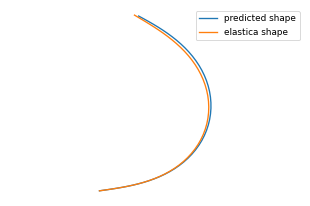


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

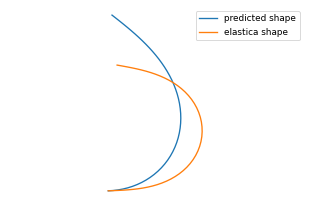


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

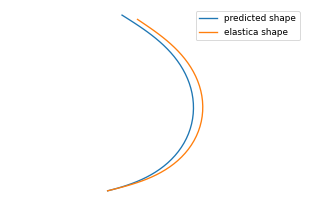


0: 480x640 1 LDO, 9.8ms
Speed: 1.4ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

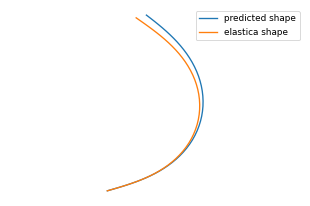


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

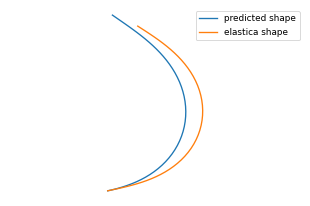


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

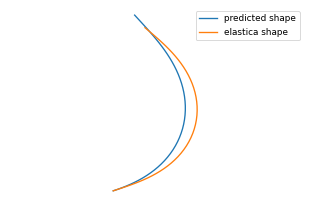


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

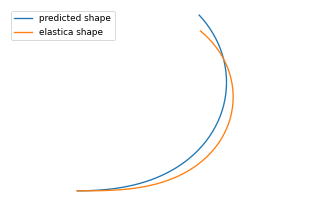


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

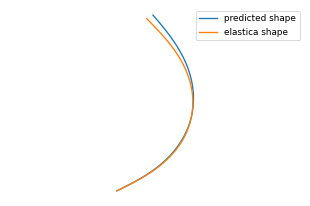


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

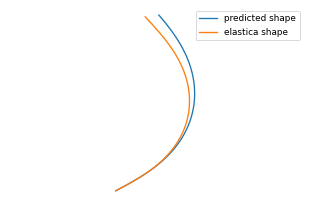


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

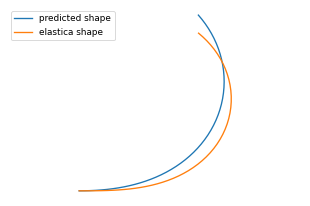


0: 480x640 1 LDO, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

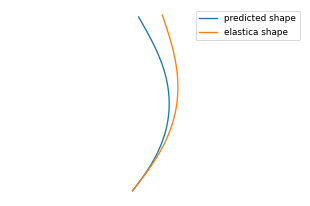


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

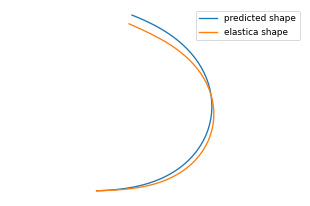


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

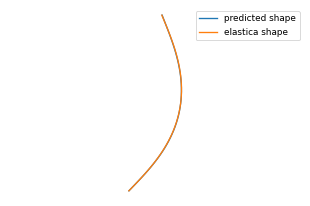


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

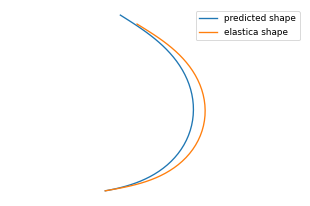


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

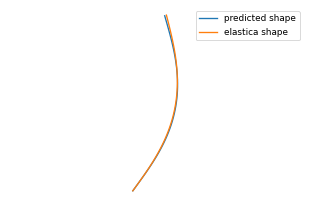


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

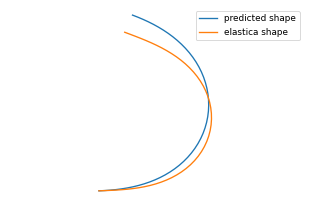


0: 480x640 1 LDO, 8.8ms
Speed: 1.4ms preprocess, 8.8ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

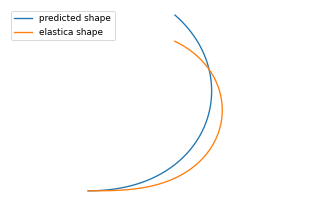


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

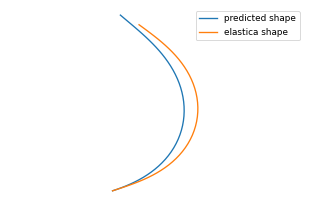


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

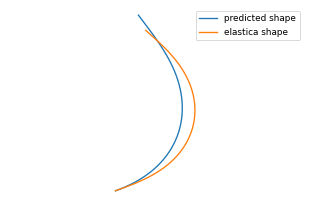


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

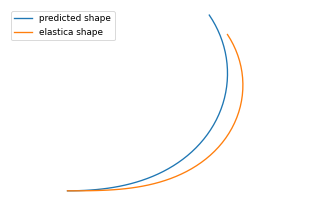


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

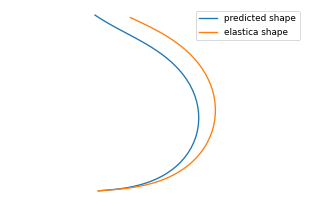

total time: 113.11478805541992


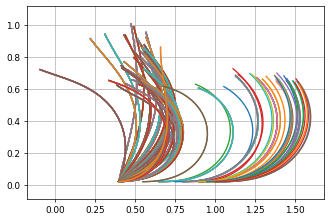


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

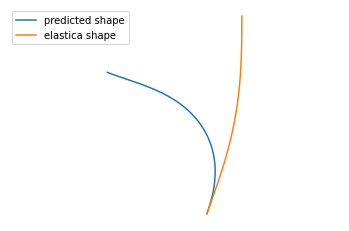


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

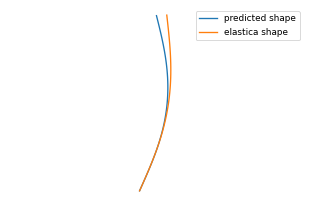


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

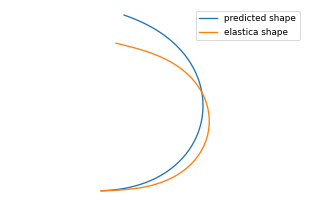


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

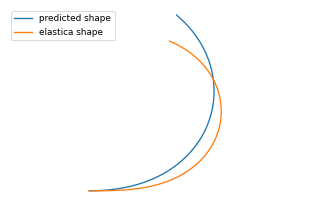


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

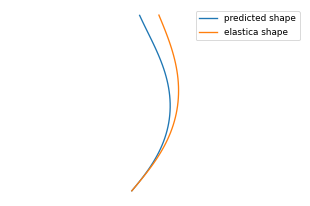


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

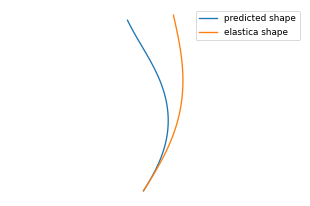


0: 480x640 1 LDO, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

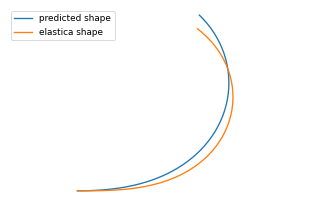


0: 480x640 1 LDO, 9.1ms
Speed: 1.2ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

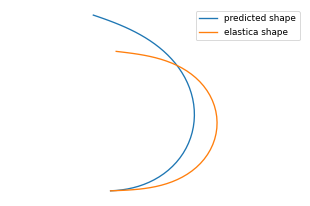


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

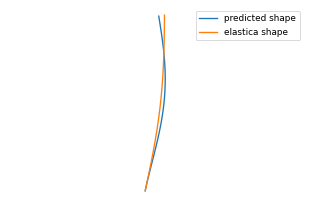


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

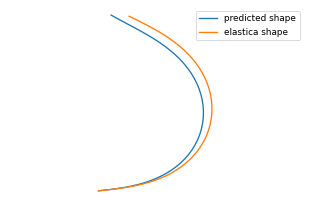


0: 480x640 1 LDO, 10.1ms
Speed: 1.6ms preprocess, 10.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

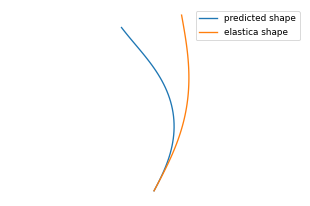


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

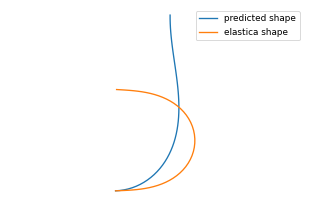


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

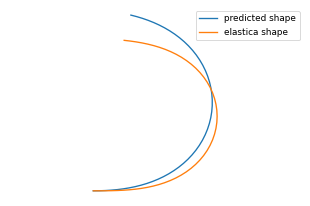


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

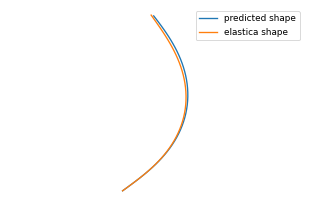


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

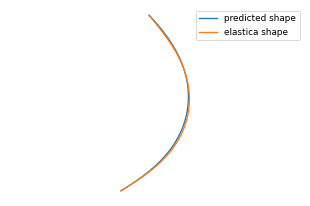


0: 480x640 1 LDO, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

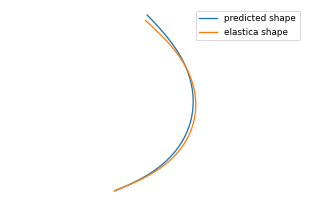


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

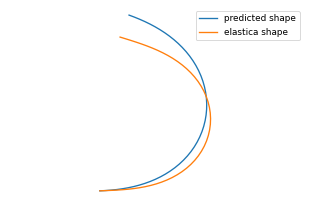


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

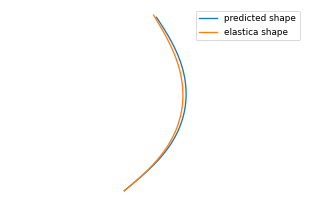


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

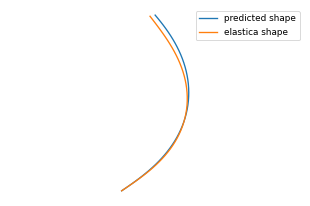


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

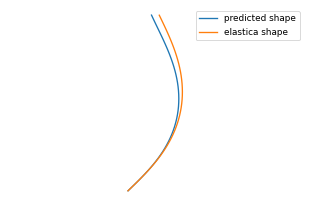


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

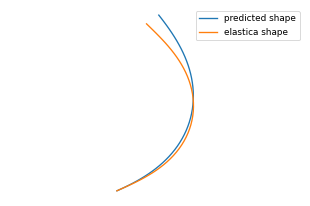


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

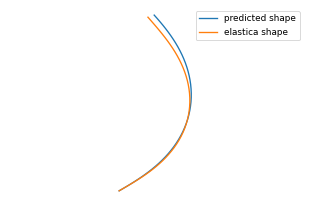


0: 480x640 1 LDO, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

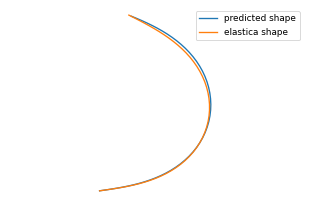


0: 480x640 1 LDO, 10.1ms
Speed: 1.4ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

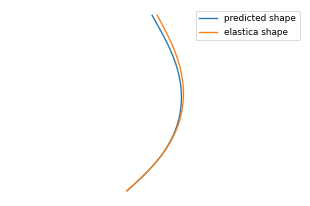


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

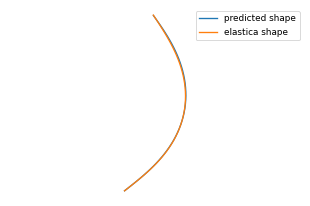


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

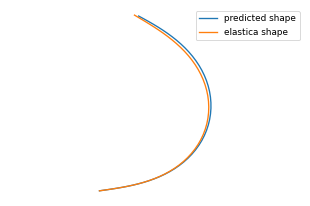


0: 480x640 1 LDO, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

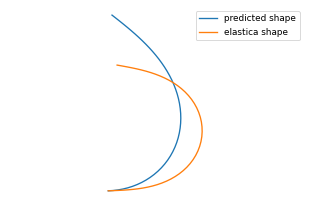


0: 480x640 1 LDO, 8.9ms
Speed: 1.4ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

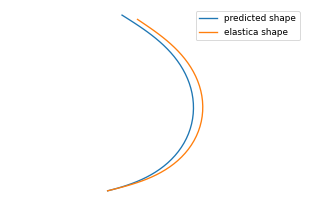


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

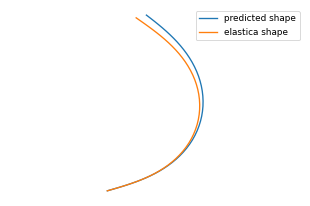


0: 480x640 1 LDO, 8.8ms
Speed: 1.3ms preprocess, 8.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

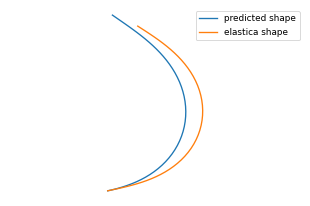


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

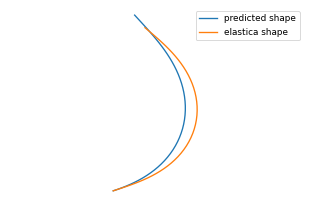


0: 480x640 1 LDO, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

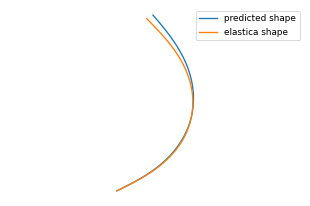


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

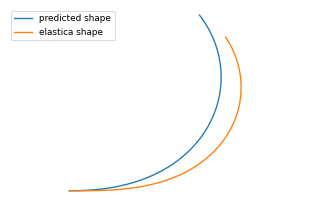


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

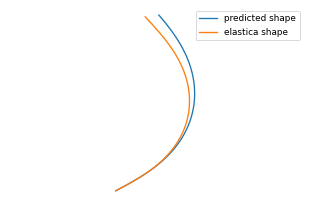


0: 480x640 1 LDO, 9.3ms
Speed: 1.4ms preprocess, 9.3ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

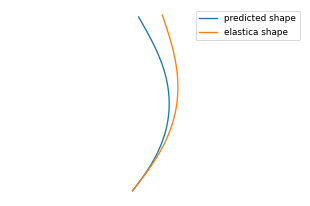


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

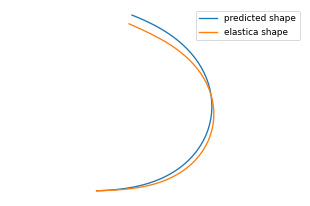


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

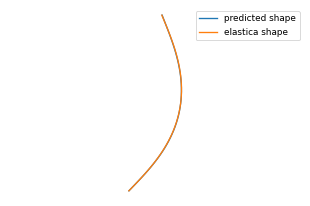


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

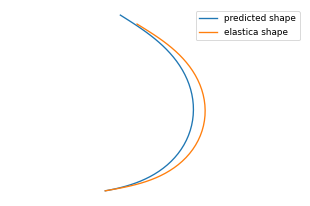


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

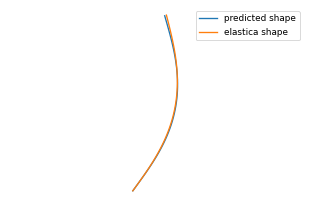


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

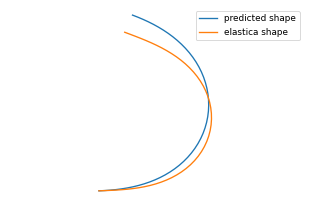


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

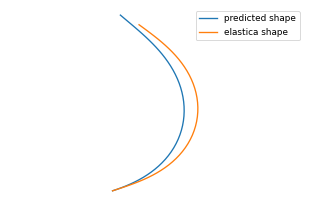


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

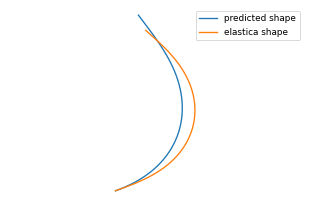


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

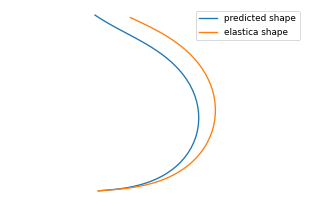

total time: 127.05863404273987


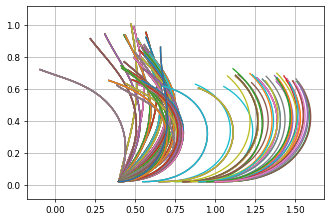


0: 480x640 1 LDO, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

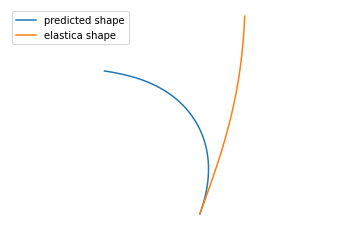


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

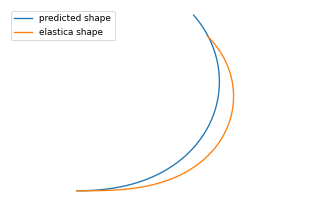


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

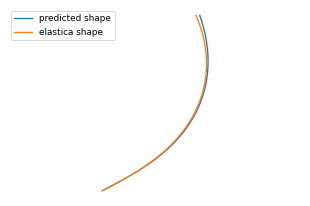


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

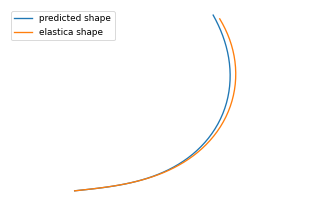


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

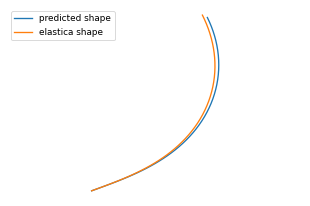


0: 480x640 1 LDO, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

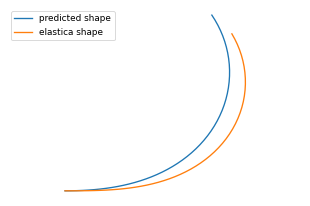


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

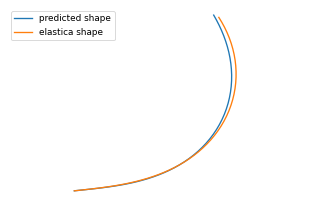


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

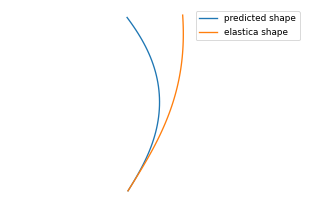


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

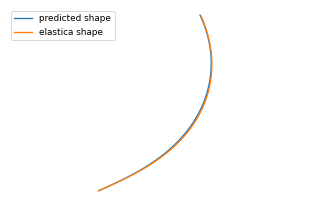


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

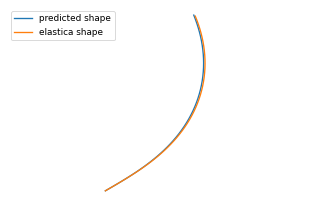


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

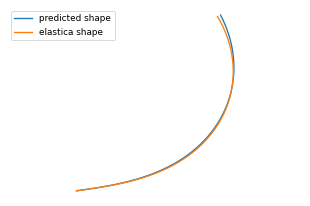


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

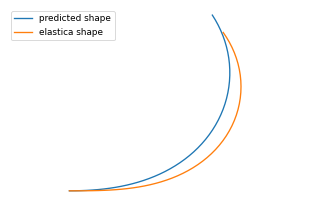


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

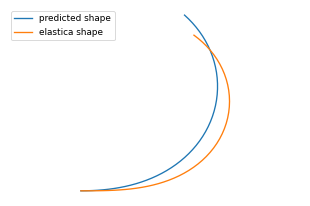


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

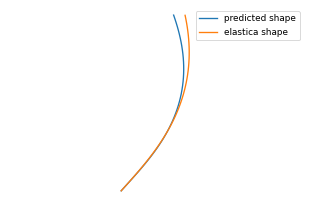


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

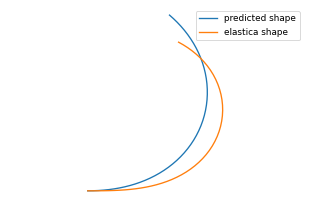


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

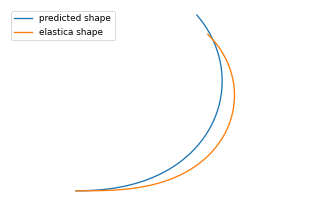


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

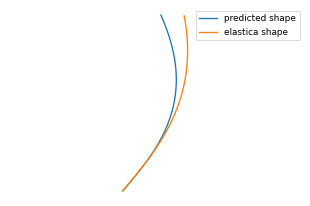


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

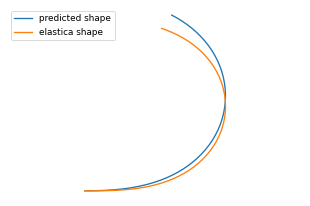


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

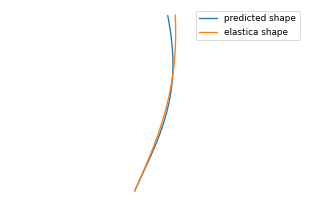


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

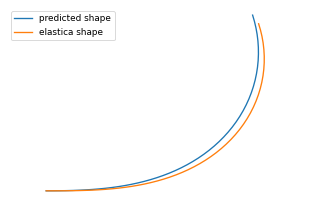


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

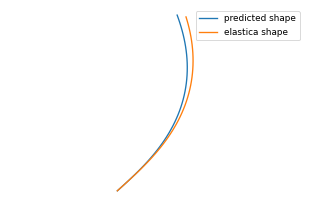


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

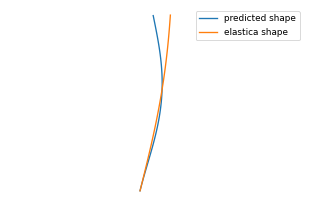


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

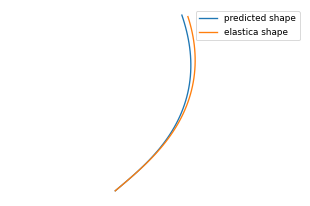


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

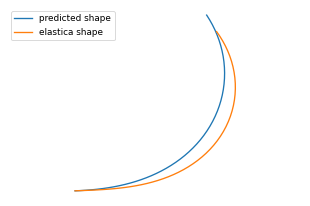


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

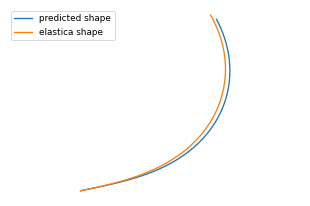


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

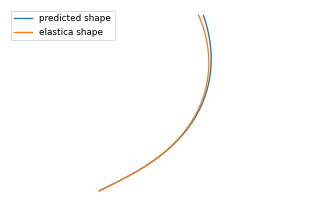


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

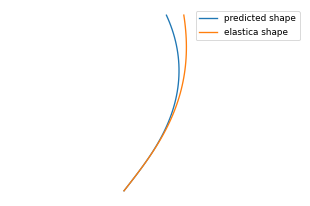


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

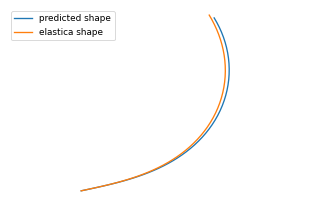


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

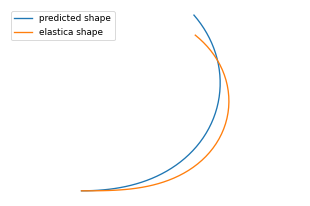


0: 480x640 1 LDO, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

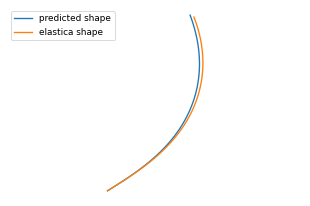


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

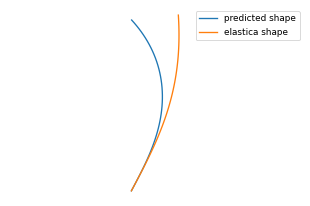


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

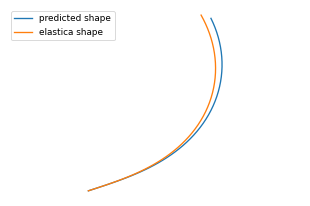


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

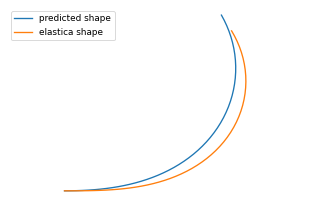


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

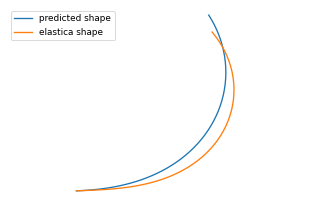


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

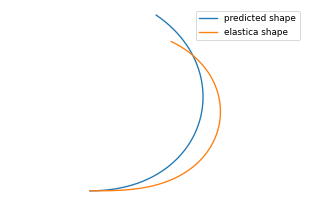


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

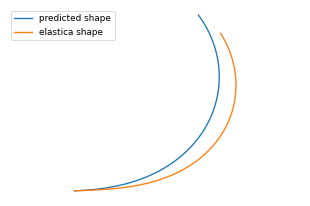


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

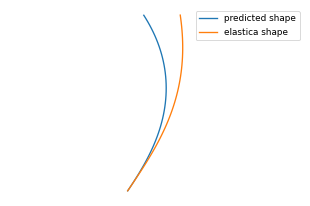


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

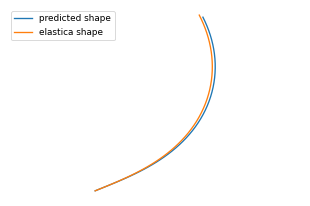


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

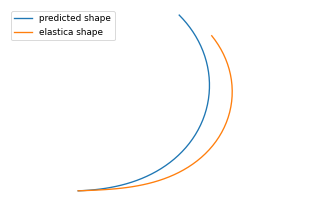


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

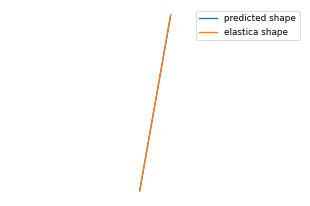


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

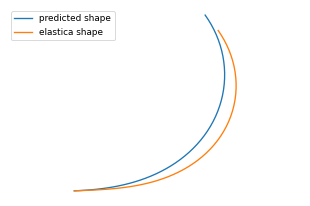


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

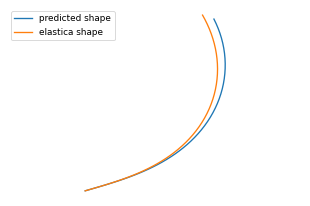


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

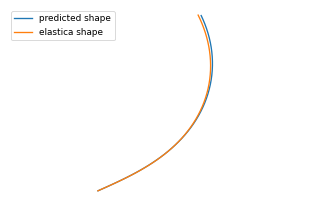


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

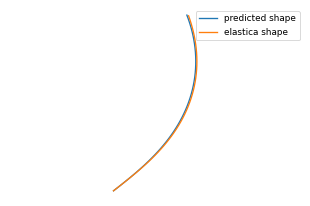


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

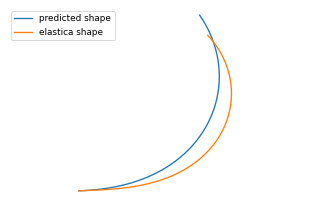


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

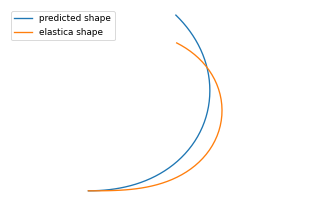


0: 480x640 1 LDO, 9.8ms
Speed: 1.2ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

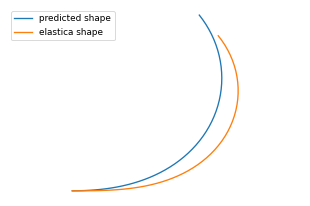


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

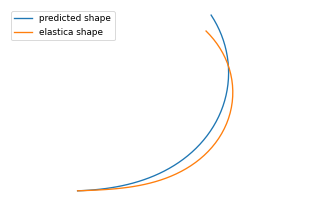


0: 480x640 1 LDO, 9.1ms
Speed: 1.1ms preprocess, 9.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

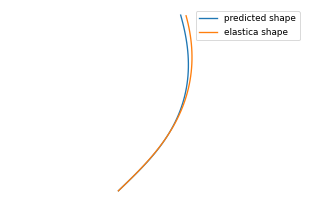


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

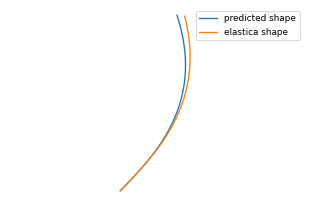


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

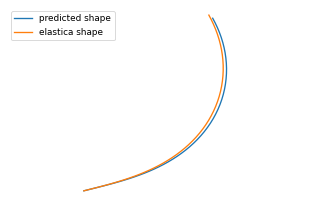


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

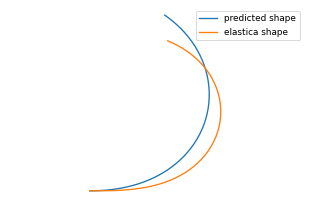


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

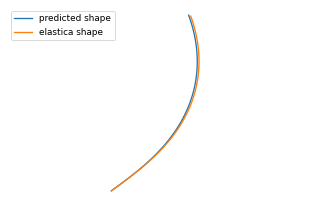


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

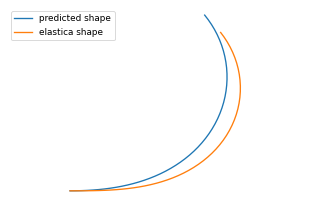


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

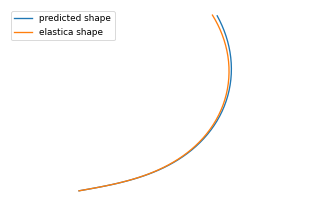


0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

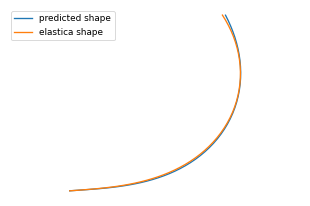


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

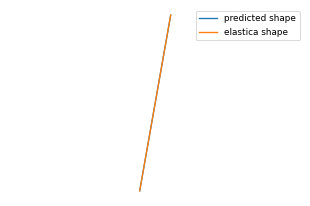


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

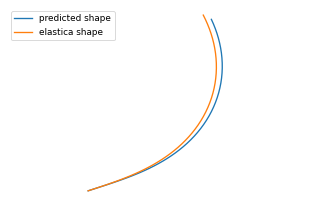


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

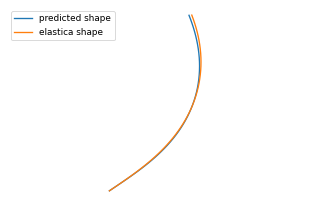

total time: 145.1981270313263


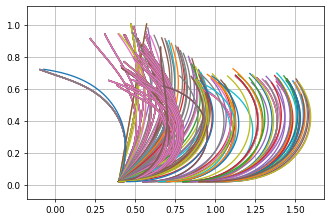


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

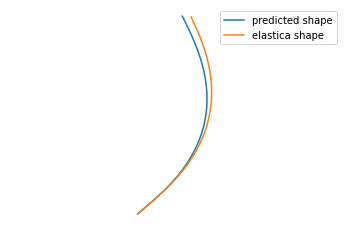


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

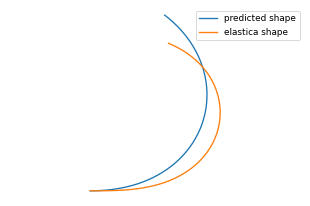


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

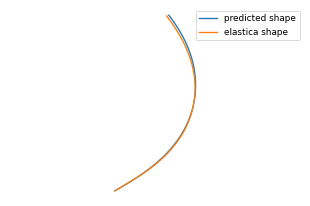


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

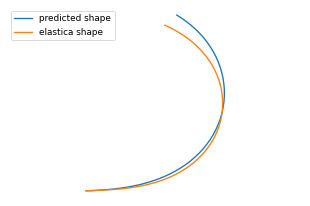


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

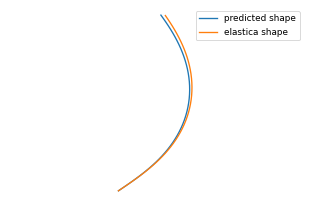


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

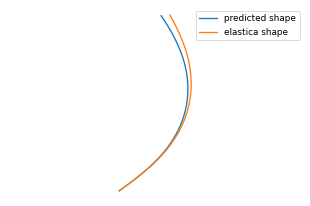


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

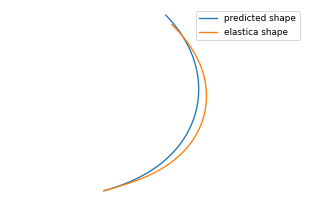


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

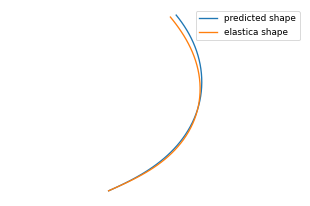


0: 480x640 1 LDO, 9.2ms
Speed: 1.6ms preprocess, 9.2ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

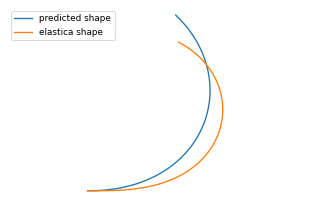


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

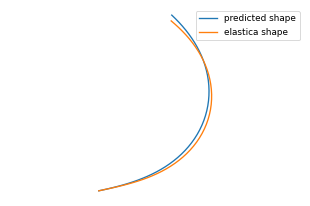


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

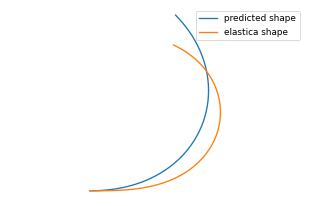


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

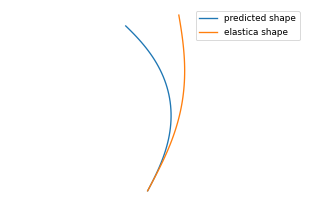


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

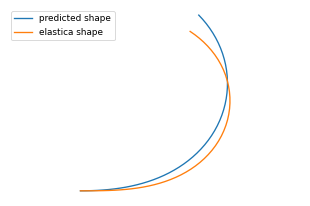


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

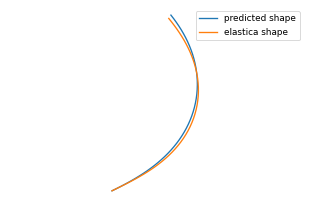


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

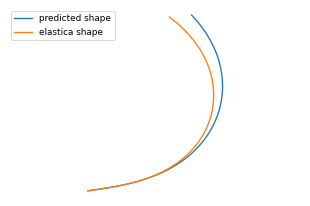


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

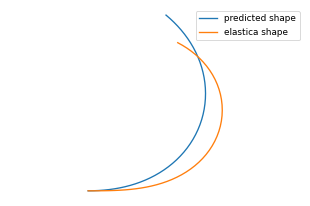


0: 480x640 1 LDO, 9.0ms
Speed: 1.6ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

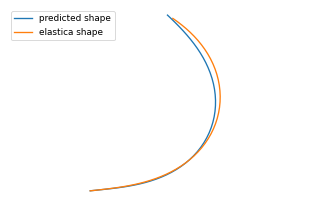


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

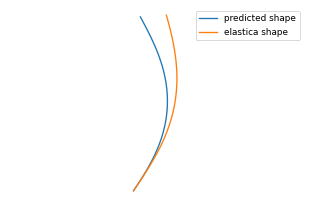


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

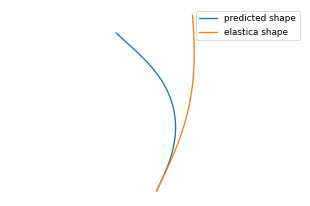


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

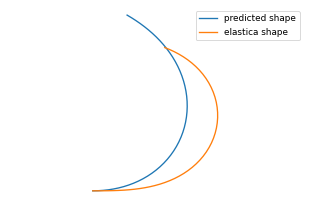


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

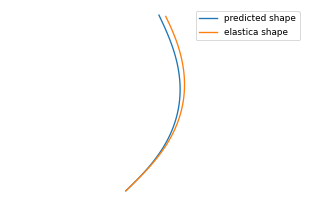


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

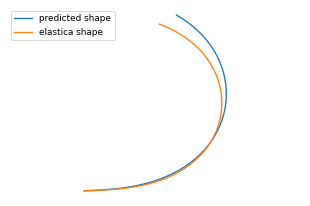


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

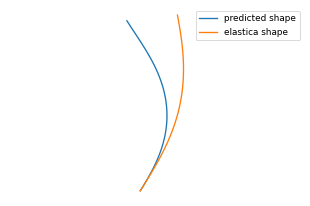


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

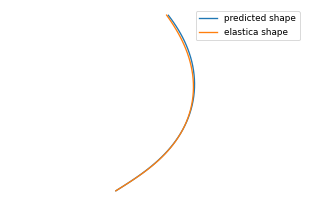


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

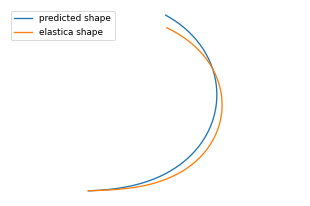


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

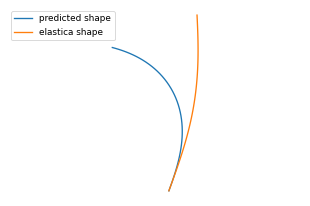


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

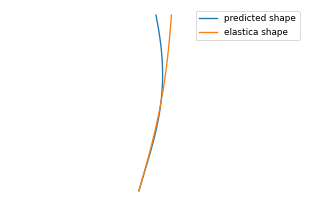


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

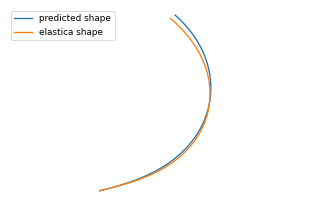


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

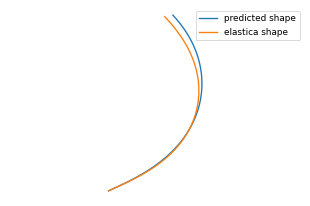


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

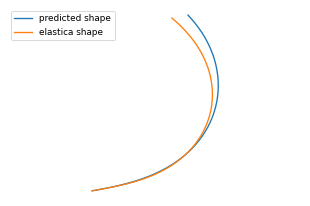


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

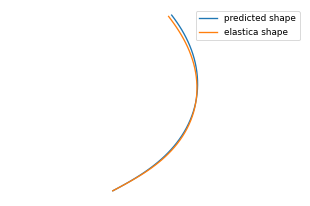


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

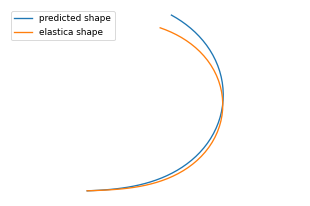


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

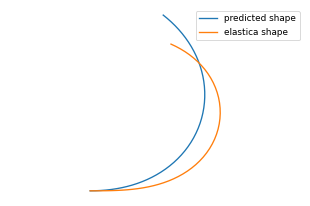


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

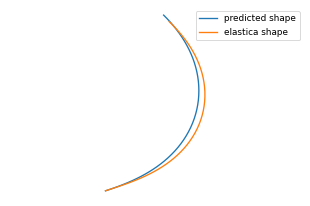


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

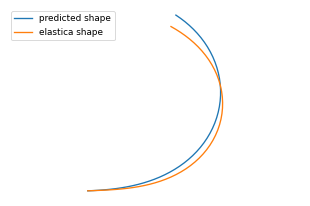


0: 480x640 1 LDO, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

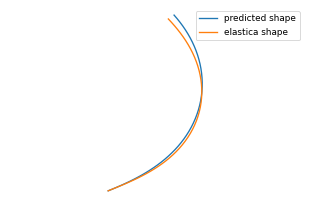


0: 480x640 1 LDO, 9.2ms
Speed: 1.2ms preprocess, 9.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

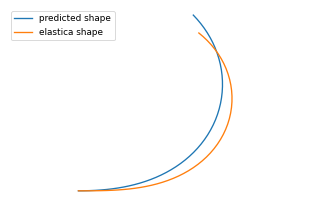


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

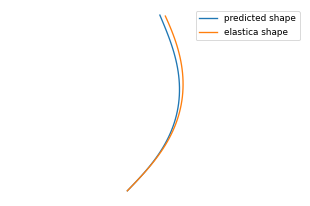


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

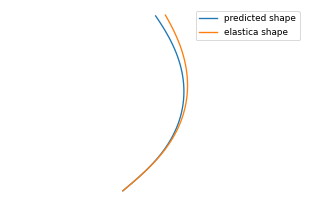


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

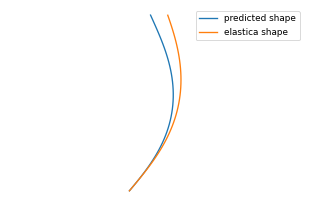


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

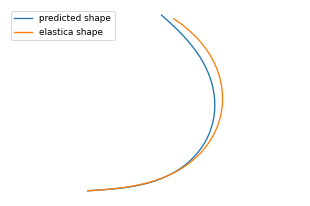


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

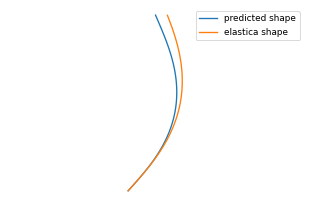


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

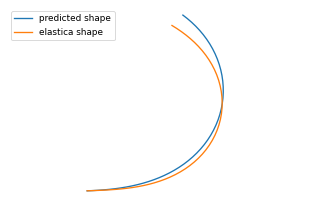


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

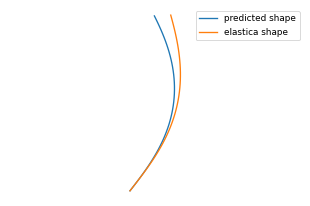


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

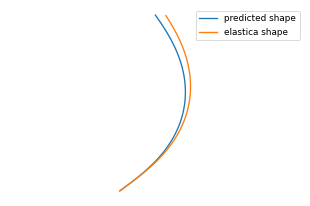


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

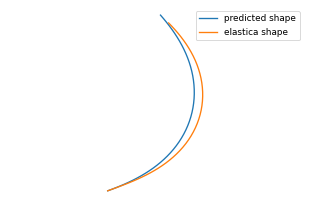


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

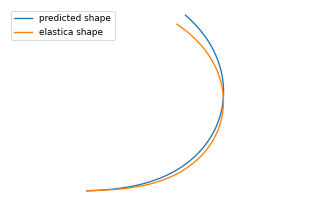


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

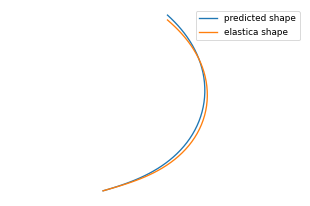


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

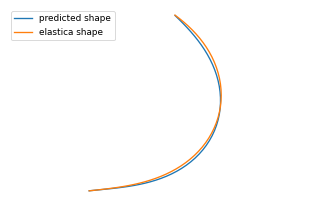


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

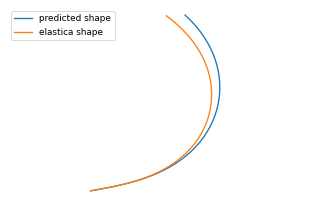

total time: 160.48460602760315


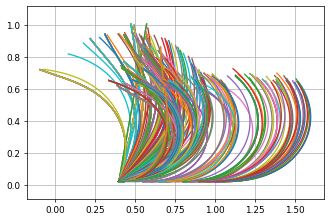


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

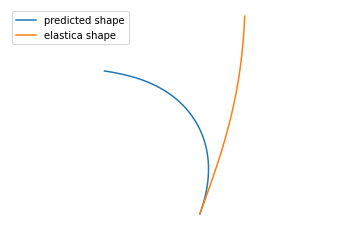


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

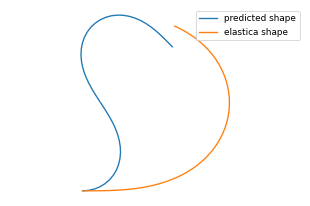


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

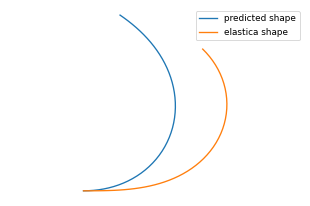


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

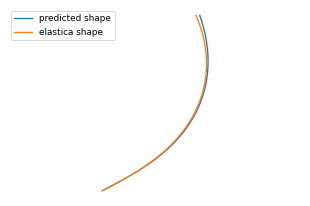


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

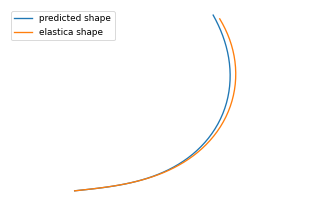


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

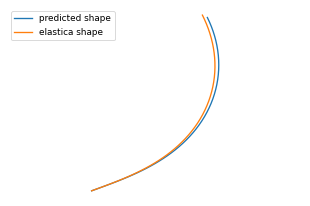


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

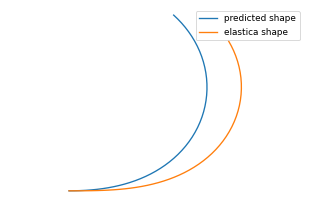


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

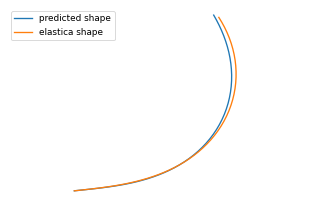


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

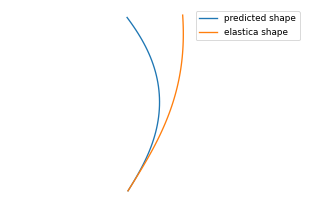


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

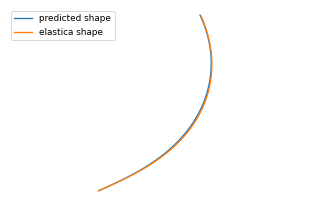


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

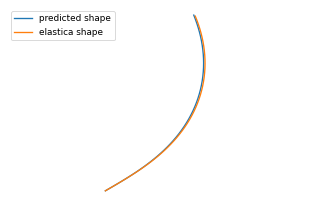


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

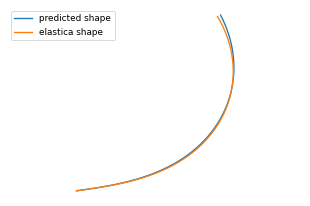


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

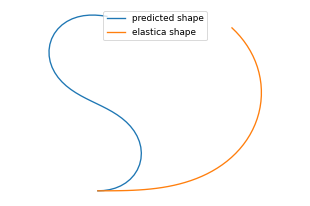


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

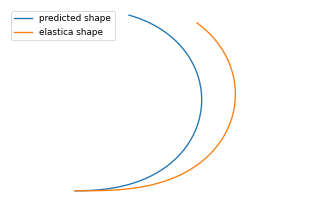


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

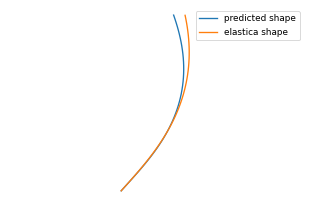


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

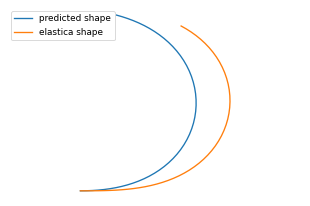


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

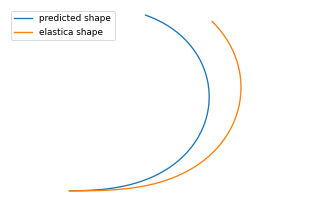


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

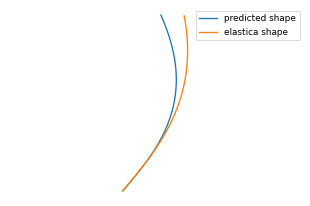


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

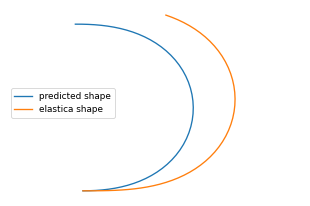


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

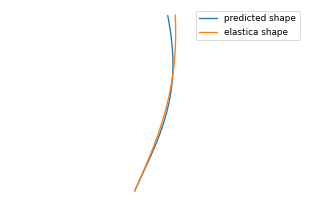


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

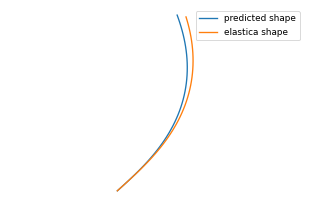


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

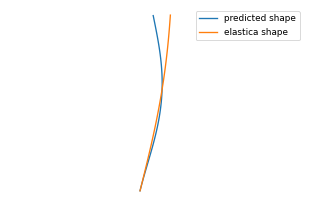


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

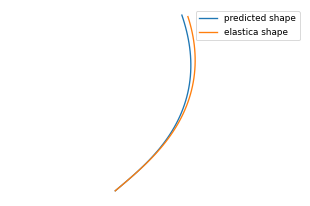


0: 480x640 2 LDOs, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

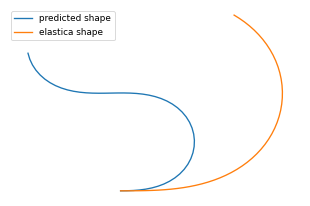


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

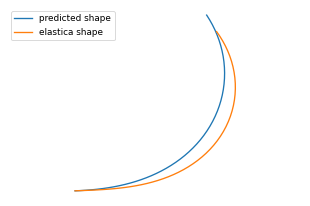


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

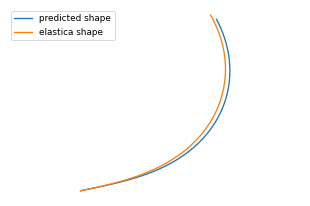


0: 480x640 1 LDO, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

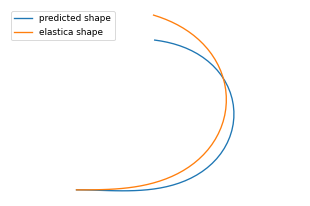


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

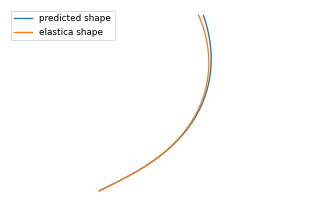


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

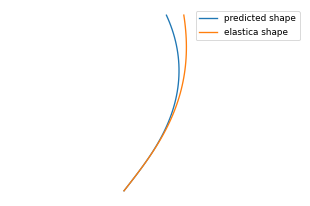


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

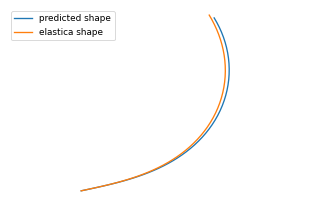


0: 480x640 1 LDO, 8.7ms
Speed: 1.1ms preprocess, 8.7ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

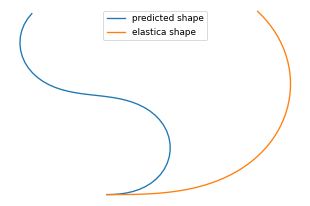


0: 480x640 1 LDO, 8.9ms
Speed: 1.6ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

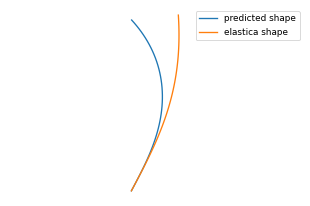


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

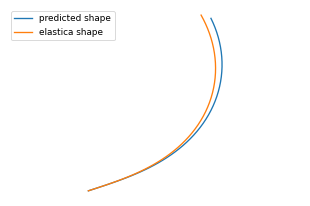


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

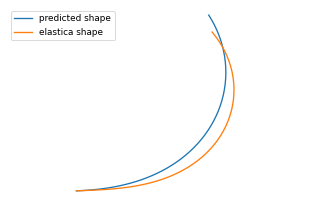


0: 480x640 2 LDOs, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

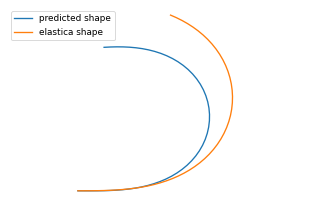


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

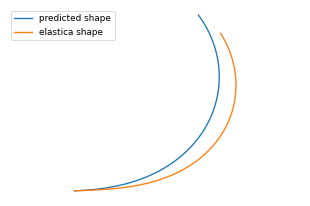


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

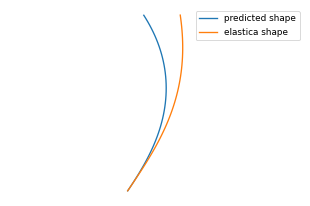


0: 480x640 1 LDO, 10.3ms
Speed: 1.1ms preprocess, 10.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

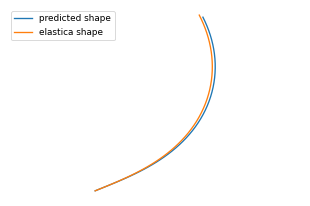


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

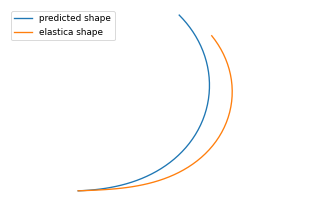


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

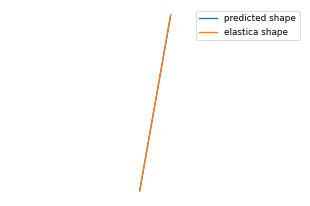


0: 480x640 1 LDO, 10.2ms
Speed: 1.5ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

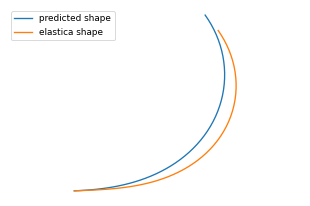


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

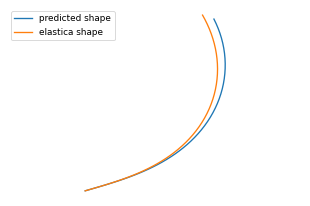


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

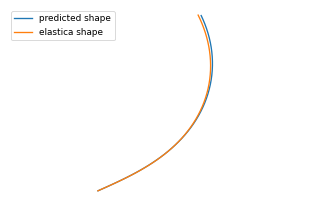


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

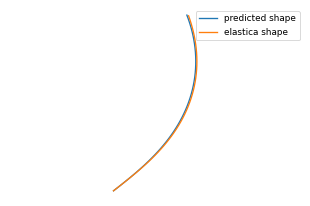


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

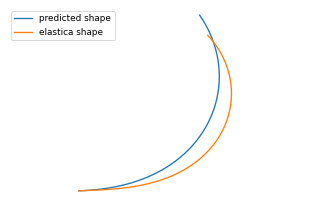


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

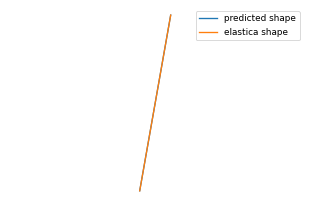


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

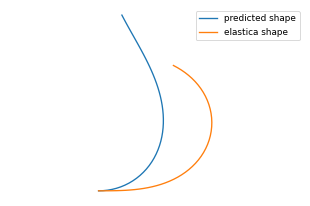


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

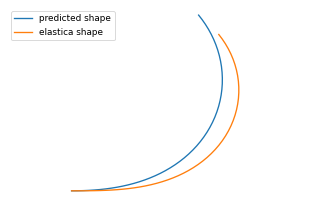


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

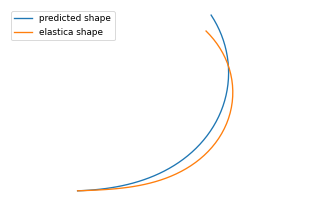


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

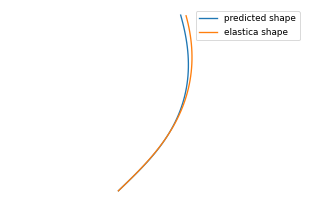


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

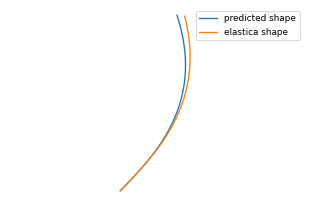


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

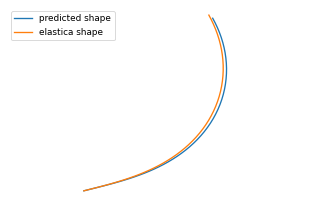


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

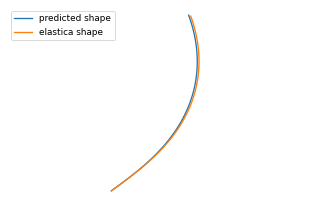


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

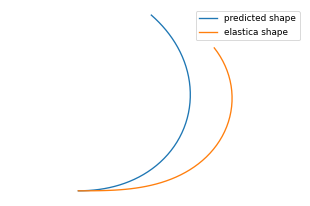


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

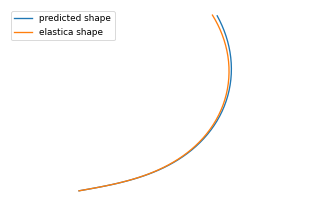


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

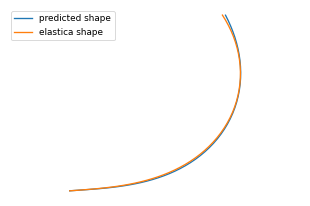


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

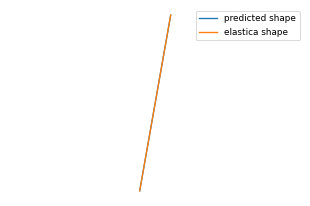


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

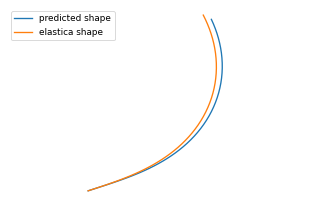


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

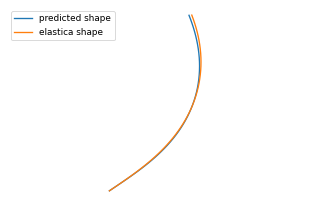

total time: 178.76682305335999


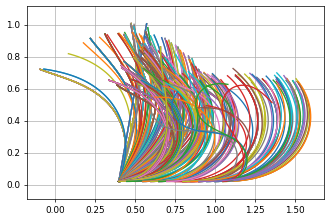


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

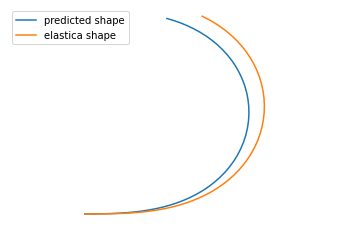


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

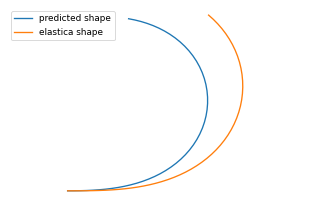


0: 480x640 1 LDO, 8.8ms
Speed: 1.2ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

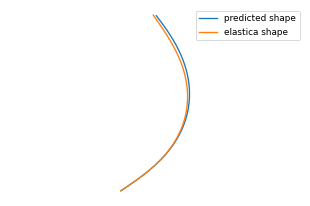


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

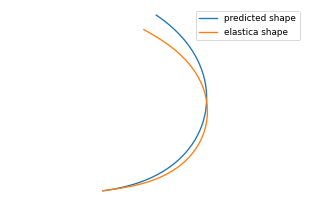


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

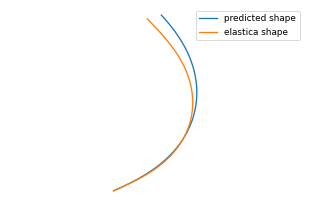


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

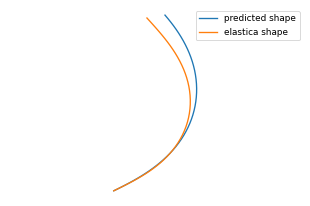


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

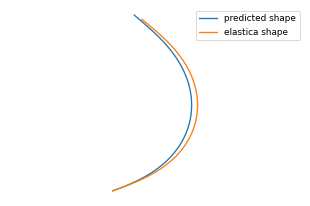


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

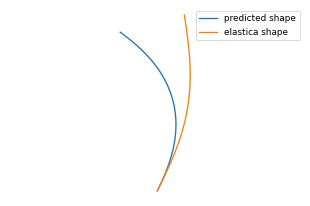


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

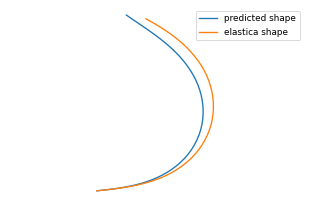


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

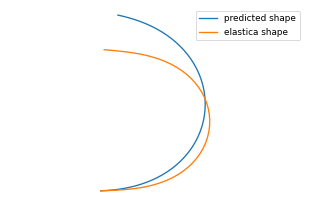


0: 480x640 1 LDO, 9.8ms
Speed: 1.4ms preprocess, 9.8ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

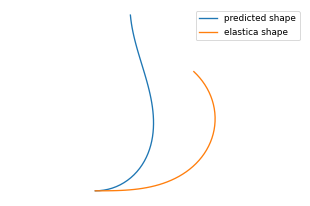


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

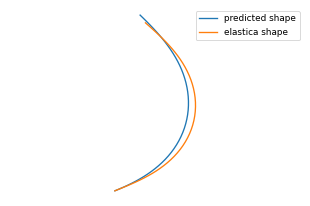


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

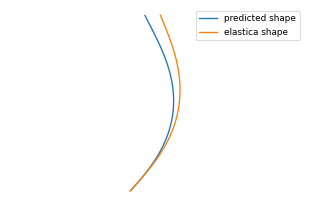


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

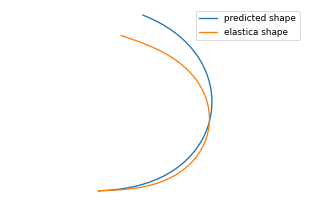


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

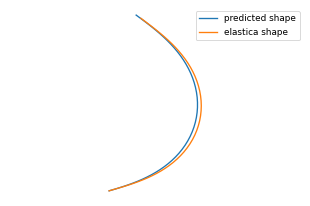


0: 480x640 2 LDOs, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

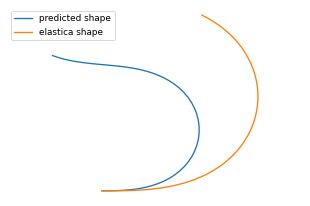


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

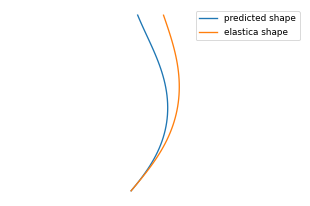


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

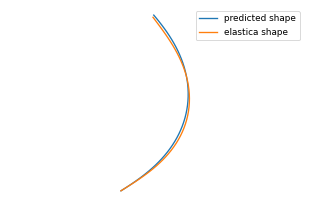


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

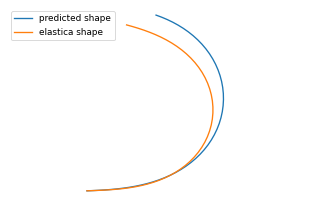


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

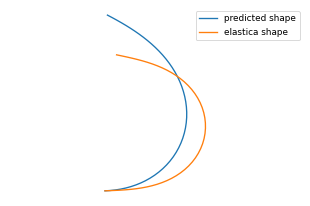


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

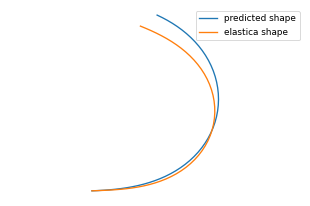


0: 480x640 1 LDO, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

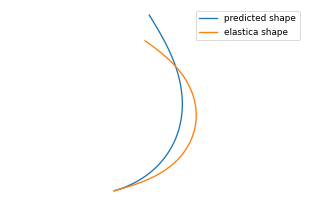


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

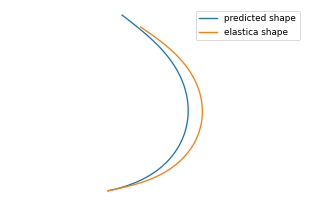


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

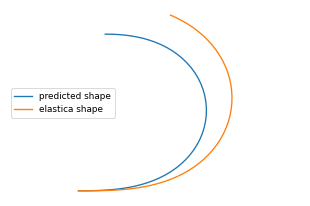


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

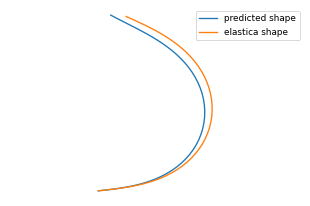


0: 480x640 1 LDO, 10.3ms
Speed: 1.1ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

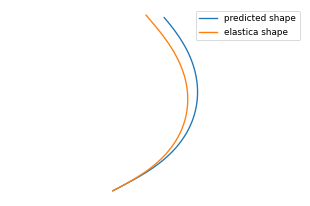


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

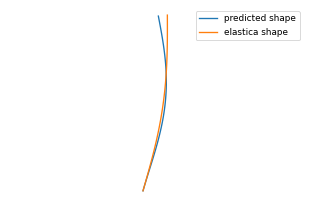


0: 480x640 2 LDOs, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

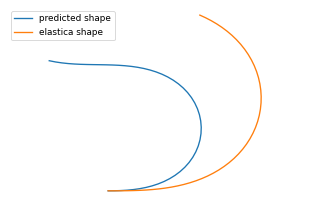


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

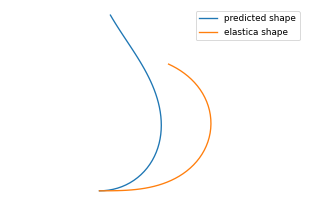


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

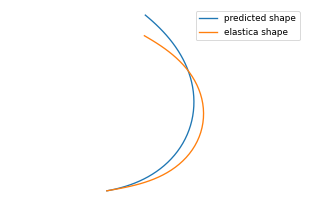


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

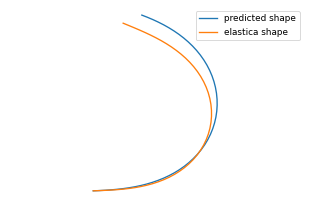


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

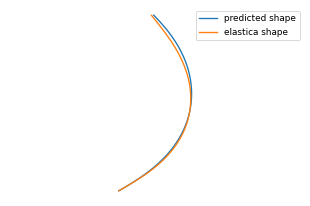


0: 480x640 1 LDO, 9.8ms
Speed: 1.2ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

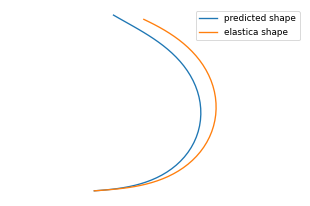


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

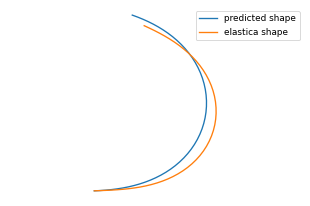


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

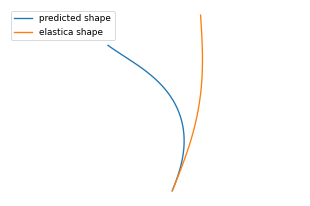


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

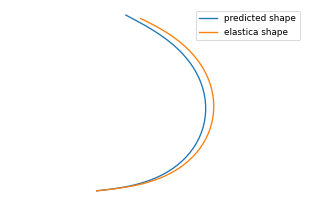


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

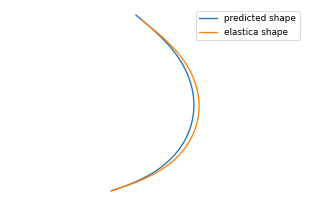


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

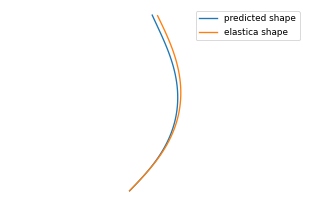


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

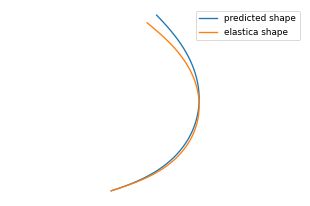


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

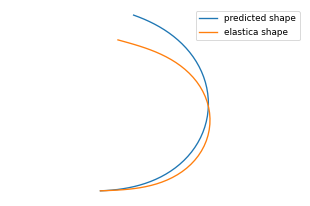


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

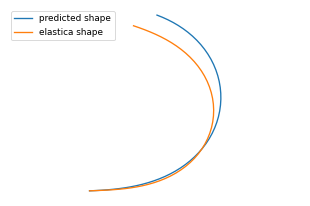


0: 480x640 2 LDOs, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

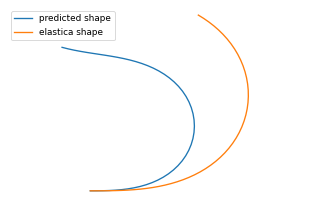


0: 480x640 2 LDOs, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

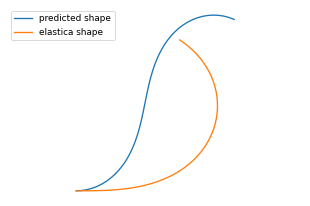


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

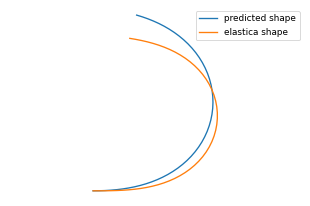


0: 480x640 2 LDOs, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

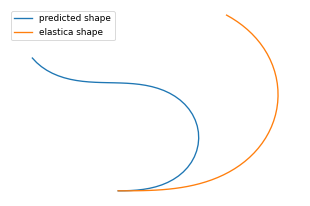


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

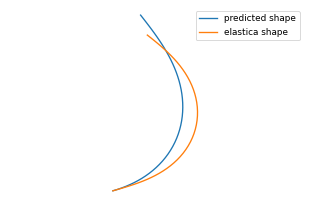


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

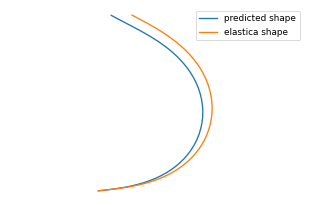


0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

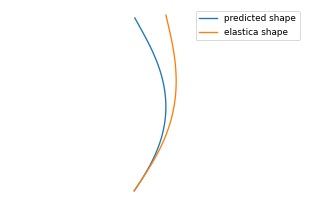


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

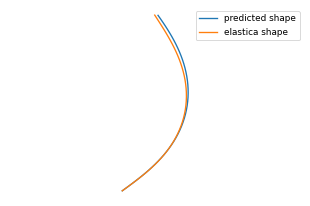


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

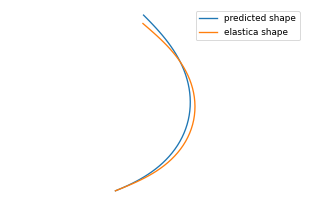


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

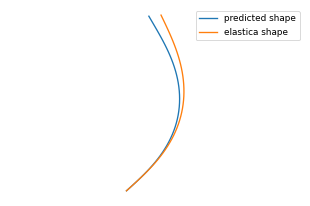


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

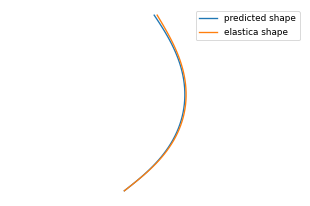


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

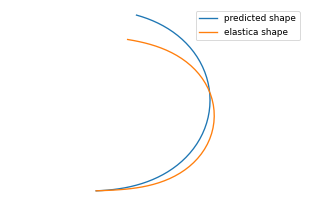


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

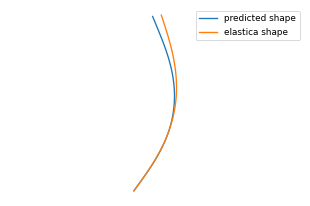


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

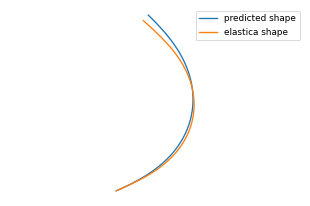


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

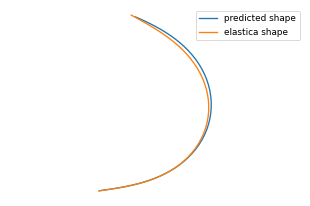


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

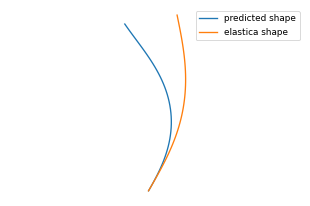


0: 480x640 1 LDO, 9.5ms
Speed: 1.5ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

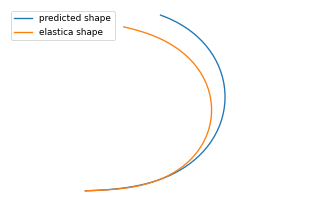


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

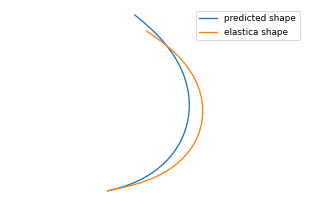


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

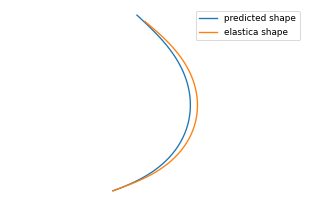


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

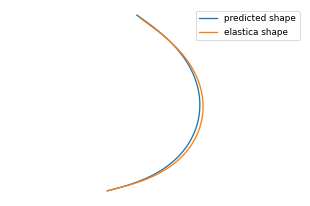


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

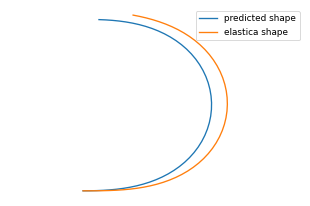


0: 480x640 2 LDOs, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

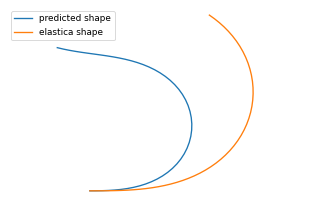


0: 480x640 1 LDO, 8.7ms
Speed: 1.2ms preprocess, 8.7ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

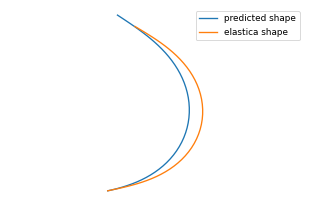


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

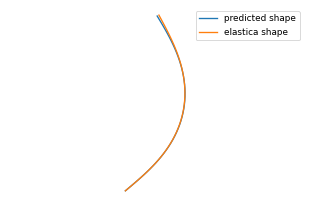


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

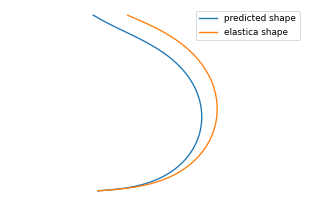


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

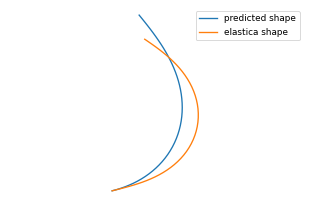


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

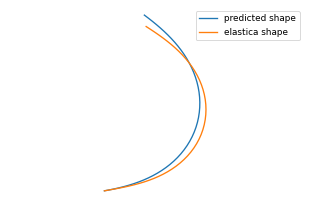


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

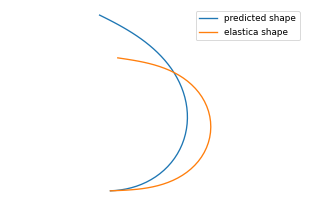


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

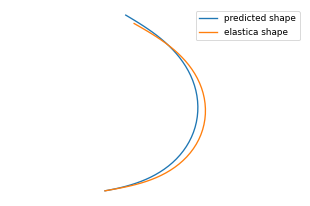

total time: 201.70209527015686


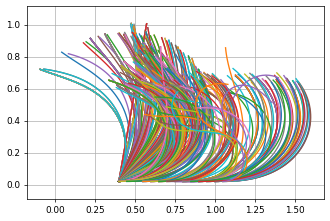


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

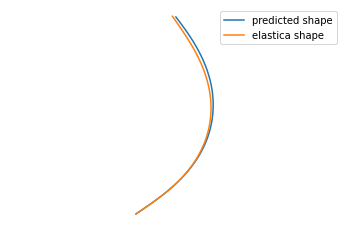


0: 480x640 1 LDO, 10.3ms
Speed: 1.1ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

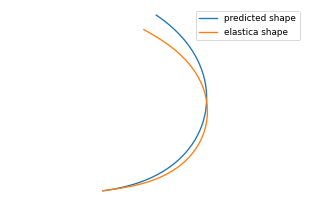


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

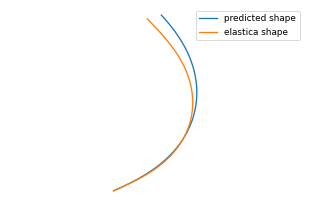


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

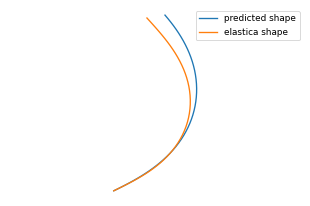


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

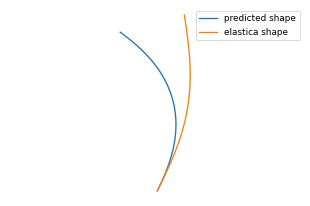


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

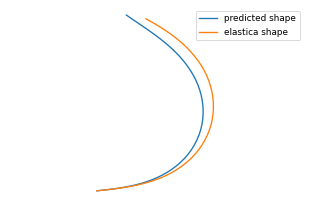


0: 480x640 1 LDO, 9.3ms
Speed: 1.4ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

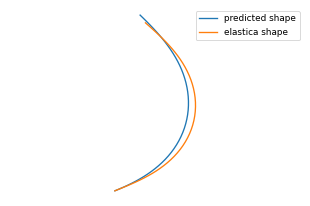


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

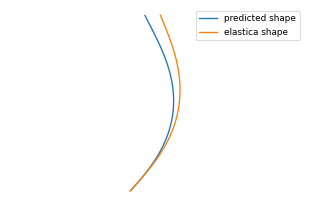


0: 480x640 1 LDO, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

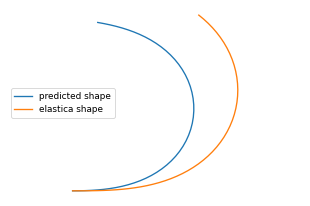


0: 480x640 1 LDO, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

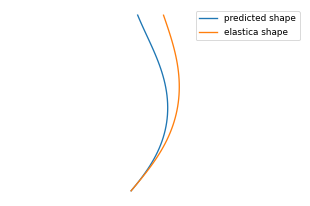


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

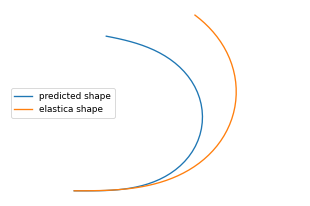


0: 480x640 1 LDO, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

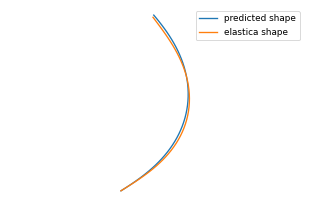


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

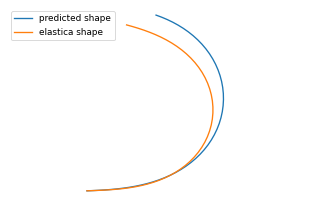


0: 480x640 1 LDO, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

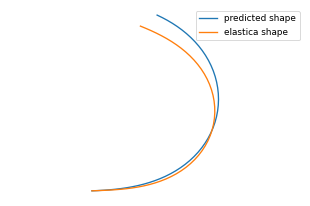


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

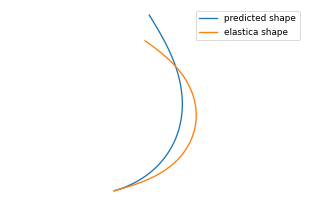


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

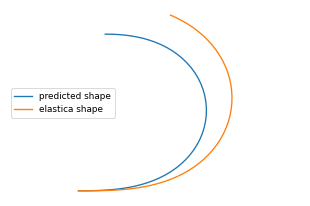


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

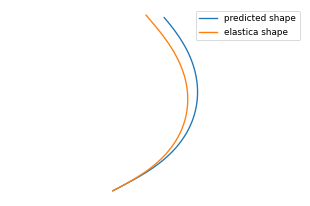


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

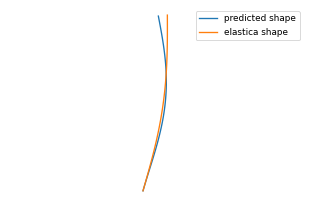


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

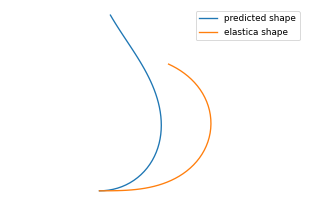


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

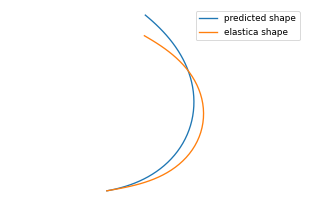


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

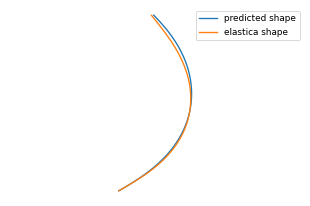


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

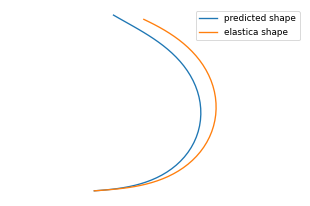


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

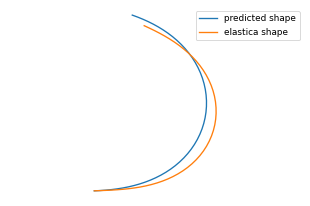


0: 480x640 1 LDO, 9.1ms
Speed: 1.3ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

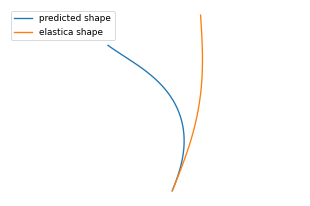


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

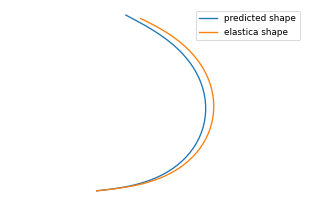


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

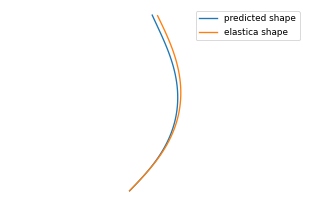


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

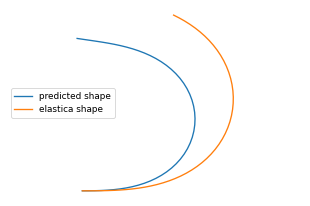


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

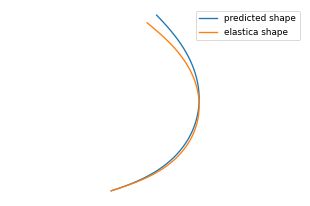


0: 480x640 1 LDO, 9.4ms
Speed: 2.6ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

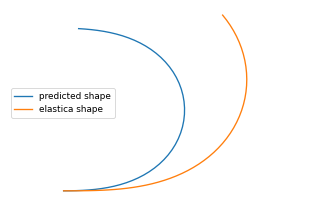


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

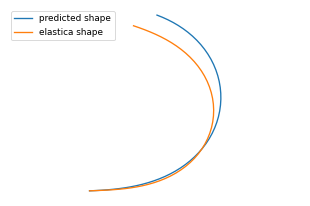


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

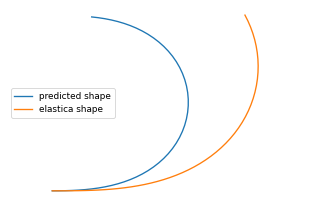


0: 480x640 1 LDO, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

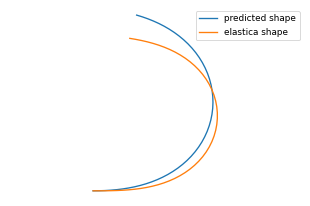


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

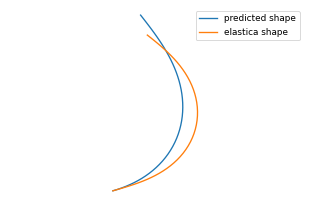


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

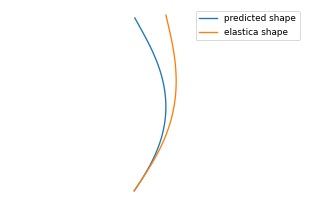


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

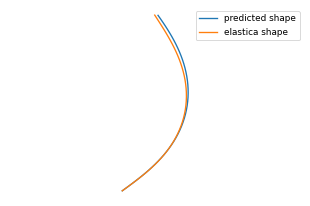


0: 480x640 1 LDO, 8.8ms
Speed: 1.3ms preprocess, 8.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

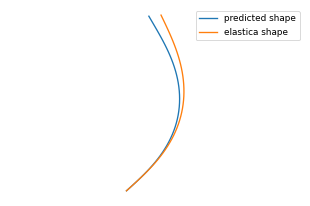


0: 480x640 1 LDO, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

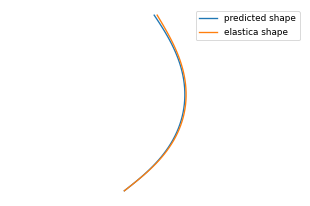


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

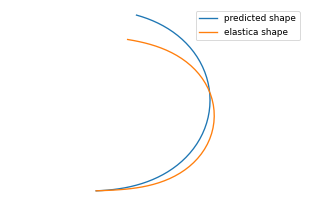


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

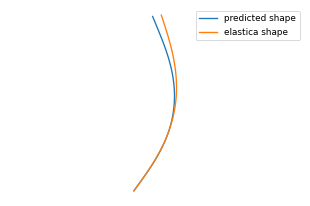


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

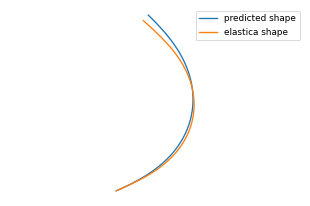


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

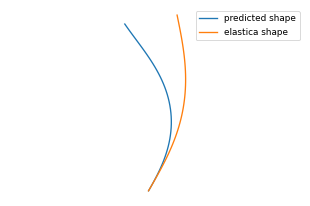


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

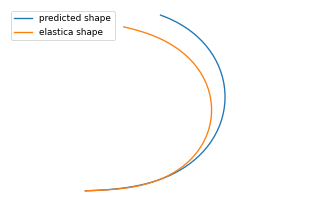


0: 480x640 1 LDO, 9.2ms
Speed: 1.2ms preprocess, 9.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

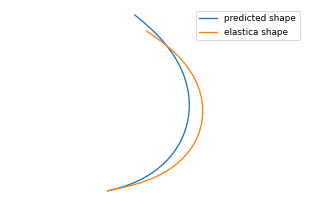


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

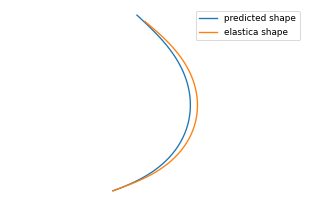


0: 480x640 1 LDO, 8.7ms
Speed: 1.1ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

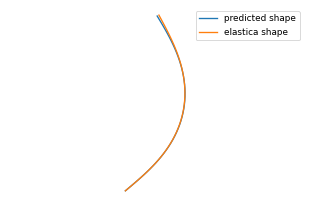


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

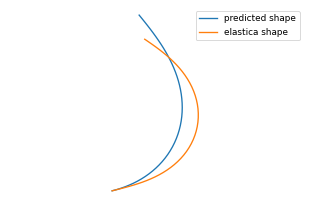


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

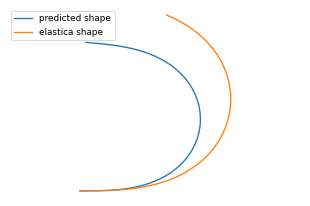


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

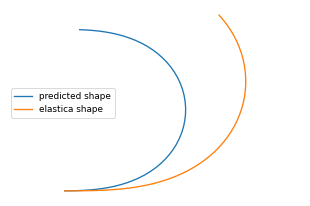


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

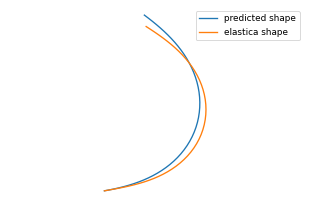

total time: 217.53828024864197


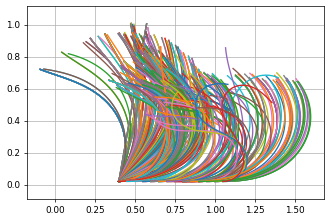


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

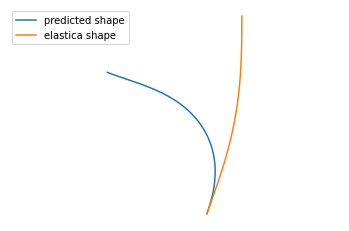


0: 480x640 1 LDO, 10.6ms
Speed: 1.7ms preprocess, 10.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

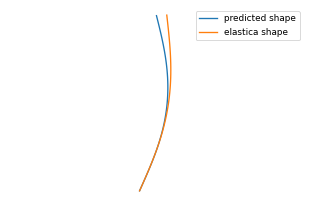


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

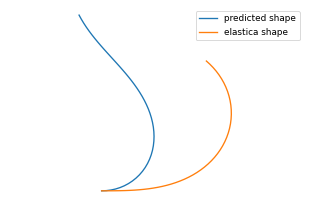


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

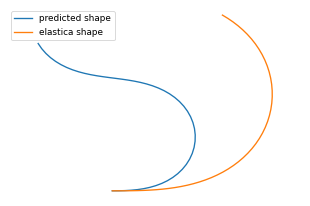


0: 480x640 1 LDO, 8.9ms
Speed: 1.5ms preprocess, 8.9ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

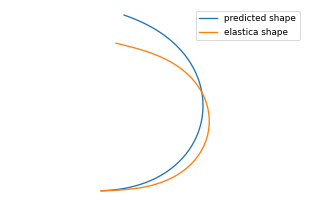


0: 480x640 1 LDO, 8.9ms
Speed: 1.4ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

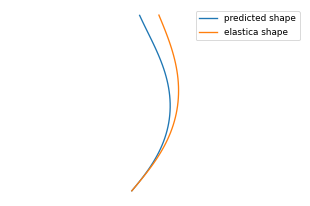


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

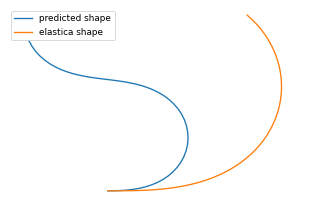


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

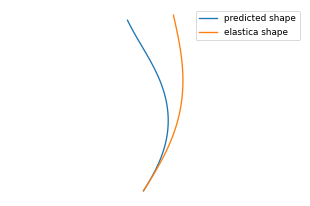


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

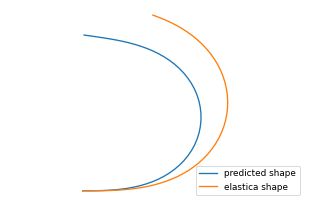


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

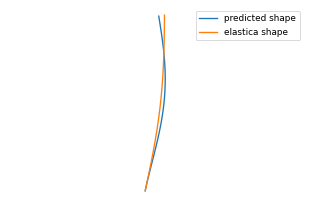


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

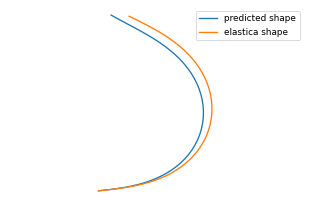


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

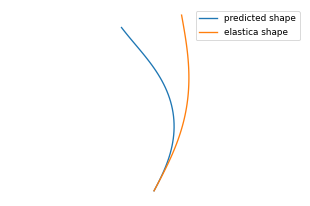


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

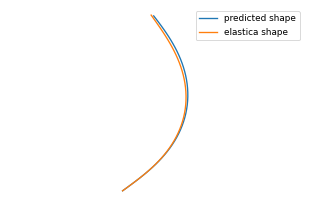


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

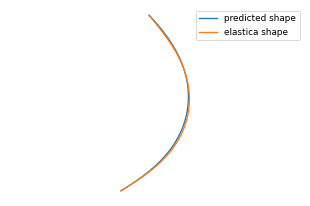


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

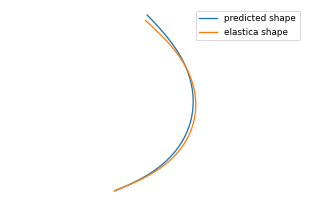


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

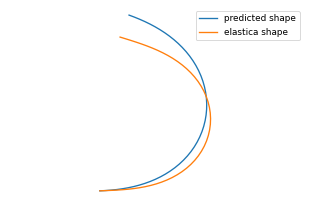


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

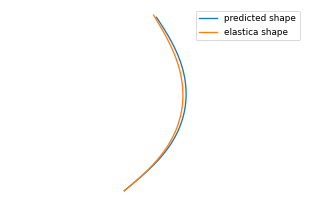


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

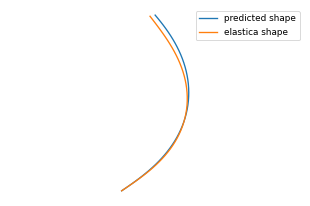


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

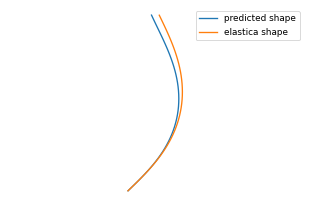


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

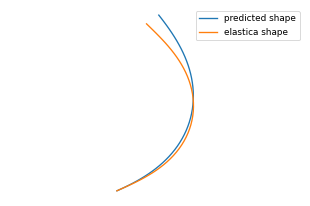


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

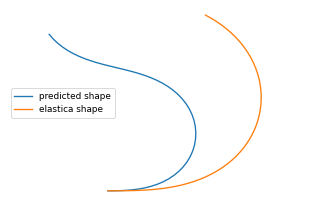


0: 480x640 2 LDOs, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

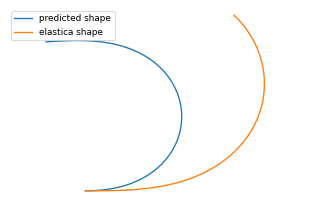


0: 480x640 1 LDO, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

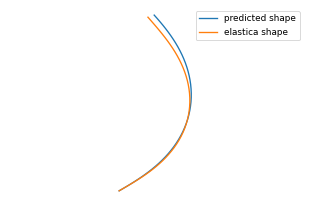


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

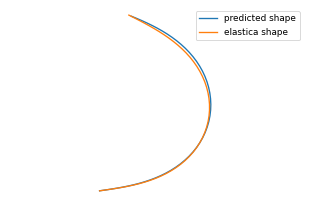


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

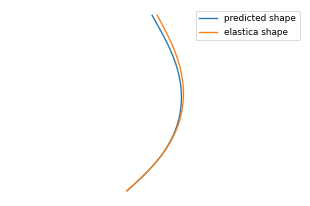


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

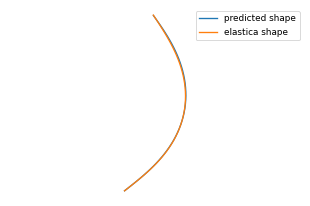


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

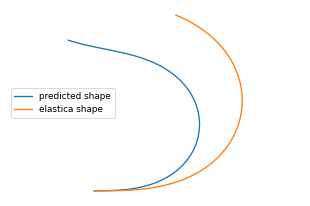


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

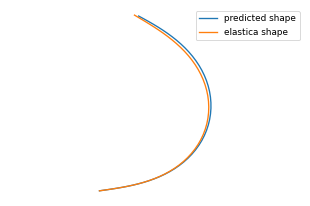


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

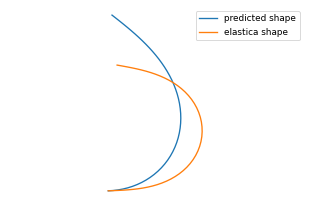


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

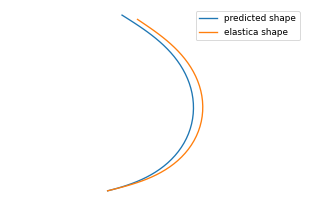


0: 480x640 1 LDO, 8.7ms
Speed: 1.0ms preprocess, 8.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

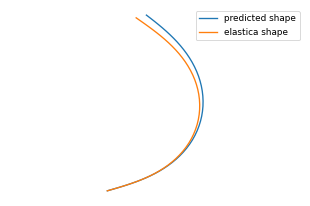


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

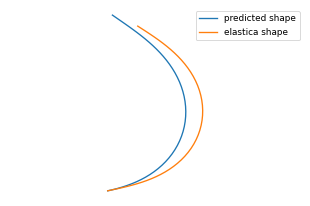


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

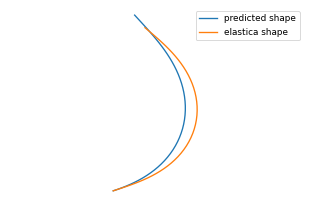


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

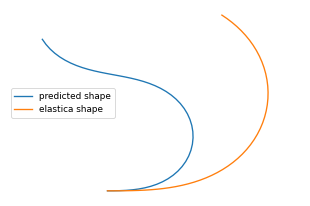


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

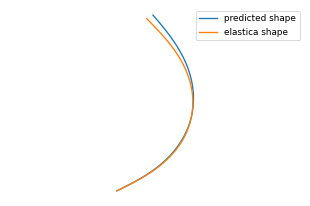


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

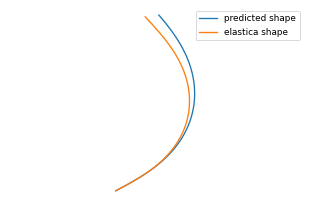


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

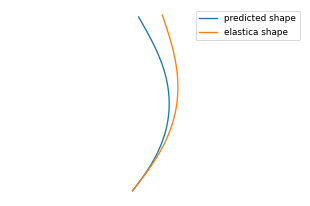


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

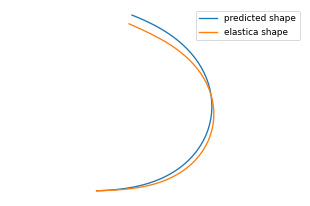


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

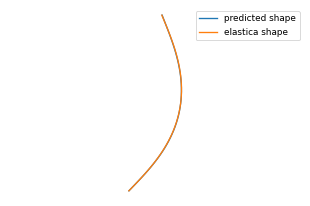


0: 480x640 1 LDO, 10.1ms
Speed: 1.6ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

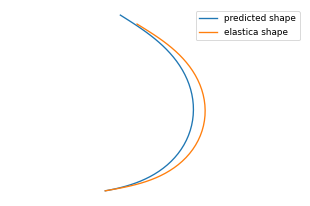


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

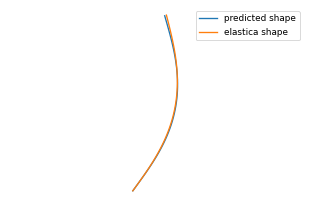


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

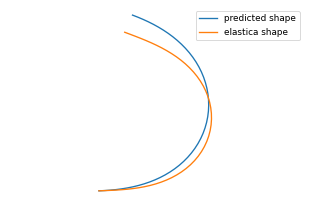


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

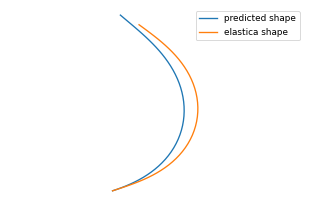


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

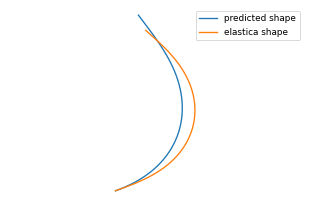


0: 480x640 1 LDO, 9.3ms
Speed: 1.5ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

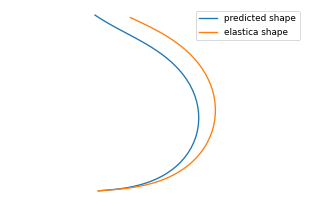

total time: 232.29221558570862


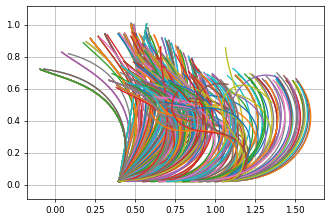


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

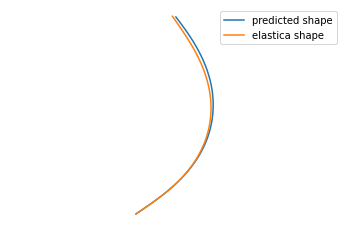


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

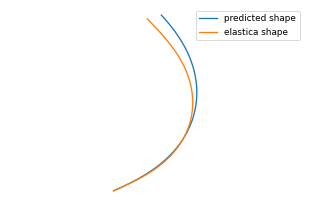


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

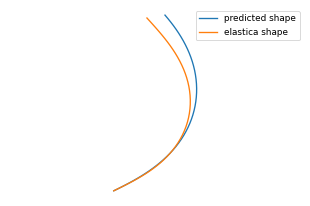


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

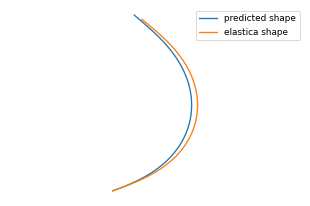


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

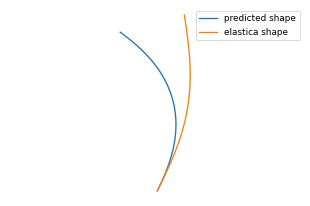


0: 480x640 2 LDOs, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

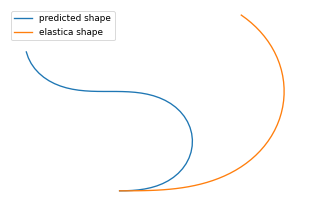


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

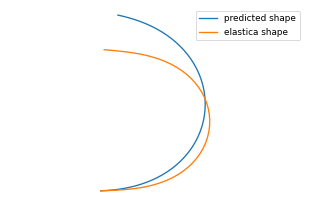


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

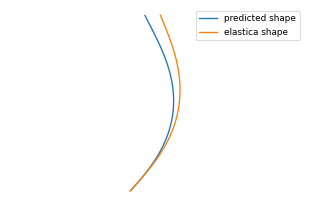


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

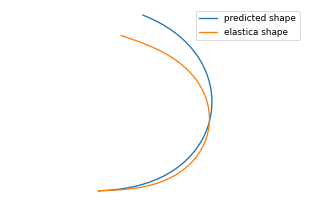


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

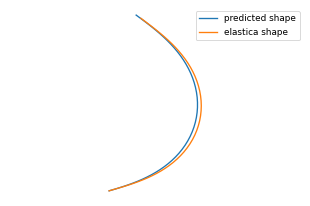


0: 480x640 2 LDOs, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

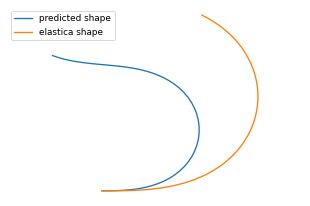


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

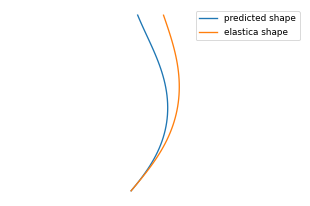


0: 480x640 1 LDO, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

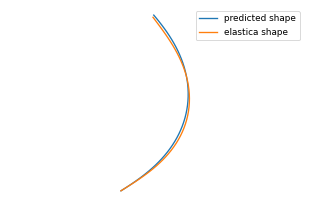


0: 480x640 1 LDO, 9.1ms
Speed: 1.2ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

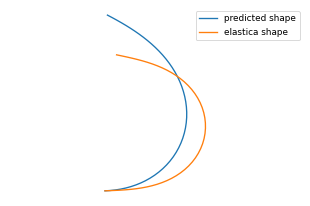


0: 480x640 1 LDO, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

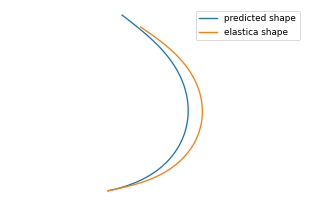


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

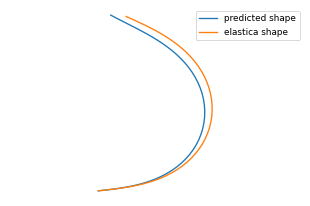


0: 480x640 1 LDO, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

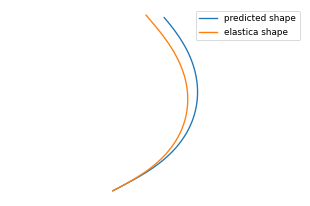


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

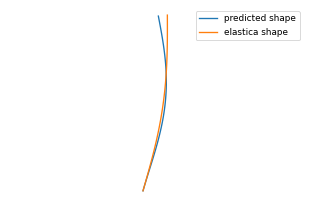


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

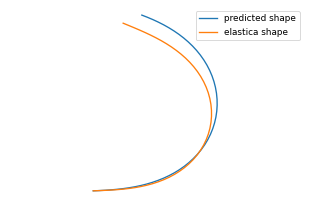


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

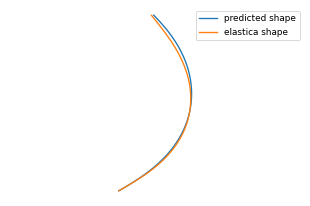


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

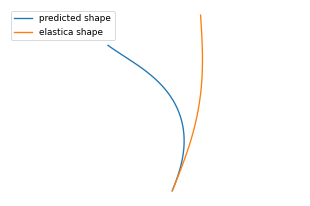


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

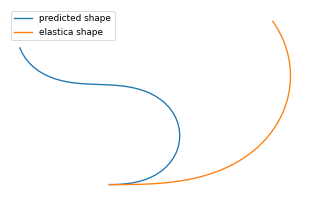


0: 480x640 1 LDO, 8.7ms
Speed: 1.3ms preprocess, 8.7ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

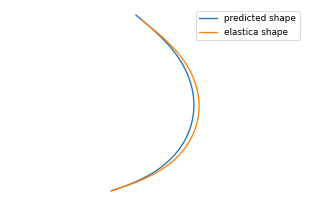


0: 480x640 2 LDOs, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

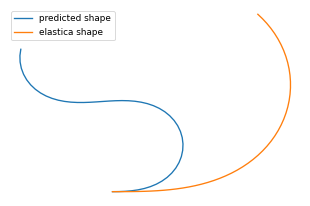


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

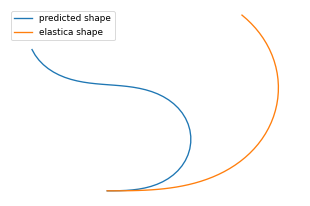


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

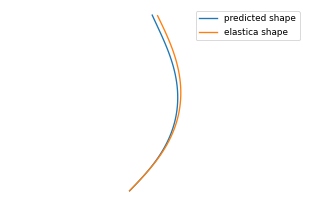


0: 480x640 1 LDO, 8.6ms
Speed: 1.9ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

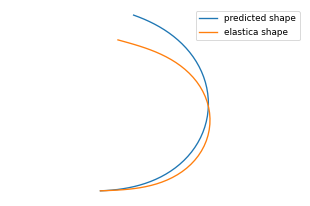


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

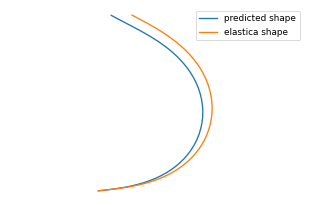


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

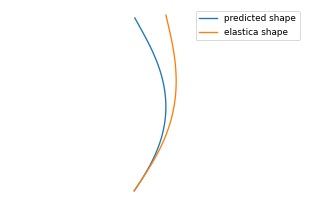


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

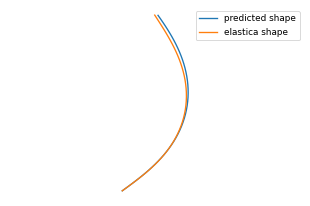


0: 480x640 1 LDO, 8.7ms
Speed: 1.6ms preprocess, 8.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

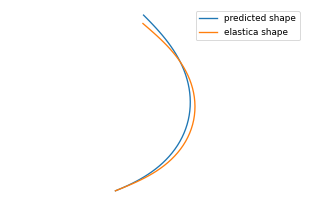


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

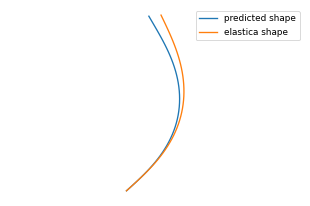


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

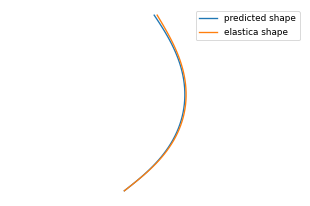


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

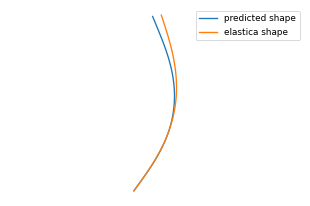


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

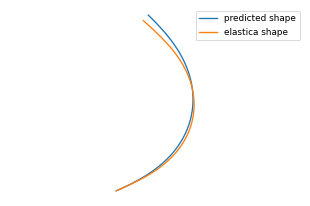


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

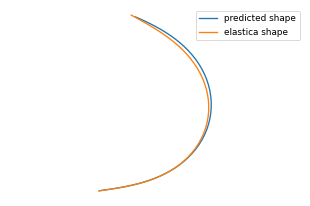


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

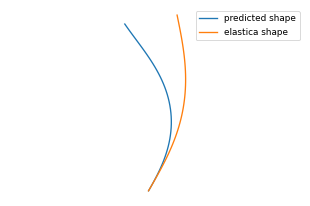


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

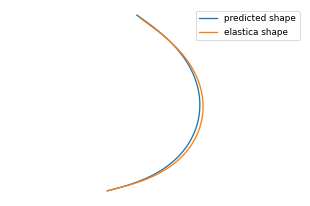


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

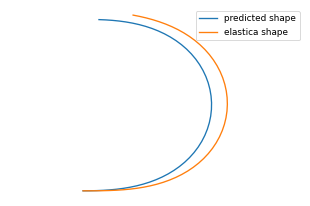


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

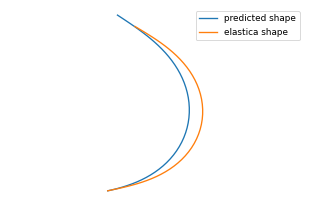


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

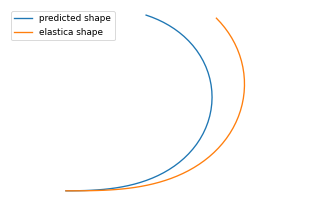


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

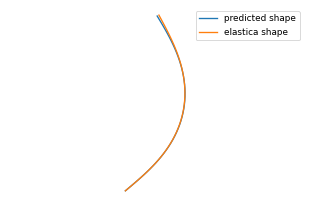


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

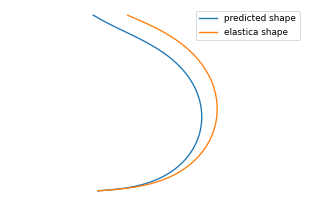


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

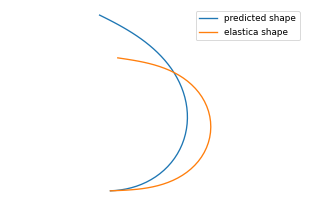


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

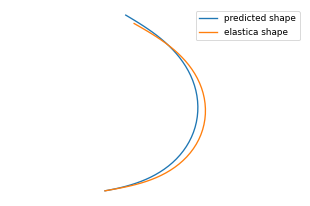

total time: 246.9784791469574


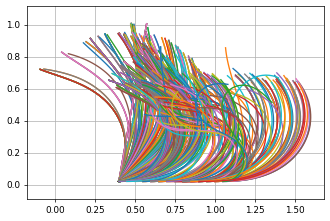


0: 480x640 1 LDO, 10.3ms
Speed: 1.1ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

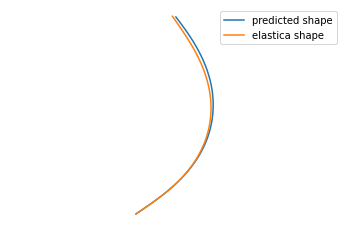


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

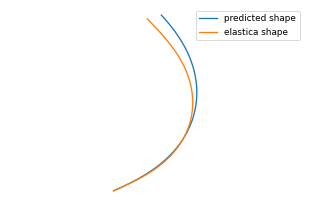


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

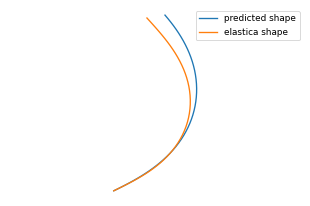


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

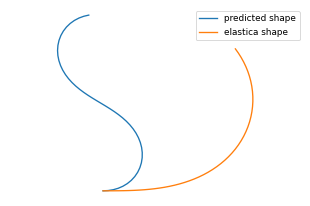


0: 480x640 1 LDO, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

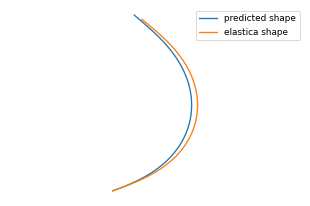


0: 480x640 1 LDO, 8.9ms
Speed: 1.4ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

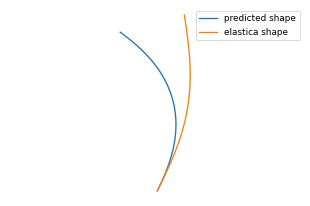


0: 480x640 2 LDOs, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

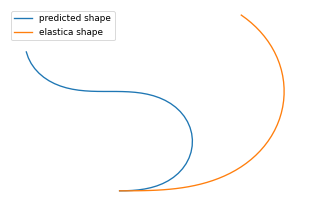


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

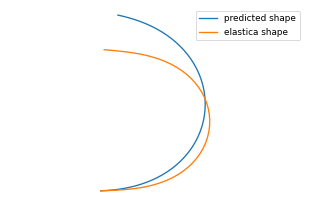


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

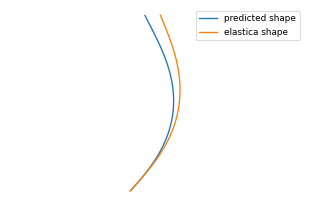


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

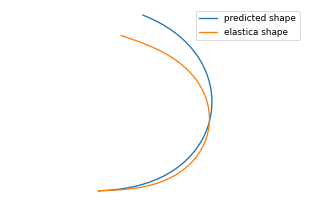


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

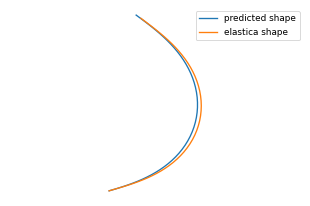


0: 480x640 2 LDOs, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

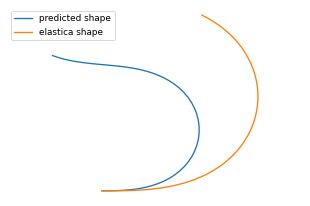


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

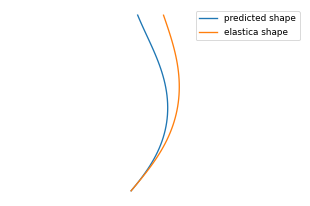


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

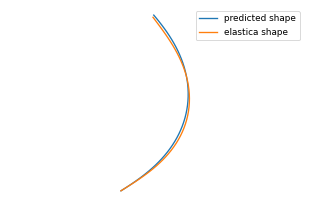


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

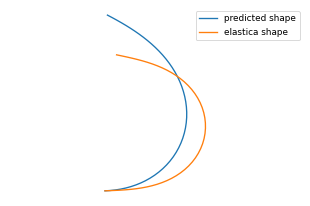


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

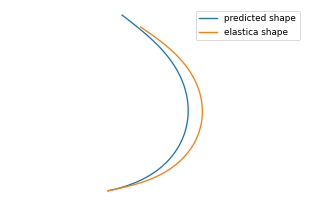


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

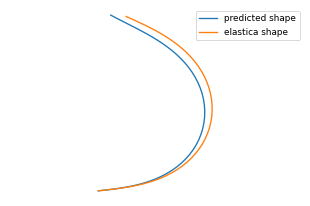


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

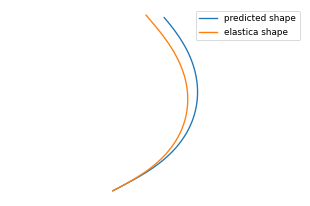


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

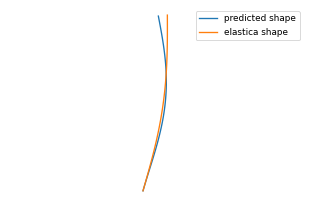


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

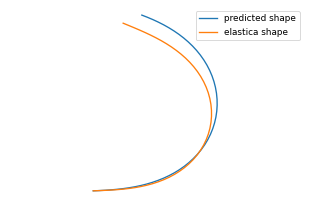


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

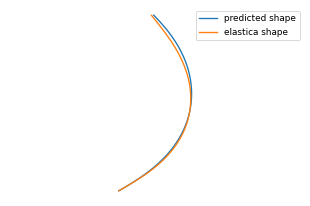


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

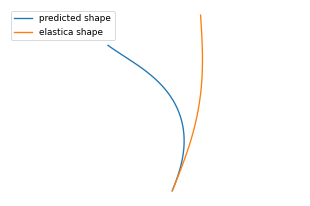


0: 480x640 1 LDO, 8.7ms
Speed: 1.3ms preprocess, 8.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

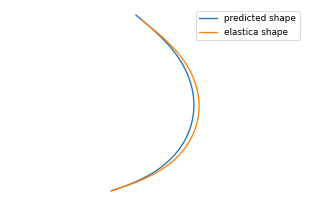


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

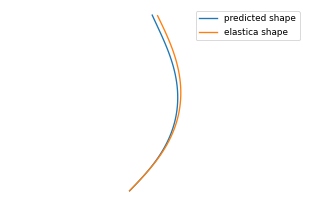


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

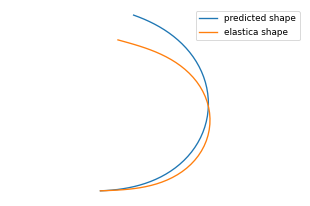


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

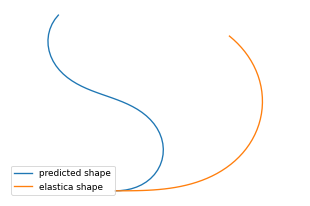


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

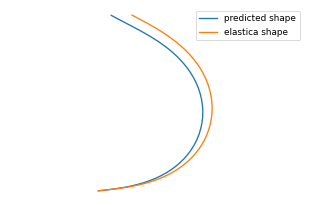


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

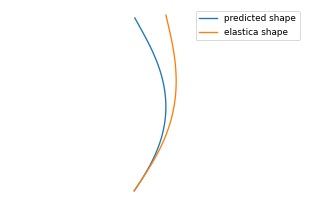


0: 480x640 1 LDO, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

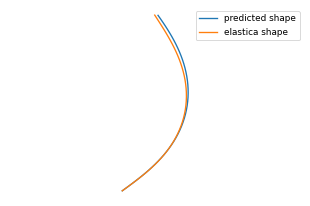


0: 480x640 1 LDO, 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

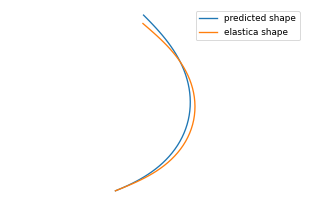


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

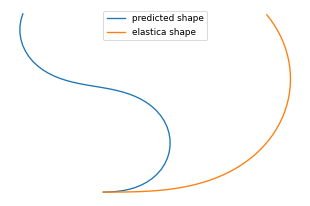


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

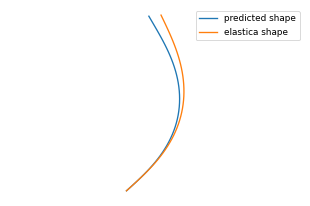


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

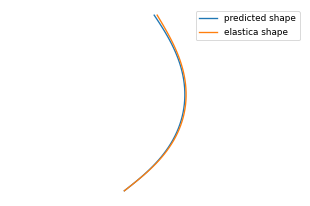


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

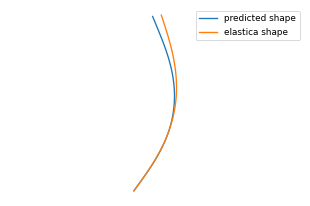


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

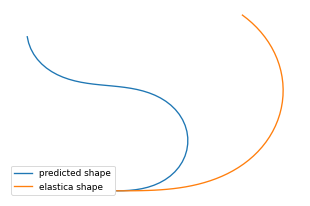


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

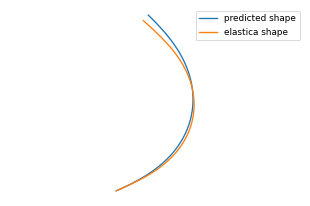


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

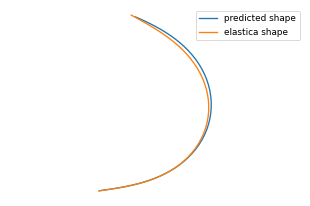


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

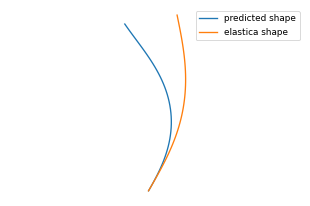


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

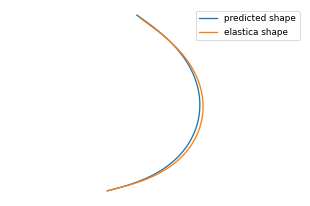


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

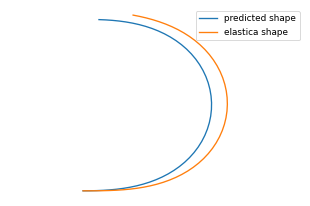


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

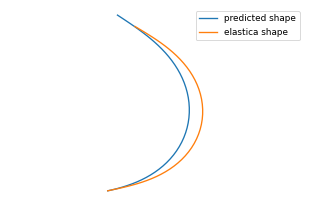


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

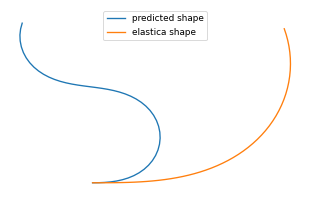


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

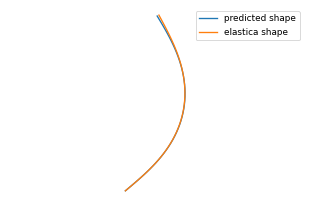


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

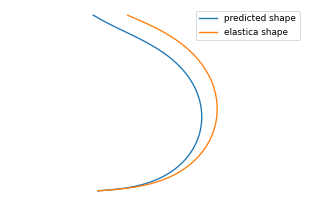


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

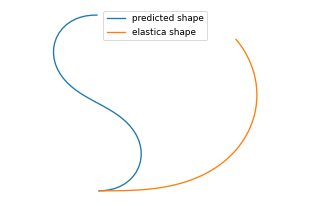


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

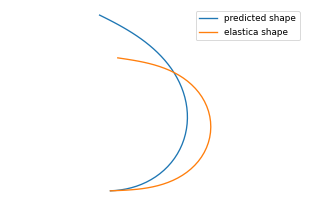


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

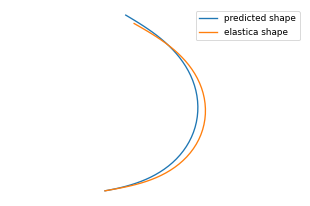

total time: 262.46406173706055


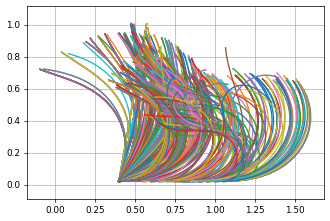


0: 480x640 1 LDO, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

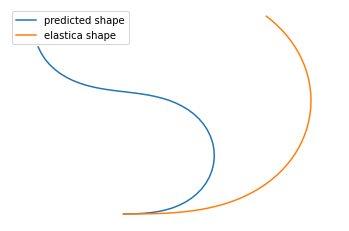


0: 480x640 1 LDO, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

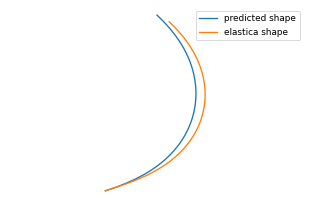


0: 480x640 1 LDO, 9.7ms
Speed: 1.4ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

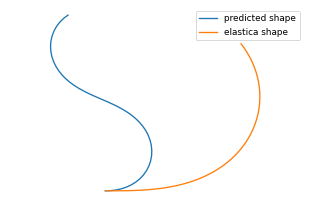


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

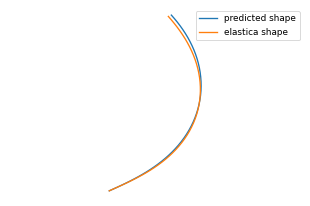


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

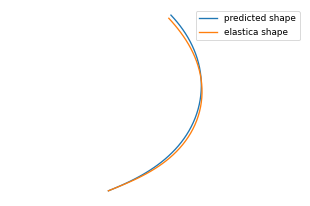


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

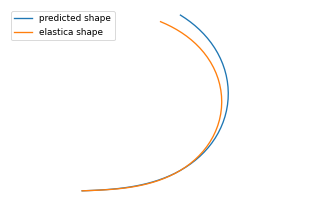


0: 480x640 1 LDO, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

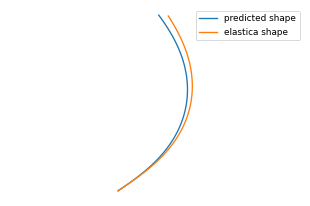


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

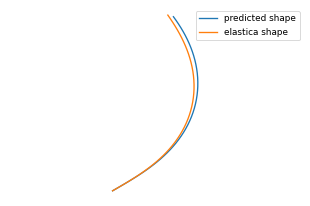


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

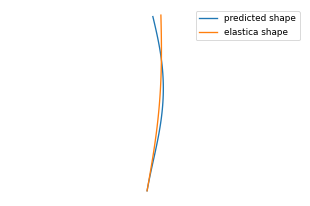


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

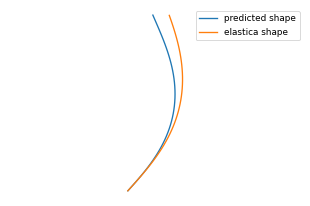


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

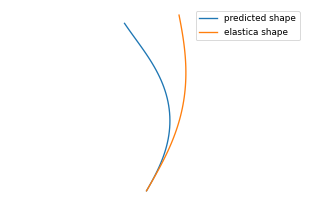


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

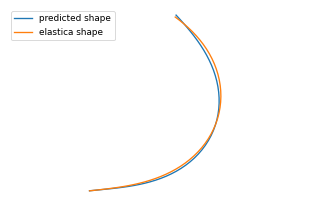


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

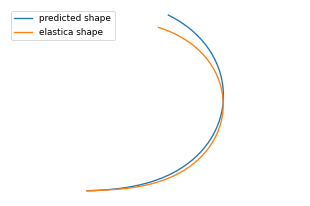


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

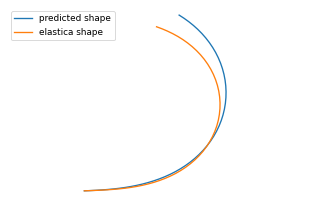


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

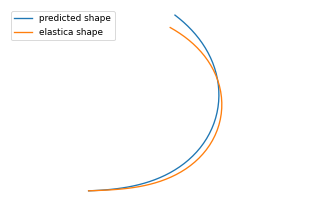


0: 480x640 1 LDO, 10.1ms
Speed: 1.1ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

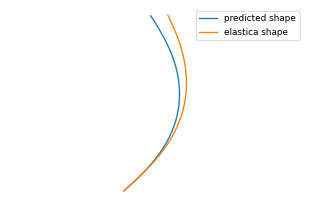


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

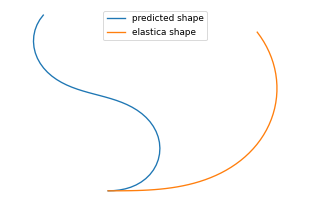


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

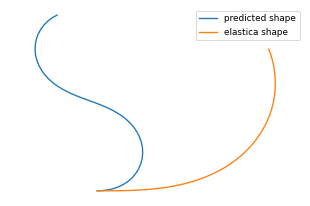


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

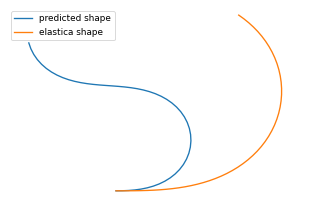


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

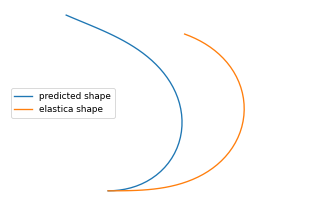


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

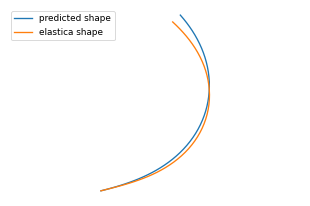


0: 480x640 1 LDO, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

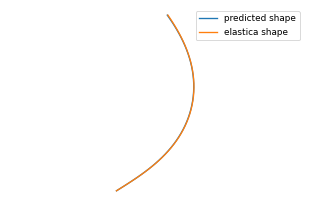


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

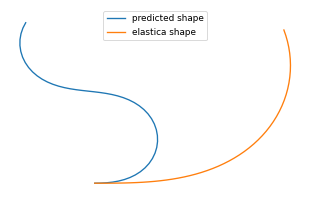


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

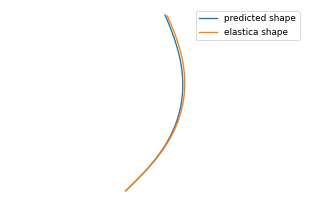


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

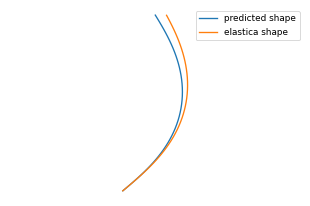


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

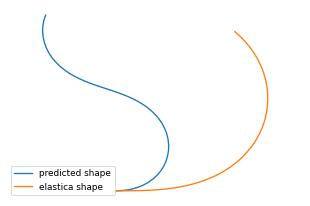


0: 480x640 1 LDO, 8.6ms
Speed: 2.0ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

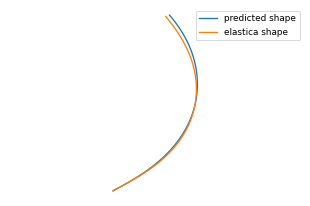


0: 480x640 1 LDO, 9.2ms
Speed: 1.3ms preprocess, 9.2ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

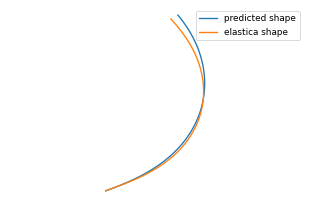


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

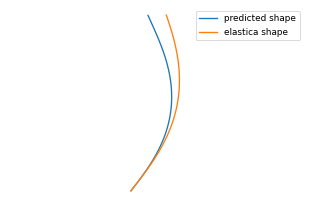


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

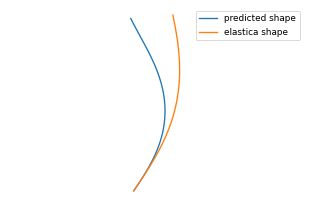


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

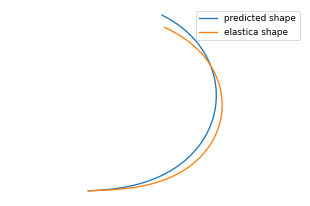


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

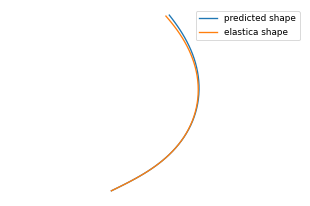


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

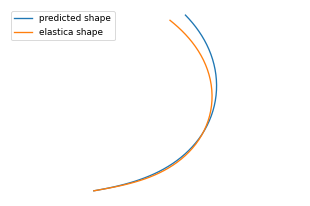


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

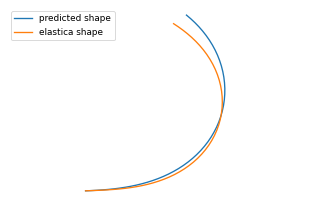


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

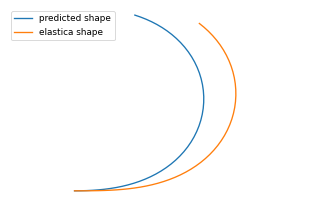


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

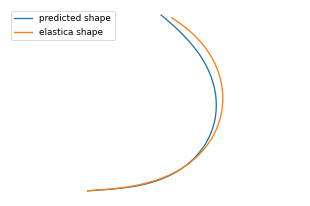


0: 480x640 2 LDOs, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

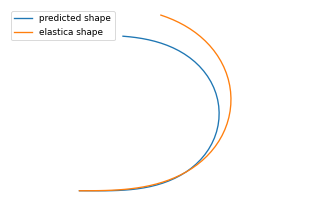


0: 480x640 1 LDO, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

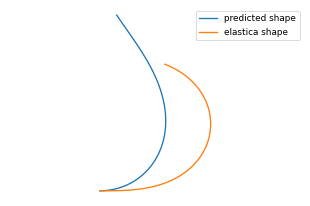


0: 480x640 1 LDO, 8.9ms
Speed: 1.2ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

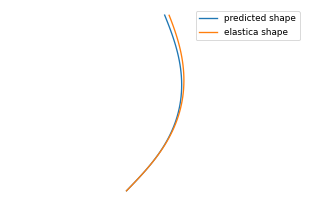


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

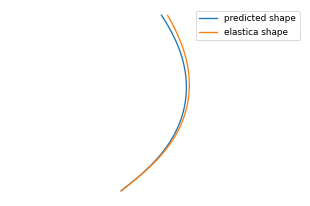


0: 480x640 1 LDO, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

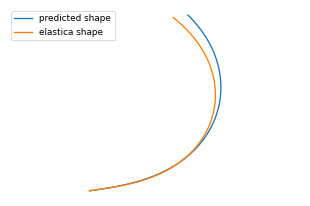


0: 480x640 1 LDO, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

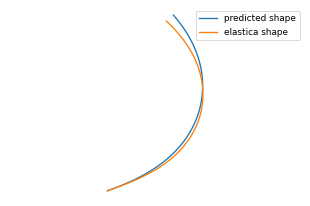


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

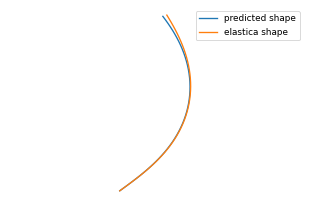


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

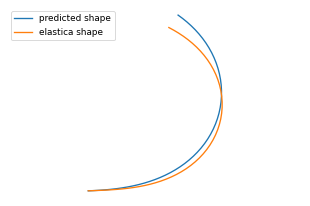


0: 480x640 2 LDOs, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

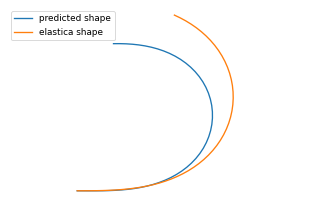


0: 480x640 1 LDO, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

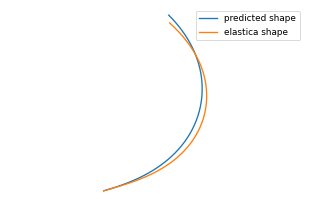


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

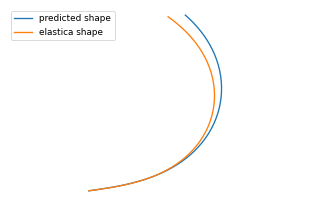


0: 480x640 2 LDOs, 9.2ms
Speed: 1.0ms preprocess, 9.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

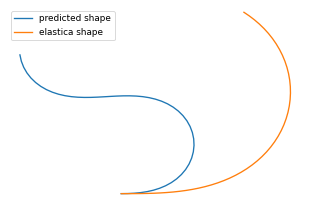


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

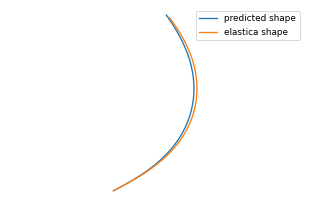


0: 480x640 1 LDO, 9.5ms
Speed: 1.5ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

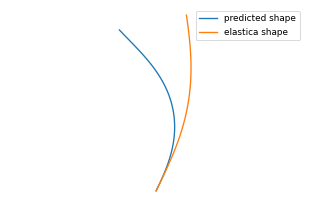


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

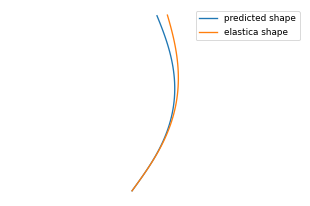


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

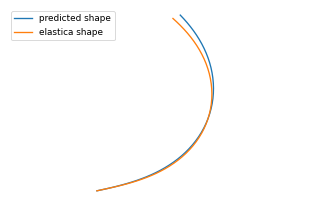


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

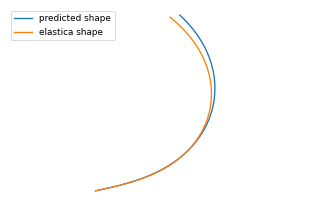


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

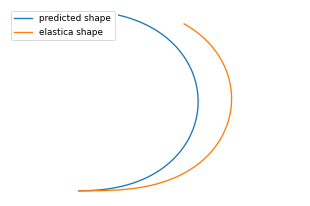


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

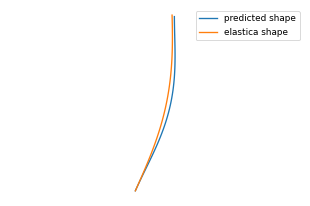


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

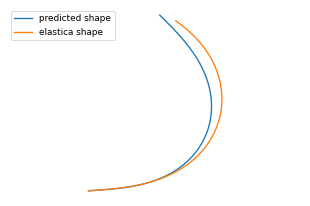


0: 480x640 1 LDO, 9.1ms
Speed: 1.1ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

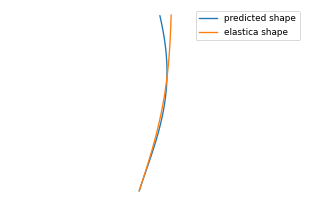

total time: 281.17764115333557


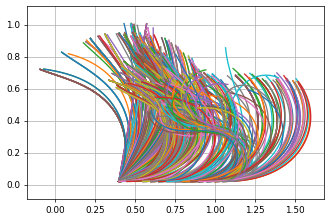


0: 480x640 1 LDO, 9.4ms
Speed: 1.5ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

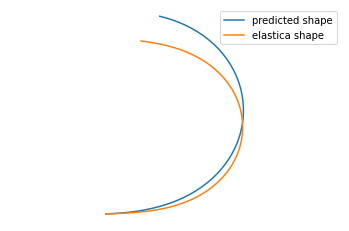


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

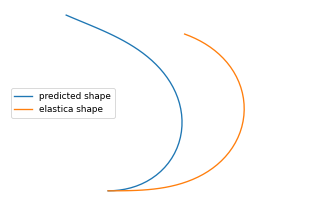


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

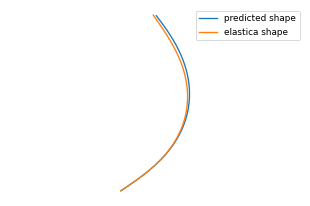


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

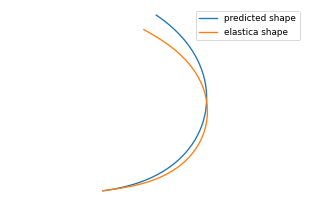


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

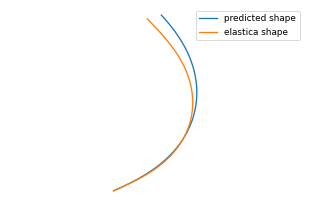


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

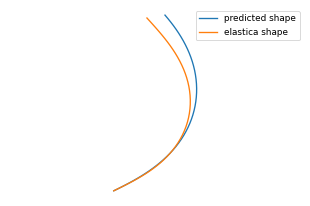


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

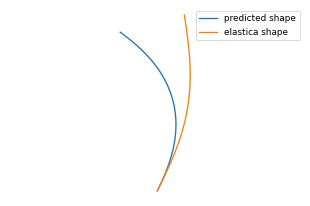


0: 480x640 2 LDOs, 10.0ms
Speed: 1.8ms preprocess, 10.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

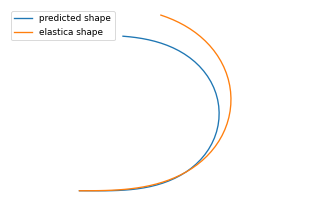


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

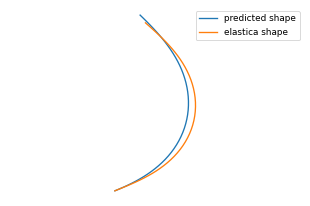


0: 480x640 1 LDO, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

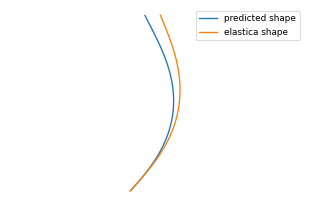


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

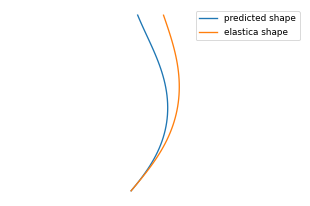


0: 480x640 1 LDO, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

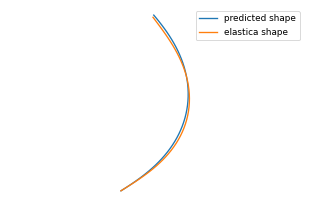


0: 480x640 1 LDO, 10.0ms
Speed: 1.2ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

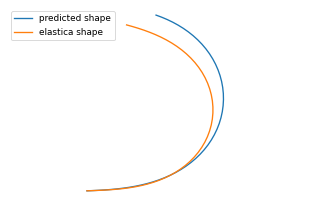


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

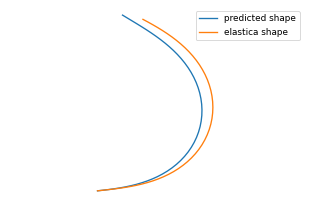


0: 480x640 1 LDO, 9.0ms
Speed: 1.2ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

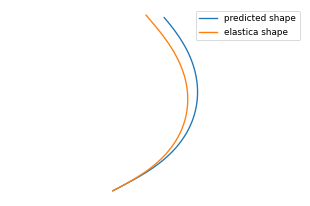


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

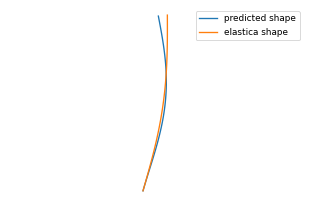


0: 480x640 2 LDOs, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

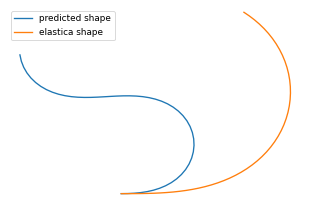


0: 480x640 1 LDO, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

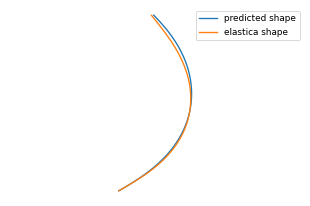


0: 480x640 1 LDO, 8.9ms
Speed: 1.1ms preprocess, 8.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

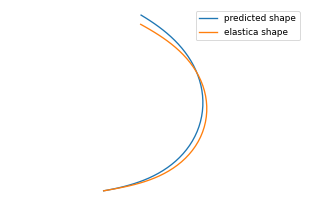


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

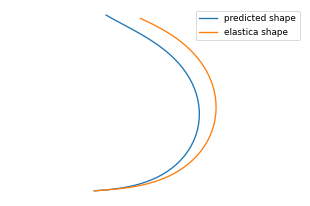


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

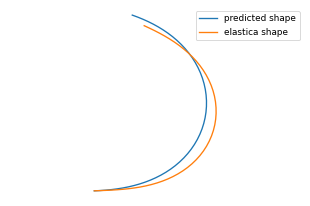


0: 480x640 1 LDO, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

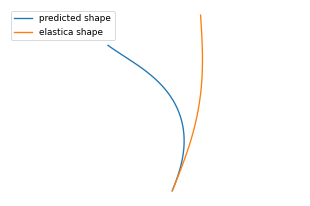


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

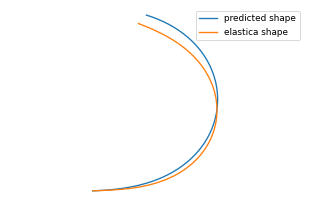


0: 480x640 1 LDO, 9.7ms
Speed: 1.1ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

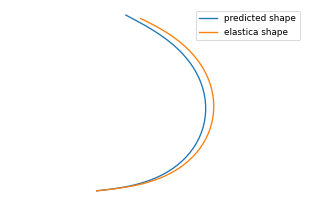


0: 480x640 2 LDOs, 9.1ms
Speed: 1.1ms preprocess, 9.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

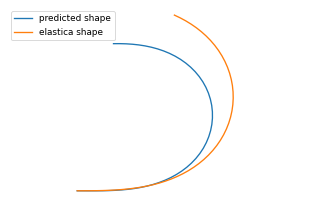


0: 480x640 1 LDO, 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

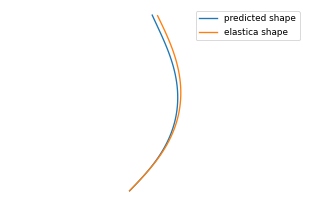


0: 480x640 1 LDO, 9.2ms
Speed: 1.3ms preprocess, 9.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

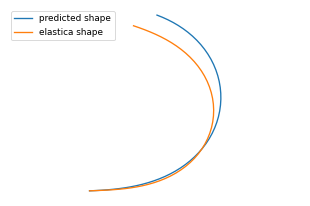


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

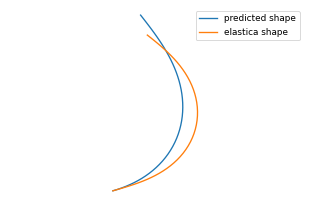


0: 480x640 1 LDO, 8.9ms
Speed: 1.0ms preprocess, 8.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

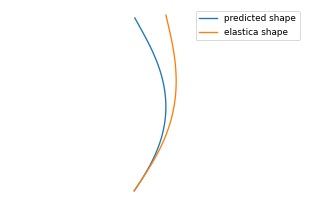


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

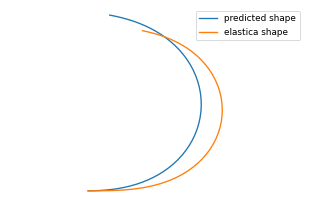


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

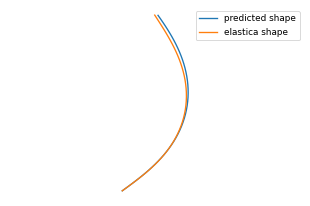


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

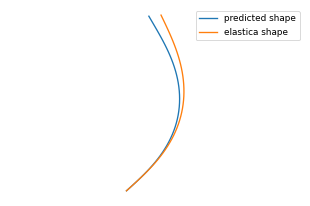


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

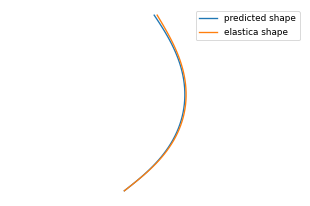


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

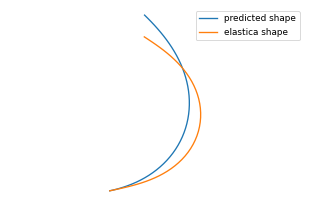


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

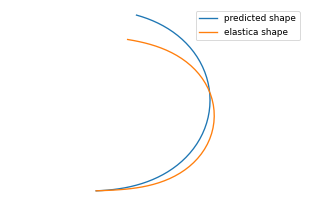


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

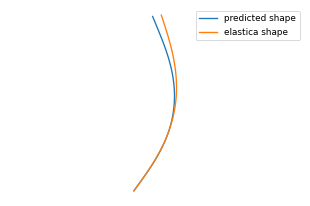


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

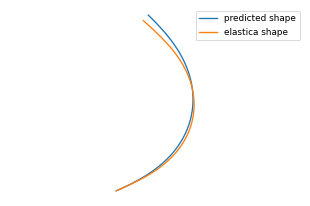


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

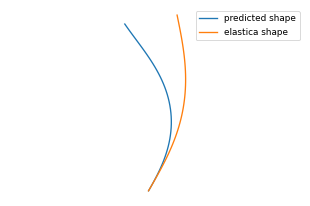


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

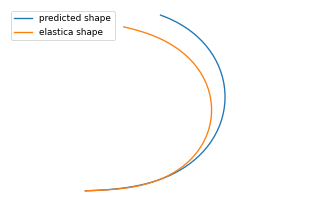


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

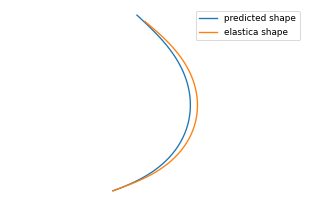


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

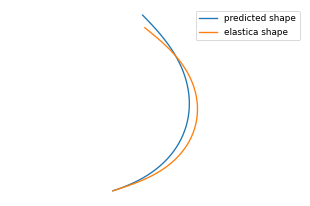


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

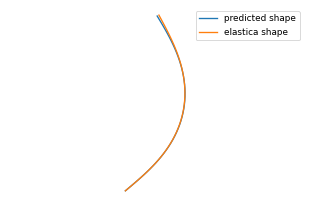


0: 480x640 1 LDO, 9.1ms
Speed: 1.5ms preprocess, 9.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

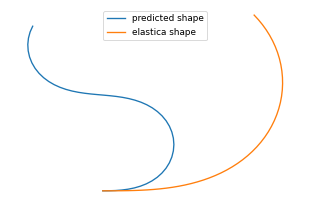


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

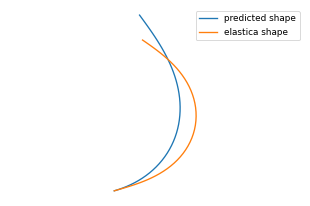


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

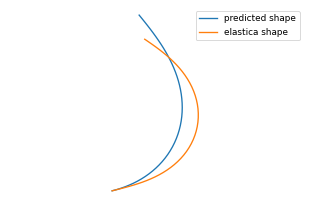


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

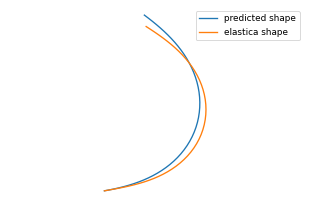

total time: 296.4425776004791


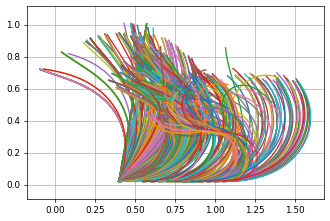


0: 480x640 1 LDO, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

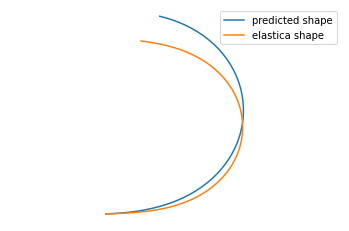


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

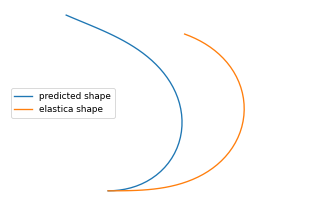


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

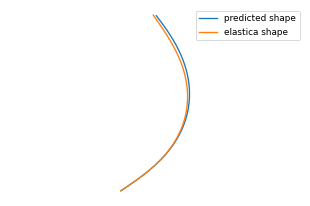


0: 480x640 1 LDO, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

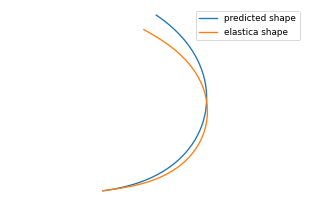


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

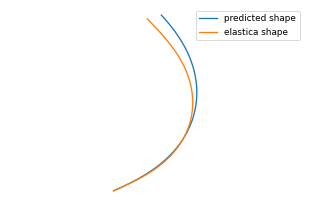


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

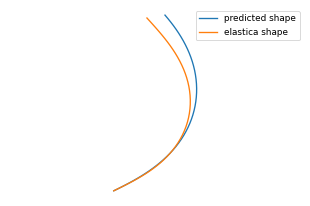


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

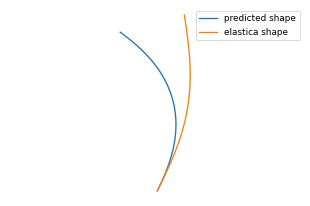


0: 480x640 2 LDOs, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

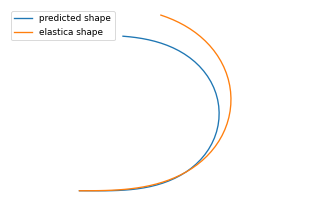


0: 480x640 1 LDO, 9.5ms
Speed: 1.4ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

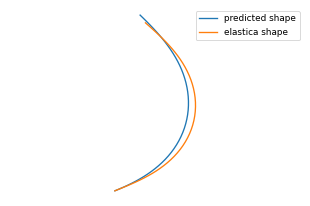


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

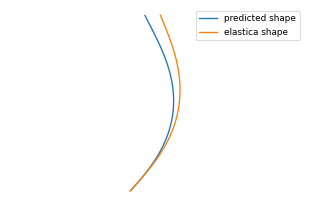


0: 480x640 1 LDO, 9.1ms
Speed: 1.4ms preprocess, 9.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

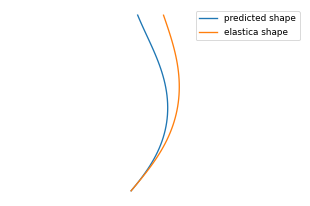


0: 480x640 1 LDO, 9.0ms
Speed: 1.3ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

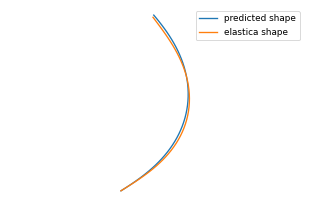


0: 480x640 1 LDO, 9.5ms
Speed: 1.3ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

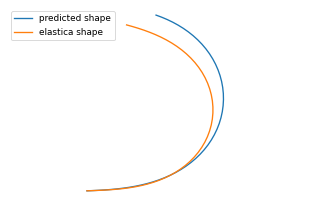


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

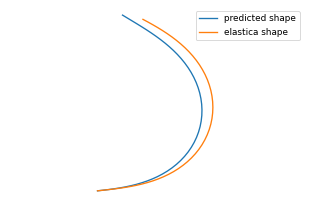


0: 480x640 1 LDO, 8.9ms
Speed: 2.0ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

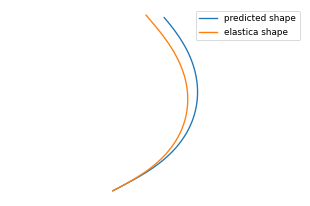


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

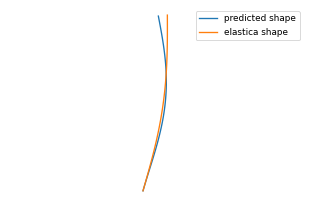


0: 480x640 2 LDOs, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

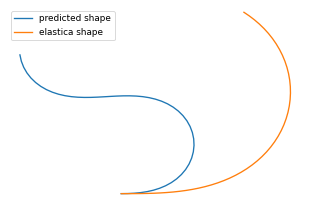


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

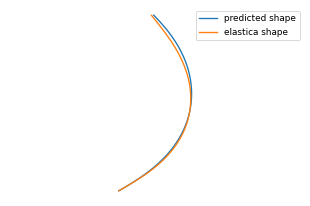


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

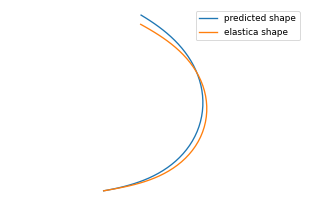


0: 480x640 1 LDO, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

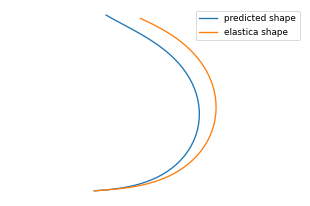


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

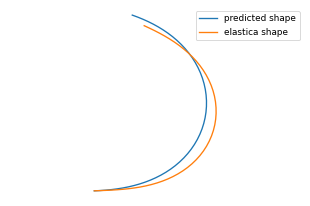


0: 480x640 1 LDO, 9.3ms
Speed: 1.3ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

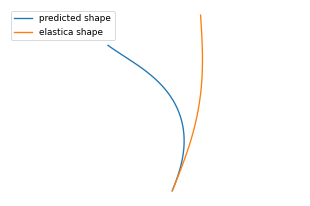


0: 480x640 1 LDO, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

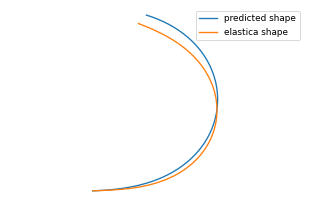


0: 480x640 1 LDO, 9.8ms
Speed: 1.0ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

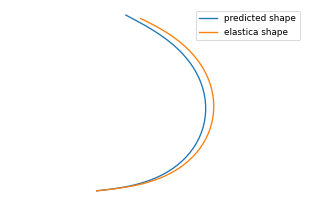


0: 480x640 2 LDOs, 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

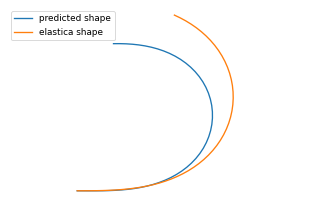


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

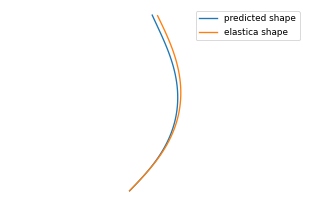


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

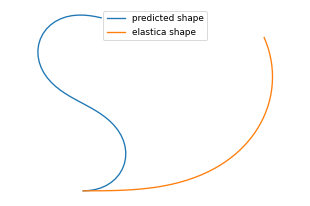


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

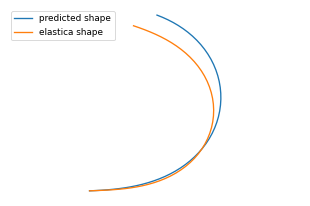


0: 480x640 1 LDO, 10.4ms
Speed: 1.0ms preprocess, 10.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

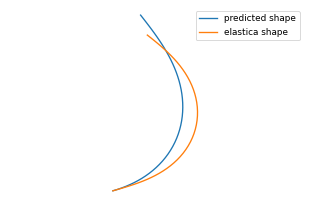


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

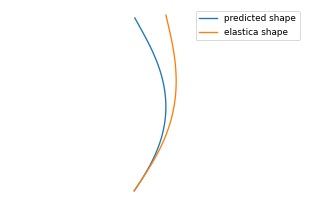


0: 480x640 1 LDO, 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

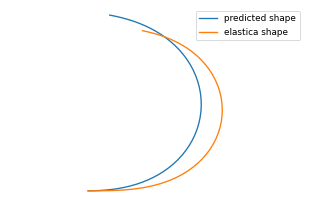


0: 480x640 1 LDO, 9.6ms
Speed: 1.1ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

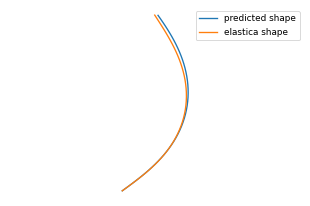


0: 480x640 1 LDO, 9.2ms
Speed: 1.4ms preprocess, 9.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

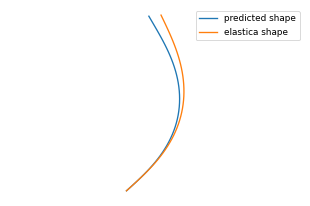


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

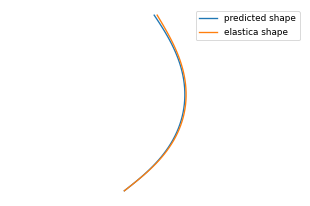


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

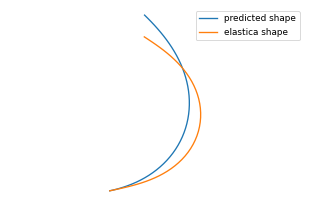


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

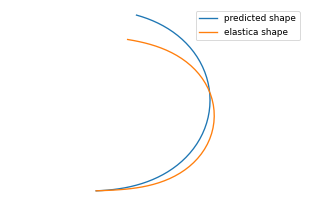


0: 480x640 1 LDO, 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

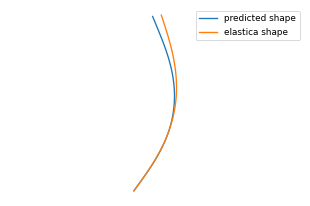


0: 480x640 1 LDO, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

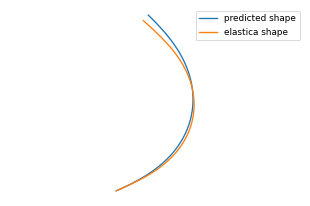


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

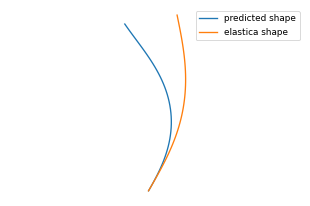


0: 480x640 1 LDO, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

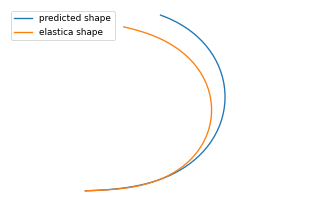


0: 480x640 1 LDO, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

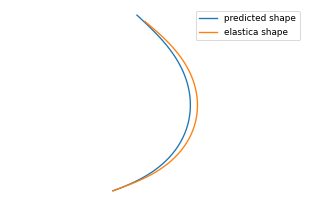


0: 480x640 1 LDO, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

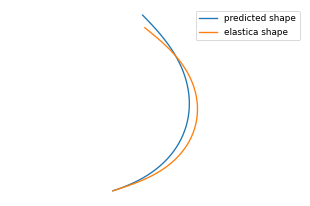


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

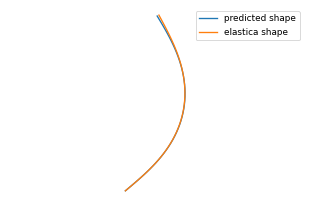


0: 480x640 1 LDO, 9.7ms
Speed: 1.5ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

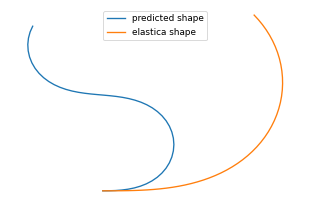


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

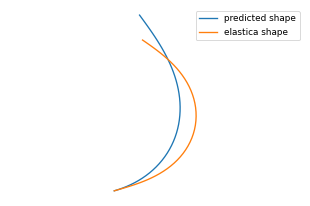


0: 480x640 1 LDO, 8.9ms
Speed: 1.2ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

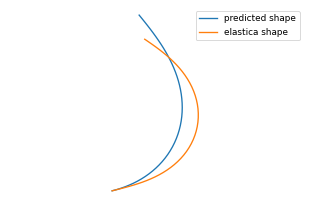


0: 480x640 1 LDO, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

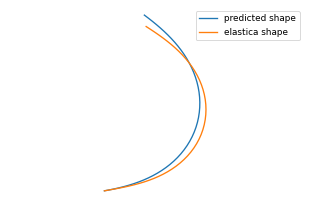

total time: 311.99995493888855


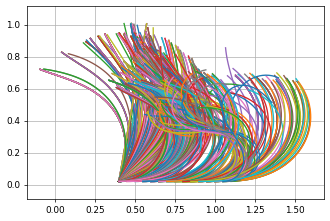


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

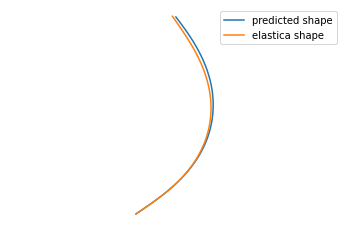


0: 480x640 1 LDO, 9.2ms
Speed: 1.2ms preprocess, 9.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

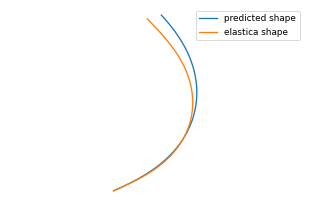


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

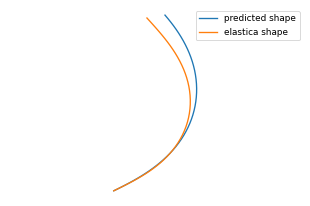


0: 480x640 2 LDOs, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

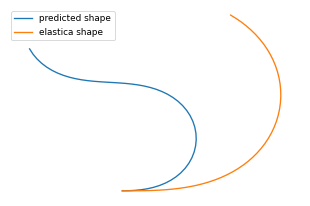


0: 480x640 1 LDO, 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

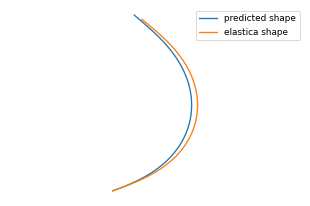


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

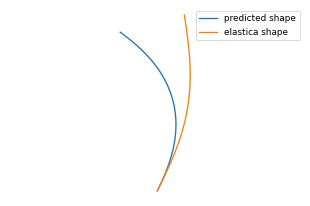


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

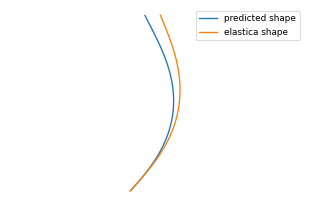


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

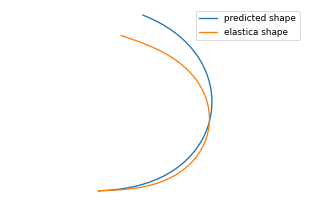


0: 480x640 1 LDO, 8.9ms
Speed: 1.2ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

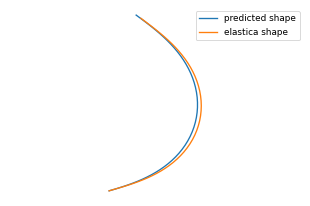


0: 480x640 1 LDO, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

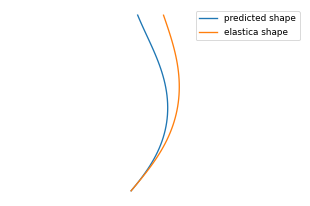


0: 480x640 1 LDO, 10.1ms
Speed: 1.2ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

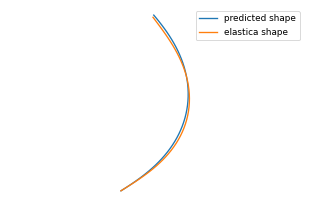


0: 480x640 1 LDO, 8.6ms
Speed: 1.2ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

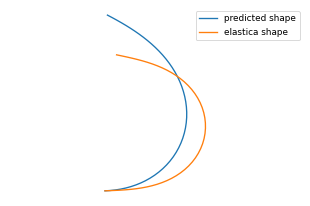


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

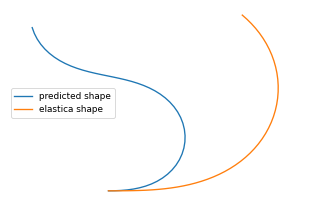


0: 480x640 1 LDO, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

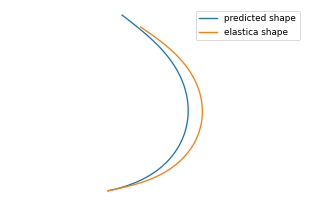


0: 480x640 1 LDO, 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

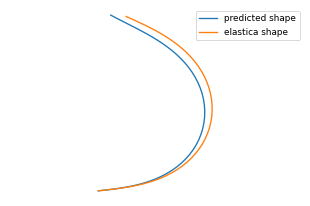


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

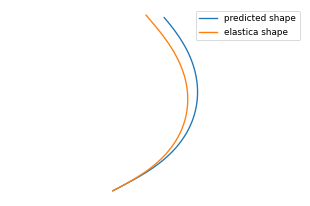


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

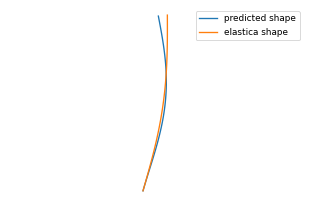


0: 480x640 1 LDO, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

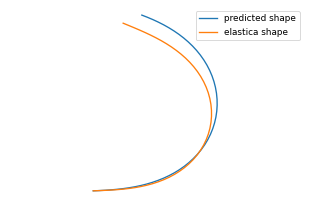


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

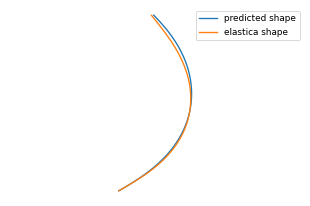


0: 480x640 1 LDO, 10.7ms
Speed: 1.3ms preprocess, 10.7ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

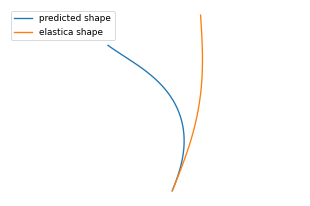


0: 480x640 1 LDO, 8.7ms
Speed: 1.7ms preprocess, 8.7ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

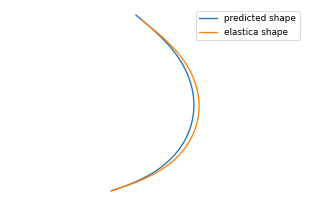


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

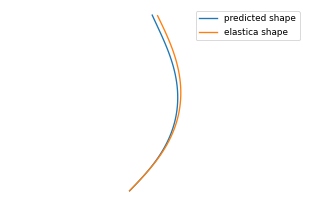


0: 480x640 1 LDO, 8.7ms
Speed: 1.4ms preprocess, 8.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

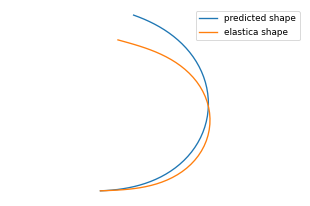


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

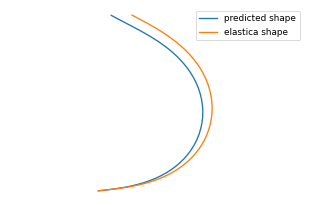


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

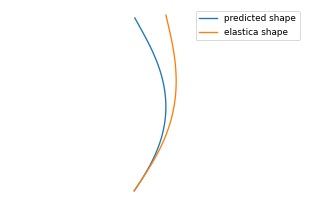


0: 480x640 2 LDOs, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

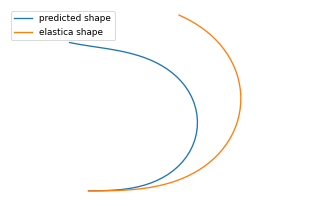


0: 480x640 1 LDO, 9.7ms
Speed: 1.2ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

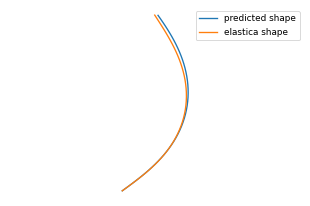


0: 480x640 1 LDO, 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

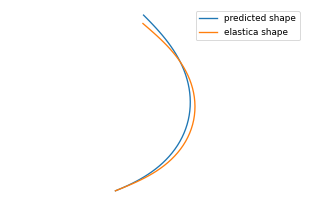


0: 480x640 1 LDO, 8.9ms
Speed: 1.2ms preprocess, 8.9ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

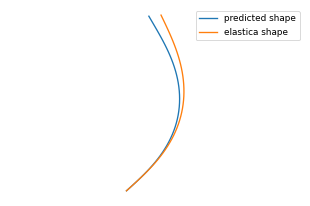


0: 480x640 1 LDO, 9.5ms
Speed: 1.1ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

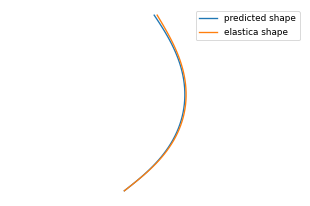


0: 480x640 1 LDO, 10.0ms
Speed: 1.0ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

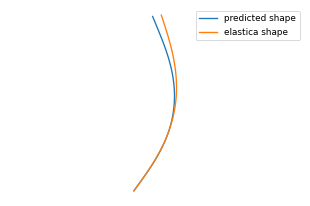


0: 480x640 1 LDO, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

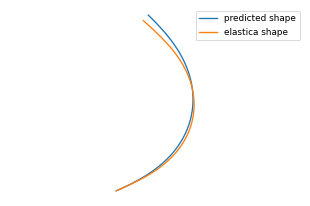


0: 480x640 1 LDO, 10.3ms
Speed: 1.2ms preprocess, 10.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

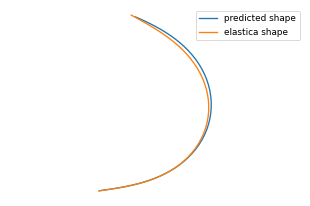


0: 480x640 1 LDO, 9.1ms
Speed: 1.2ms preprocess, 9.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

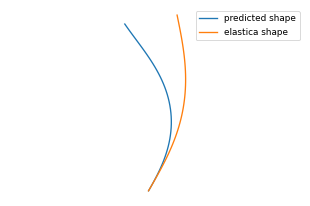


0: 480x640 1 LDO, 10.1ms
Speed: 1.2ms preprocess, 10.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

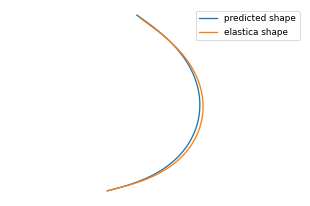


0: 480x640 1 LDO, 8.6ms
Speed: 1.6ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

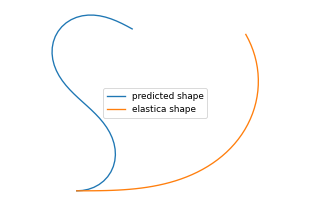


0: 480x640 1 LDO, 8.8ms
Speed: 1.0ms preprocess, 8.8ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

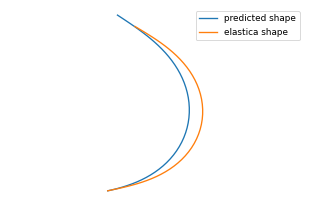


0: 480x640 1 LDO, 9.8ms
Speed: 1.1ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

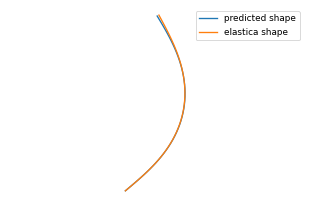


0: 480x640 1 LDO, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

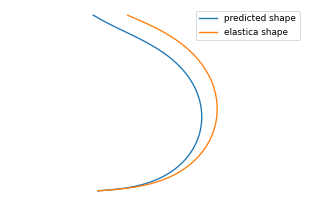


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

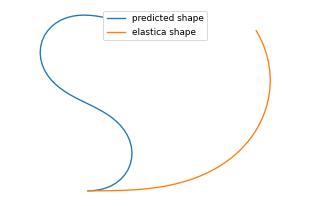


0: 480x640 1 LDO, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

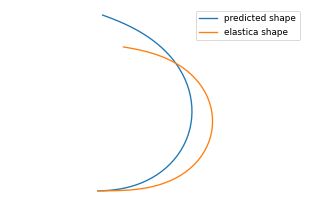


0: 480x640 1 LDO, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

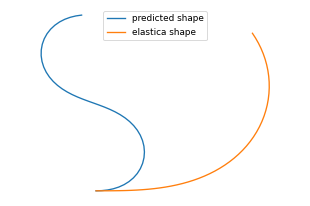


0: 480x640 1 LDO, 8.6ms
Speed: 1.0ms preprocess, 8.6ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

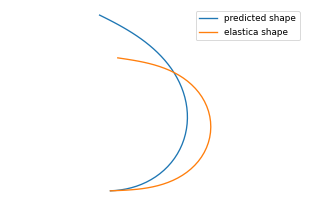


0: 480x640 1 LDO, 9.9ms
Speed: 1.2ms preprocess, 9.9ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


<Figure size 518.4x691.2 with 0 Axes>

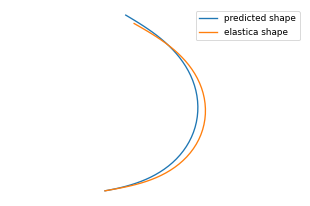

total time: 326.3723418712616


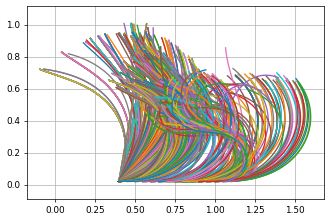

In [12]:
sim_dat_path = '/home/itay/pythonProject/Meatrain/path_to_test_sim/'

start_time = time.time()
fig, ax = plt.subplots()
x =[]
y= []
df_big = pd.DataFrame({'frame':[],'x_shape':[],'y_shape':[],'shape_error':[],'elastica_error':[], 'tangent_error':[],'time':[]})
df_path = pd.DataFrame({'epoch':[],'trajectory_error':[],'trajectory_std':[]})
for epoch in range(0,21):
    for inx,filename in enumerate(glob.glob(sim_dat_path+'test'+str(epoch)+'/'+'*.jpg')): #assuming jpg
    # sim path
        inx, labels, base_frame = control_utils.get_label_inx(Path(filename))
        L,l = base_frame[3], base_frame[4]
        base_frame = base_frame[:3]
        im=cv.imread(str(filename), cv.IMREAD_UNCHANGED)
        flag = control_utils.crop_model(im,yolo_model)
        if type(flag) == bool:
            continue
        angle = -np.rad2deg(base_frame[2])
        # if angle == 0:
        #     angle = -5
        img = cv.imread(str(buf_path), cv.IMREAD_UNCHANGED)
        im=control_utils.rotate_image(img,angle)
        image_height, image_width = im.shape[0:2]
        im = control_utils.crop_around_center(
            im,
            *control_utils.largest_rotated_rect(
                image_width*1,
                image_height*1,
                math.radians(angle)
            )
        )
        unnorm_label = control_utils.unormlized(*labels[:3])
        pred = control_utils.pipeline(im, model)
        [shape_error, elastica_error,tangent_error] = control_utils.MSE_model_error_test(labels,pred,L-l,base_frame)
        L_gal2, S02, mu2 = control_utils.unormlized(L_gal=pred[0], S0=pred[1], mu=pred[2])
        x, y, phi = control_utils.get_shape_hf(base_frame[0],base_frame[1],base_frame[2], L_gal=L_gal2, s0=S02, mu=mu2, s=np.linspace(start=0, stop=1))
        end_time = time.time()
        total_time = end_time-start_time
        new_row = {'frame':int(inx),'x_shape':x,'y_shape':y,'shape_error':shape_error,'elastica_error':elastica_error, 'tangent_error':tangent_error,'time':total_time}
        df_big = df_big._append(new_row, ignore_index=True)
        # print(f"shape_error: {shape_error}, elastica_error: {elastica_error}, tangent_error: {tangent_error}")
    df_big.sort_values("frame",ascending=True, inplace=True)
    end_time = time.time()
    total_time = end_time-start_time
    for x,y in zip(df_big.x_shape,df_big.y_shape):
        plt.plot(x,y)
    print(f"total time: {total_time}")
    plt.axis('equal')
    plt.grid('minor')
    # plt.axis('off')
    plt.show()

### Figure Display

#### Errors boxpolt 

Shape_error: 0.0008 ± 0.0042
Elastica_error: 0.9253 ± 0.3386
Tangent_error: 0.2367 ± 1.2342


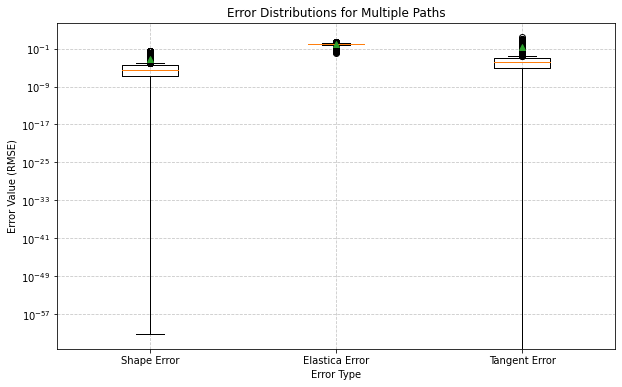


Summary Statistics:
        shape_error  elastica_error  tangent_error
count  1.015000e+03     1015.000000    1015.000000
mean   7.792220e-04        0.925339       0.236660
std    4.166944e-03        0.338590       1.234194
min    7.122906e-62        0.014650       0.000000
25%    1.354324e-07        0.820835       0.000010
50%    2.918437e-06        0.933463       0.000165
75%    3.690694e-05        1.029852       0.001182
max    3.845996e-02        2.102103      21.922168


In [44]:
# Create boxplot data
box_data = [
    df_big['shape_error'],
    df_big['elastica_error'],
    df_big['tangent_error']
]

# Create boxplot
plt.figure(figsize=(10, 6),facecolor='white')
bp = plt.boxplot(box_data, labels=['Shape Error', 'Elastica Error', 'Tangent Error'],showmeans=True, showfliers=True)

# Customize the plot
plt.title('Error Distributions for Multiple Paths')
plt.xlabel('Error Type')
plt.ylabel('Error Value (RMSE)')
plt.grid(True, linestyle='--', alpha=0.7)

for i, metric in enumerate(['shape_error', 'elastica_error', 'tangent_error'], 1):
    mean_val = df_big[metric].mean()
    std_val = df_big[metric].std()
    print(f"{metric.capitalize()}: {mean_val:.4f} ± {std_val:.4f}")

plt.yscale('log')
plt.show()

# Print summary statistics
print("\nSummary Statistics:")
print(df_big[['shape_error', 'elastica_error', 'tangent_error']].describe())

#### Errors histogram

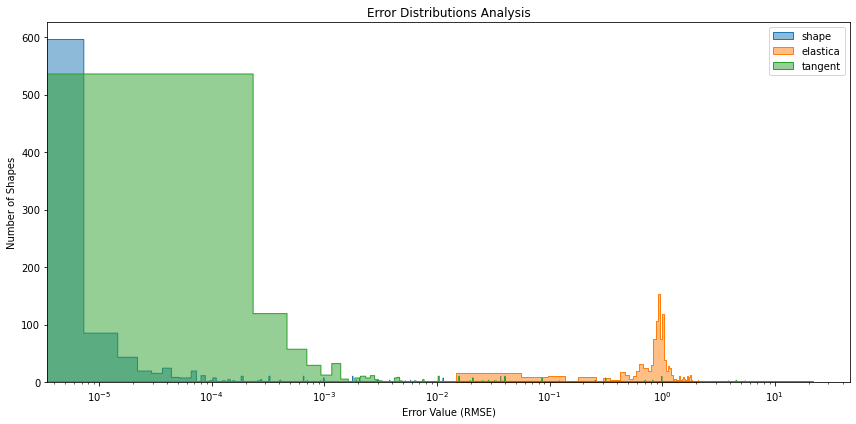


Detailed Statistics:
        shape_error  elastica_error  tangent_error
count  1.015000e+03     1015.000000    1015.000000
mean   7.792220e-04        0.925339       0.236660
std    4.166944e-03        0.338590       1.234194
min    7.122906e-62        0.014650       0.000000
25%    1.354324e-07        0.820835       0.000010
50%    2.918437e-06        0.933463       0.000165
75%    3.690694e-05        1.029852       0.001182
max    3.845996e-02        2.102103      21.922168


In [38]:
def plot_error_distributions(df_big):
    """Plot error distributions with histogram"""
    # Prepare data for plotting
    error_types = ['shape_error', 'elastica_error', 'tangent_error']
    box_data = [df_big[error] for error in error_types]
    
    # Create figure
    plt.figure(figsize=(12, 6))
    
    # Create histograms
    for i, data in enumerate(box_data):
        sns.histplot(data=data, 
                    alpha=0.5,
                    label=error_types[i].replace('_error', ''),
                    element="step",
                    fill=True,
                    stat='count')  # Ensure count is used for x-axis
    
    # Customize plots
    plt.xlabel('Error Value (RMSE)')
    plt.ylabel('Number of Shapes')
    plt.xscale('log')
    # plt.yscale('log')
    plt.legend()
    
    # Add statistics
    stats_text = []
    for metric in error_types + ['time']:
        mean_val = df_big[metric].mean()
        std_val = df_big[metric].std()
        stats_text.append(f"{metric.replace('_error', '')}: {mean_val:.4f} ± {std_val:.4f}")
    
    plt.title('Error Distributions Analysis')
    plt.tight_layout()
    plt.show()
    
    # Print detailed statistics
    print("\nDetailed Statistics:")
    print(df_big[error_types].describe())

# Call the function with your dataframe
plot_error_distributions(df_big)

## Real Experiment

### Real path function loop

In [21]:
def real_path_loop(real_data_path):
    start_time = time.time()
    fig, ax = plt.subplots()
    x =[]
    y= []
    df_real = pd.DataFrame({'frame':[],'x_shape':[],'y_shape':[],'x_flip':[],'y_flip':[],'shape_error':[],'elastica_error':[], 'tangent_error':[],'time':[]})
    for i in range(0,2):
        for inx,filename in enumerate(glob.glob(real_data_path+f'{i}/'+'*.jpg')): #assuming jpg
            inx, labels, base_frame, TCP_base_frame = control_utils.get_label_inx_real(Path(filename))
            im=cv.imread(str(filename), cv.IMREAD_COLOR_RGB) 
            L,l = base_frame[3], base_frame[4]
            base_frame = base_frame[:3]
            fig = Figure(num=1)
            plt.imshow(im,cmap=plt.cm.gray)
            unnorm_label = control_utils.unormlized(*labels[:3])
            
            plt.axis('off')
            plt.show()

            flag = control_utils.crop_model(im,yolo_model)
            if type(flag)==bool:
                continue 
            print(f"frame num {inx}")
            img = cv.imread(str(buf_path), cv.IMREAD_UNCHANGED)
            angle = -np.rad2deg(base_frame[2]) 
            # if angle == 0:
            #     angle = -5
            im=control_utils.rotate_image(img,angle)
            image_height, image_width = im.shape[0:2]
            im = control_utils.crop_around_center(
                im,
                *control_utils.largest_rotated_rect(
                    image_width*1,
                    image_height*1,
                    math.radians(angle)
                )
            )
            pred = control_utils.pipeline(im, model)
            [shape_error, elastica_error,tangent_error] = control_utils.MSE_model_error_test(labels,pred, L-l, base_frame)
            L_gal2, S02, mu2 = control_utils.unormlized(L_gal=pred[0], S0=pred[1], mu=pred[2])
            print("Labels:", labels)
            print("UNorm Label:", unnorm_label)
            print("pred", pred)
            print("UNorm pred", [L_gal2, S02, mu2])
            x, y, phi = control_utils.get_shape_hf(base_frame[0],base_frame[1],base_frame[2], L_gal=L_gal2, s0=S02, mu=mu2, s=np.linspace(start=0, stop=1)) # rotate 
            x0, y0, phi_0 = control_utils.TCP_get_shape(TCP_base_frame[0], TCP_base_frame[1], TCP_base_frame[2],L_gal=round(L_gal2,3), S0=round(S02,3), mu=round(mu2,3), L=1)  #
            end_time = time.time()
            total_time = end_time-start_time
            new_row = {'frame':inx,'x_shape':x,'y_shape':y,'x_flip':x0,'y_flip':y0,'shape_error':shape_error,'elastica_error':elastica_error,'tangent_error':tangent_error,'time':total_time}
            df_real = df_real._append(new_row, ignore_index=True)
            print(f"shape_error: {shape_error}, elastica_error: {elastica_error}")
            print('-------------------------------------------------------------')
        df_real.sort_values("frame",ascending=True, inplace=True)
        end_time = time.time()
        total_time = end_time-start_time
        print(f"total time: {total_time}")
    return df_real

### Beef path

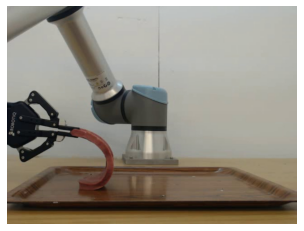


0: 480x640 1 LDO, 10.1ms
Speed: 10.1ms preprocess, 10.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)
frame num 6


<Figure size 518.4x691.2 with 0 Axes>

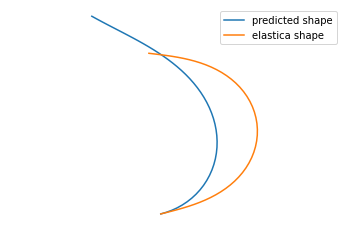

Labels: [0.33, 0.083, 0.18]
UNorm Label: (1.99, 0.332, -0.19884000000000002)
pred (0.6201171875, 0.310302734375, 0.2315673828125)
UNorm pred [2.8603515625, 1.2412109375, -0.12344848632812505]
shape_error: 1.1414008376373239e-06, elastica_error: 0.046164570169130954
-------------------------------------------------------------


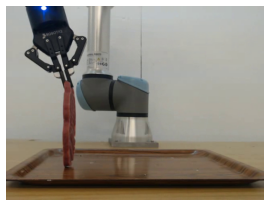


0: 480x640 1 LDO, 10.3ms
Speed: 0.8ms preprocess, 10.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 1


<Figure size 518.4x691.2 with 0 Axes>

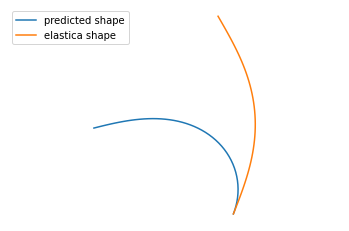

Labels: [0.33, 0.083, 0.901]
UNorm Label: (1.99, 0.332, 0.855262)
pred (0.82275390625, 0.390625, 0.256103515625)
UNorm pred [3.46826171875, 1.5625, -0.08757666015625004]
shape_error: 4.8512019215518403e-05, elastica_error: 0.2511103427696228
-------------------------------------------------------------


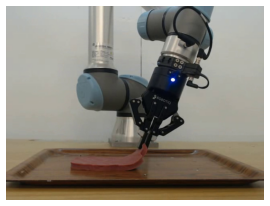


0: 480x640 1 LDO, 9.4ms
Speed: 0.8ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 19


<Figure size 518.4x691.2 with 0 Axes>

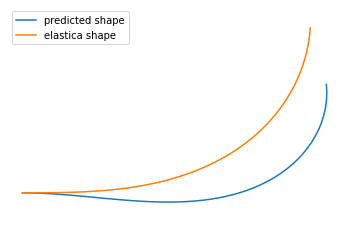

Labels: [0.267, 0.067, 0.05]
UNorm Label: (1.8010000000000002, 0.268, -0.3889)
pred (0.8994140625, 0.181640625, -0.1610107421875)
UNorm pred [3.6982421875, 0.7265625, -0.697397705078125]
shape_error: 4.23574887831722e-09, elastica_error: 0.1525385175555547
-------------------------------------------------------------


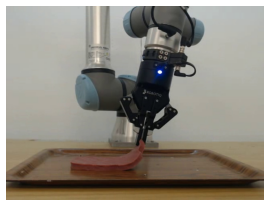


0: 480x640 1 LDO, 9.4ms
Speed: 0.7ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 18


<Figure size 518.4x691.2 with 0 Axes>

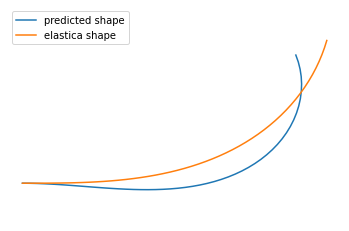

Labels: [0.297, 0.074, 0.05]
UNorm Label: (1.891, 0.296, -0.3889)
pred (0.84521484375, 0.1781005859375, -0.143310546875)
UNorm pred [3.53564453125, 0.71240234375, -0.6715200195312501]
shape_error: 2.368583447002934e-10, elastica_error: 0.11624847147782646
-------------------------------------------------------------


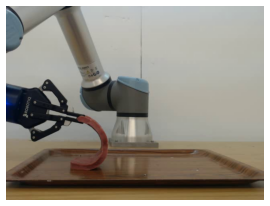


0: 480x640 1 LDO, 8.9ms
Speed: 0.7ms preprocess, 8.9ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
frame num 8


<Figure size 518.4x691.2 with 0 Axes>

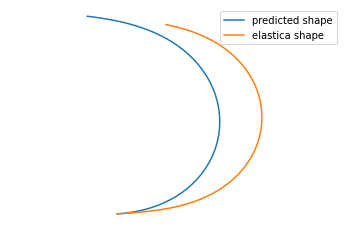

Labels: [0.373, 0.093, 0.09]
UNorm Label: (2.1189999999999998, 0.372, -0.33042000000000005)
pred (0.54638671875, 0.2254638671875, 0.29248046875)
UNorm pred [2.63916015625, 0.90185546875, -0.03439355468750005]
shape_error: 8.610907167574874e-07, elastica_error: 0.029535990191459655
-------------------------------------------------------------


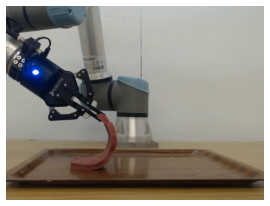


0: 480x640 1 LDO, 8.7ms
Speed: 0.7ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 11


<Figure size 518.4x691.2 with 0 Axes>

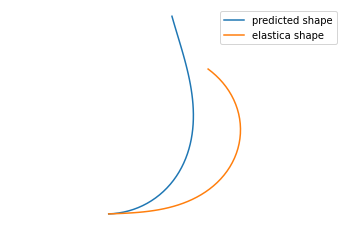

Labels: [0.466, 0.117, 0.06]
UNorm Label: (2.398, 0.468, -0.37428000000000006)
pred (0.68408203125, 0.342529296875, 0.4482421875)
UNorm pred [3.05224609375, 1.3701171875, 0.19333007812499997]
shape_error: 1.8223601416373851e-06, elastica_error: 0.08305174408594768
-------------------------------------------------------------


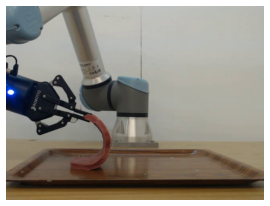


0: 480x640 1 LDO, 9.7ms
Speed: 0.7ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 9


<Figure size 518.4x691.2 with 0 Axes>

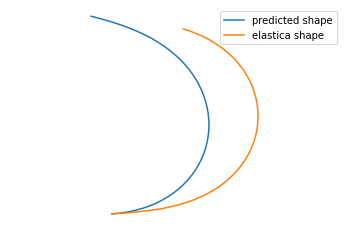

Labels: [0.404, 0.101, 0.074]
UNorm Label: (2.212, 0.404, -0.353812)
pred (0.548828125, 0.2303466796875, 0.330078125)
UNorm pred [2.646484375, 0.92138671875, 0.020574218749999984]
shape_error: 1.896532522038255e-06, elastica_error: 0.034427251813570654
-------------------------------------------------------------


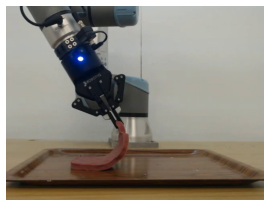


0: 480x640 1 LDO, 8.7ms
Speed: 0.7ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 14


<Figure size 518.4x691.2 with 0 Axes>

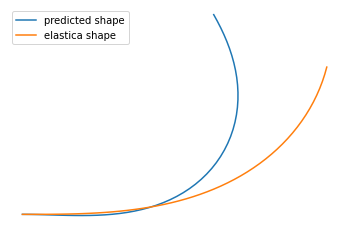

Labels: [0.429, 0.107, 0.05]
UNorm Label: (2.287, 0.428, -0.3889)
pred (0.37939453125, 0.11346435546875, 0.6201171875)
UNorm pred [2.13818359375, 0.453857421875, 0.444611328125]
shape_error: 1.3898106485617115e-07, elastica_error: 0.10917869930148123
-------------------------------------------------------------


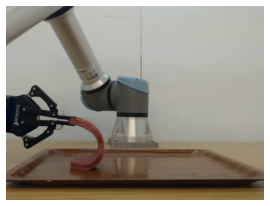


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 7


<Figure size 518.4x691.2 with 0 Axes>

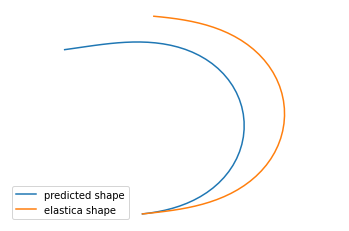

Labels: [0.343, 0.086, 0.094]
UNorm Label: (2.029, 0.344, -0.324572)
pred (0.399169921875, 0.1719970703125, 0.263916015625)
UNorm pred [2.197509765625, 0.68798828125, -0.07615478515625002]
shape_error: 1.0053116379703551e-06, elastica_error: 0.013140669530550639
-------------------------------------------------------------


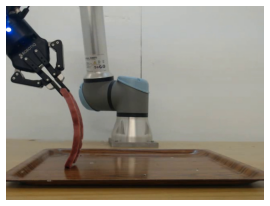


0: 480x640 1 LDO, 8.6ms
Speed: 0.8ms preprocess, 8.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 2


<Figure size 518.4x691.2 with 0 Axes>

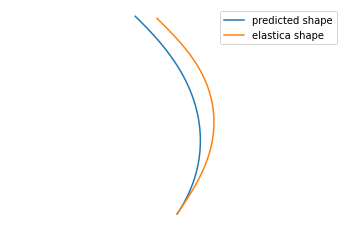

Labels: [0.33, 0.083, 0.77]
UNorm Label: (1.99, 0.332, 0.66374)
pred (0.7158203125, 0.31591796875, 0.748046875)
UNorm pred [3.1474609375, 1.263671875, 0.6316445312500001]
shape_error: 3.354947921723108e-08, elastica_error: 0.06786334446716308
-------------------------------------------------------------


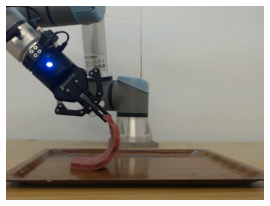


0: 480x640 1 LDO, 9.5ms
Speed: 0.8ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 12


<Figure size 518.4x691.2 with 0 Axes>

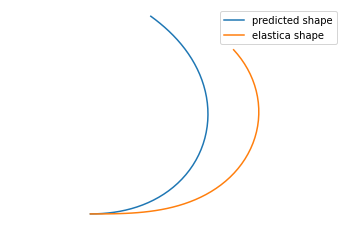

Labels: [0.495, 0.124, 0.05]
UNorm Label: (2.485, 0.496, -0.3889)
pred (0.70068359375, 0.266357421875, 0.39013671875)
UNorm pred [3.10205078125, 1.0654296875, 0.10837988281249994]
shape_error: 1.8084957405867015e-06, elastica_error: 0.0594214545809428
-------------------------------------------------------------


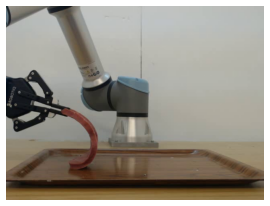


0: 480x640 1 LDO, 9.8ms
Speed: 0.7ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 5


<Figure size 518.4x691.2 with 0 Axes>

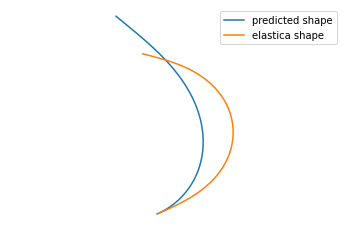

Labels: [0.33, 0.083, 0.326]
UNorm Label: (1.99, 0.332, 0.014611999999999958)
pred (0.78759765625, 0.390380859375, 0.26220703125)
UNorm pred [3.36279296875, 1.5615234375, -0.07865332031250005]
shape_error: 3.696224635751592e-07, elastica_error: 0.10264938352584839
-------------------------------------------------------------


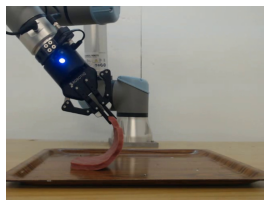


0: 480x640 1 LDO, 9.8ms
Speed: 0.7ms preprocess, 9.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 13


<Figure size 518.4x691.2 with 0 Axes>

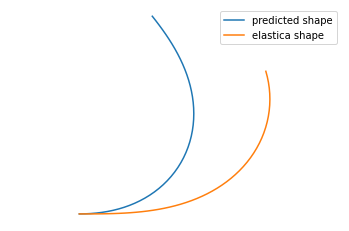

Labels: [0.461, 0.115, 0.05]
UNorm Label: (2.383, 0.46, -0.3889)
pred (0.56787109375, 0.23095703125, 0.54296875)
UNorm pred [2.70361328125, 0.923828125, 0.33182031249999994]
shape_error: 2.6770418779169654e-06, elastica_error: 0.0892952174173991
-------------------------------------------------------------


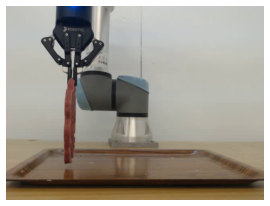


0: 480x640 1 LDO, 9.8ms
Speed: 0.8ms preprocess, 9.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 0


<Figure size 518.4x691.2 with 0 Axes>

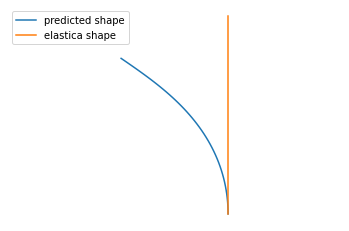

Labels: [0.33, 0.083, 1.0]
UNorm Label: (1.99, 0.332, 1.0)
pred (0.80029296875, 0.384033203125, 0.81884765625)
UNorm pred [3.40087890625, 1.5361328125, 0.7351552734375]
shape_error: 1.1632225463466746e-05, elastica_error: 0.11487087916183471
-------------------------------------------------------------


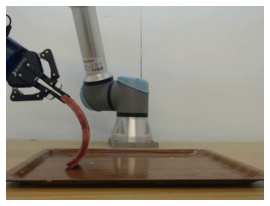


0: 480x640 1 LDO, 9.7ms
Speed: 0.7ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 3


<Figure size 518.4x691.2 with 0 Axes>

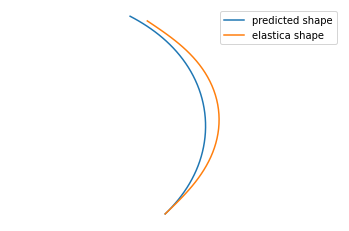

Labels: [0.33, 0.083, 0.626]
UNorm Label: (1.99, 0.332, 0.453212)
pred (0.828125, 0.323974609375, 0.5634765625)
UNorm pred [3.484375, 1.2958984375, 0.36180273437499993]
shape_error: 1.2053656129405847e-08, elastica_error: 0.10336881940841675
-------------------------------------------------------------


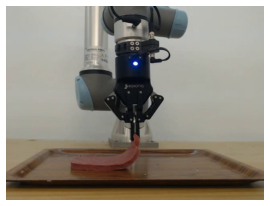


0: 480x640 1 LDO, 8.7ms
Speed: 0.9ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 17


<Figure size 518.4x691.2 with 0 Axes>

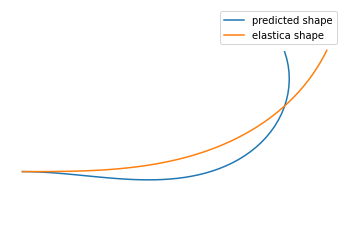

Labels: [0.329, 0.082, 0.05]
UNorm Label: (1.987, 0.328, -0.3889)
pred (0.76611328125, 0.16064453125, 0.0064544677734375)
UNorm pred [3.29833984375, 0.642578125, -0.4525635681152344]
shape_error: 3.4143102130520635e-10, elastica_error: 0.06638306543918947
-------------------------------------------------------------


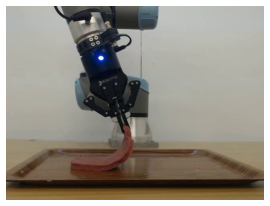


0: 480x640 1 LDO, 9.0ms
Speed: 0.8ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 15


<Figure size 518.4x691.2 with 0 Axes>

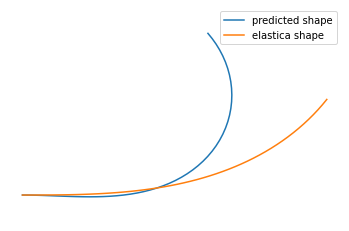

Labels: [0.395, 0.099, 0.05]
UNorm Label: (2.185, 0.396, -0.3889)
pred (0.552734375, 0.140625, 0.362060546875)
UNorm pred [2.658203125, 0.5625, 0.06733251953124991]
shape_error: 7.158886349069168e-08, elastica_error: 0.041331519532521566
-------------------------------------------------------------


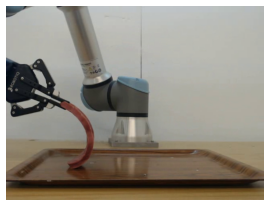


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 4


<Figure size 518.4x691.2 with 0 Axes>

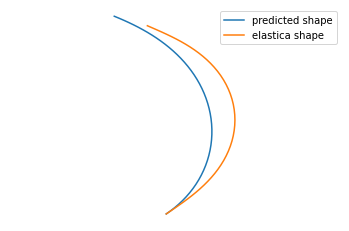

Labels: [0.33, 0.083, 0.48]
UNorm Label: (1.99, 0.332, 0.23975999999999992)
pred (0.8046875, 0.34765625, 0.4189453125)
UNorm pred [3.4140625, 1.390625, 0.15049804687499996]
shape_error: 1.2245407590623346e-07, elastica_error: 0.09969960939534506
-------------------------------------------------------------


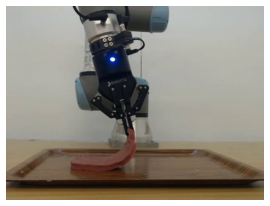


0: 480x640 1 LDO, 9.2ms
Speed: 0.7ms preprocess, 9.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 16


<Figure size 518.4x691.2 with 0 Axes>

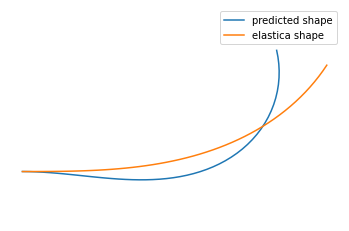

Labels: [0.363, 0.091, 0.05]
UNorm Label: (2.089, 0.364, -0.3889)
pred (0.60107421875, 0.1309814453125, 0.378173828125)
UNorm pred [2.80322265625, 0.52392578125, 0.09089013671874996]
shape_error: 8.201655407830179e-10, elastica_error: 0.05532530368963878
-------------------------------------------------------------


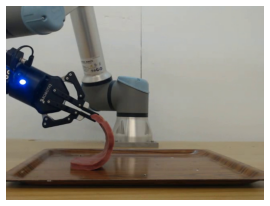


0: 480x640 1 LDO, 8.7ms
Speed: 0.7ms preprocess, 8.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 10


<Figure size 518.4x691.2 with 0 Axes>

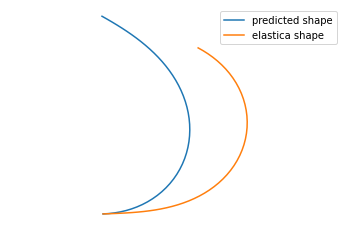

Labels: [0.434, 0.108, 0.07]
UNorm Label: (2.302, 0.432, -0.35966)
pred (0.68115234375, 0.300048828125, 0.298828125)
UNorm pred [3.04345703125, 1.2001953125, -0.025113281250000008]
shape_error: 4.203983934618139e-06, elastica_error: 0.0501097813987732
-------------------------------------------------------------
total time: 11.91654896736145


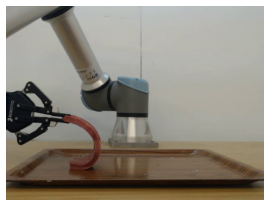


0: 480x640 1 LDO, 9.7ms
Speed: 0.9ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 6


<Figure size 518.4x691.2 with 0 Axes>

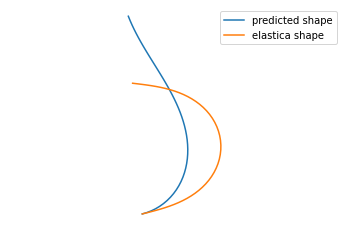

Labels: [0.33, 0.083, 0.18]
UNorm Label: (1.99, 0.332, -0.19884000000000002)
pred (0.6552734375, 0.364501953125, 0.1728515625)
UNorm pred [2.9658203125, 1.4580078125, -0.20929101562500002]
shape_error: 9.293082778281606e-07, elastica_error: 0.0616990863049825
-------------------------------------------------------------


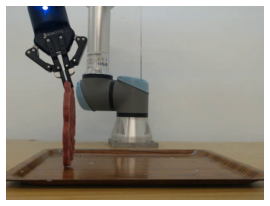


0: 480x640 1 LDO, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 1


<Figure size 518.4x691.2 with 0 Axes>

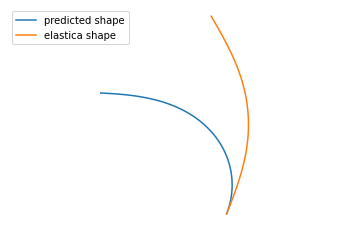

Labels: [0.33, 0.083, 0.901]
UNorm Label: (1.99, 0.332, 0.855262)
pred (0.830078125, 0.3916015625, 0.411865234375)
UNorm pred [3.490234375, 1.56640625, 0.14014697265624992]
shape_error: 2.056134144545296e-05, elastica_error: 0.1948552914746602
-------------------------------------------------------------


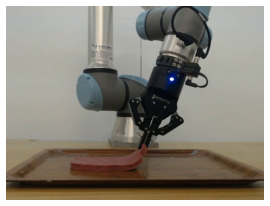


0: 480x640 1 LDO, 8.9ms
Speed: 0.7ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
frame num 19


<Figure size 518.4x691.2 with 0 Axes>

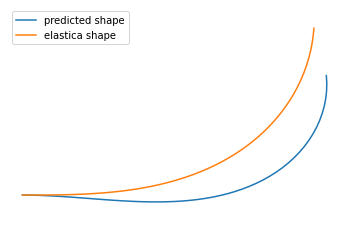

Labels: [0.267, 0.067, 0.05]
UNorm Label: (1.8010000000000002, 0.268, -0.3889)
pred (0.904296875, 0.187255859375, -0.0911865234375)
UNorm pred [3.712890625, 0.7490234375, -0.595314697265625]
shape_error: 2.112903233435457e-09, elastica_error: 0.1468474709997177
-------------------------------------------------------------


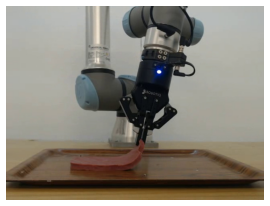


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 18


<Figure size 518.4x691.2 with 0 Axes>

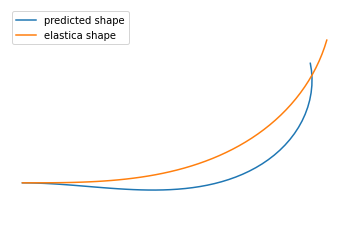

Labels: [0.297, 0.074, 0.05]
UNorm Label: (1.891, 0.296, -0.3889)
pred (0.86669921875, 0.179931640625, -0.094482421875)
UNorm pred [3.60009765625, 0.7197265625, -0.60013330078125]
shape_error: 4.0518161013408156e-10, elastica_error: 0.11888462752024336
-------------------------------------------------------------


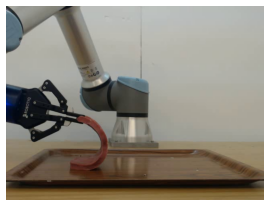


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 8


<Figure size 518.4x691.2 with 0 Axes>

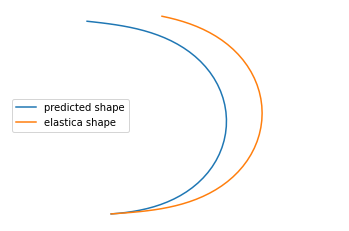

Labels: [0.373, 0.093, 0.09]
UNorm Label: (2.1189999999999998, 0.372, -0.33042000000000005)
pred (0.412841796875, 0.1666259765625, 0.35498046875)
UNorm pred [2.238525390625, 0.66650390625, 0.05698144531249999]
shape_error: 4.930155249684637e-07, elastica_error: 0.025740934007326768
-------------------------------------------------------------


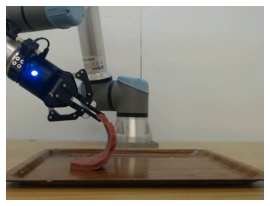


0: 480x640 1 LDO, 9.5ms
Speed: 0.9ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 11


<Figure size 518.4x691.2 with 0 Axes>

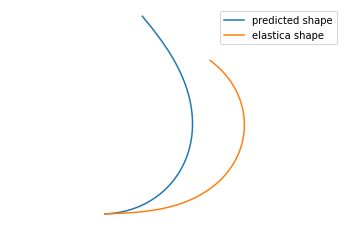

Labels: [0.466, 0.117, 0.06]
UNorm Label: (2.398, 0.468, -0.37428000000000006)
pred (0.7041015625, 0.319091796875, 0.40478515625)
UNorm pred [3.1123046875, 1.2763671875, 0.1297958984375]
shape_error: 2.723025002173029e-06, elastica_error: 0.07213675079981485
-------------------------------------------------------------


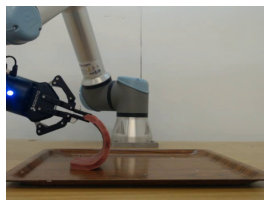


0: 480x640 1 LDO, 9.4ms
Speed: 0.8ms preprocess, 9.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 9


<Figure size 518.4x691.2 with 0 Axes>

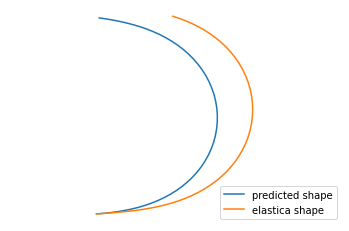

Labels: [0.404, 0.101, 0.074]
UNorm Label: (2.212, 0.404, -0.353812)
pred (0.465087890625, 0.1763916015625, 0.35595703125)
UNorm pred [2.395263671875, 0.70556640625, 0.05840917968749998]
shape_error: 4.6788006515586926e-07, elastica_error: 0.029638463812828062
-------------------------------------------------------------


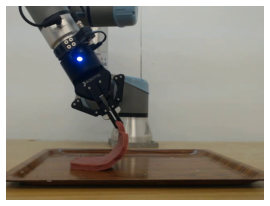


0: 480x640 1 LDO, 9.3ms
Speed: 0.8ms preprocess, 9.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 14


<Figure size 518.4x691.2 with 0 Axes>

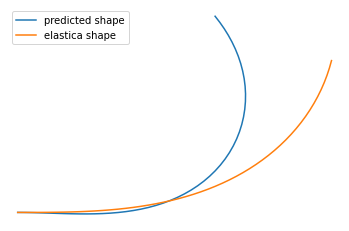

Labels: [0.429, 0.107, 0.05]
UNorm Label: (2.287, 0.428, -0.3889)
pred (0.461181640625, 0.126708984375, 0.495849609375)
UNorm pred [2.383544921875, 0.5068359375, 0.26293212890625]
shape_error: 1.0831500077788995e-07, elastica_error: 0.06673532541275025
-------------------------------------------------------------


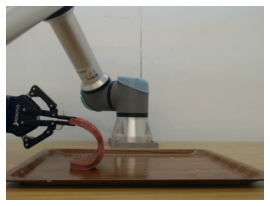


0: 480x640 1 LDO, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 7


<Figure size 518.4x691.2 with 0 Axes>

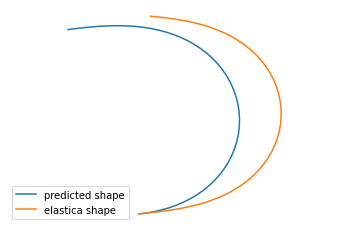

Labels: [0.343, 0.086, 0.094]
UNorm Label: (2.029, 0.344, -0.324572)
pred (0.52392578125, 0.2205810546875, 0.2166748046875)
UNorm pred [2.57177734375, 0.88232421875, -0.14522143554687506]
shape_error: 7.332173588466903e-07, elastica_error: 0.02196510210227966
-------------------------------------------------------------


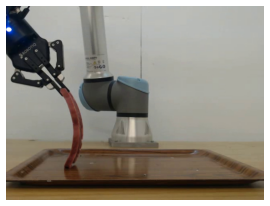


0: 480x640 1 LDO, 10.0ms
Speed: 0.8ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 2


<Figure size 518.4x691.2 with 0 Axes>

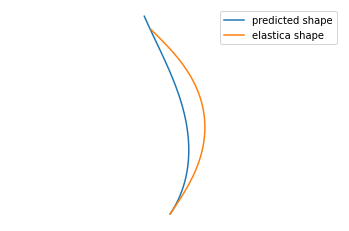

Labels: [0.33, 0.083, 0.77]
UNorm Label: (1.99, 0.332, 0.66374)
pred (0.9306640625, 0.494384765625, 0.5615234375)
UNorm pred [3.7919921875, 1.9775390625, 0.35894726562499996]
shape_error: 3.563371804476904e-08, elastica_error: 0.19116573949305213
-------------------------------------------------------------


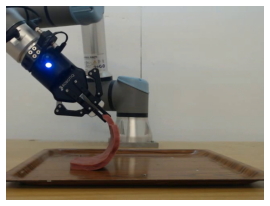


0: 480x640 1 LDO, 9.1ms
Speed: 0.9ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 12


<Figure size 518.4x691.2 with 0 Axes>

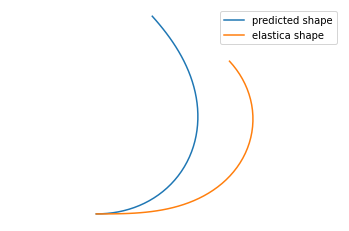

Labels: [0.495, 0.124, 0.05]
UNorm Label: (2.485, 0.496, -0.3889)
pred (0.7724609375, 0.327392578125, 0.39453125)
UNorm pred [3.3173828125, 1.3095703125, 0.1148046875]
shape_error: 2.9179600483399658e-06, elastica_error: 0.07901829830042521
-------------------------------------------------------------


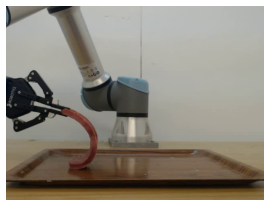


0: 480x640 1 LDO, 9.5ms
Speed: 0.8ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 5


<Figure size 518.4x691.2 with 0 Axes>

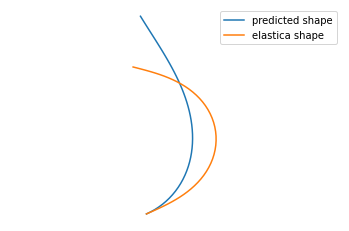

Labels: [0.33, 0.083, 0.326]
UNorm Label: (1.99, 0.332, 0.014611999999999958)
pred (0.8525390625, 0.438232421875, 0.2666015625)
UNorm pred [3.5576171875, 1.7529296875, -0.07222851562500004]
shape_error: 2.3676993165345234e-07, elastica_error: 0.1342551065889994
-------------------------------------------------------------


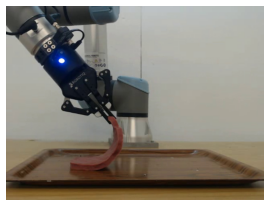


0: 480x640 1 LDO, 9.6ms
Speed: 0.8ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 13


<Figure size 518.4x691.2 with 0 Axes>

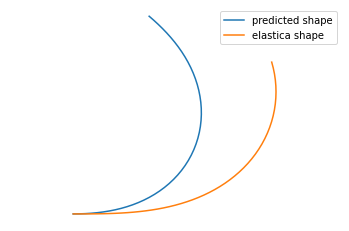

Labels: [0.461, 0.115, 0.05]
UNorm Label: (2.383, 0.46, -0.3889)
pred (0.56201171875, 0.208251953125, 0.488037109375)
UNorm pred [2.68603515625, 0.8330078125, 0.25151025390625]
shape_error: 2.094726715306168e-06, elastica_error: 0.07025860109202067
-------------------------------------------------------------


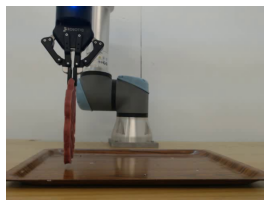


0: 480x640 1 LDO, 9.5ms
Speed: 0.8ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 0


<Figure size 518.4x691.2 with 0 Axes>

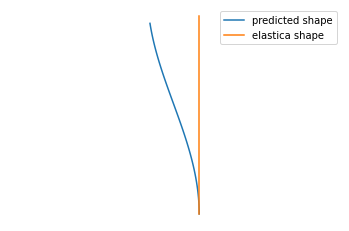

Labels: [0.33, 0.083, 1.0]
UNorm Label: (1.99, 0.332, 1.0)
pred (0.8974609375, 0.5478515625, 0.7958984375)
UNorm pred [3.6923828125, 2.19140625, 0.701603515625]
shape_error: 6.150534464860489e-07, elastica_error: 0.19325211285400387
-------------------------------------------------------------


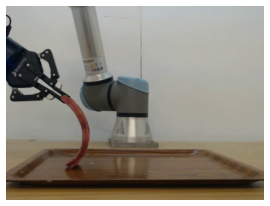


0: 480x640 1 LDO, 9.4ms
Speed: 0.7ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 3


<Figure size 518.4x691.2 with 0 Axes>

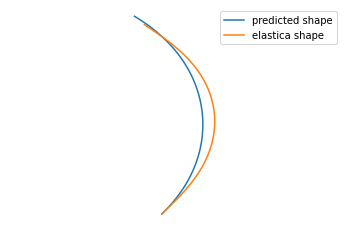

Labels: [0.33, 0.083, 0.626]
UNorm Label: (1.99, 0.332, 0.453212)
pred (0.86865234375, 0.33740234375, 0.57080078125)
UNorm pred [3.60595703125, 1.349609375, 0.37251074218749997]
shape_error: 5.094476995472527e-09, elastica_error: 0.11930461789449054
-------------------------------------------------------------


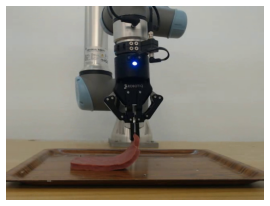


0: 480x640 1 LDO, 9.7ms
Speed: 0.7ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 17


<Figure size 518.4x691.2 with 0 Axes>

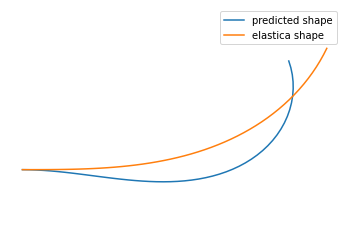

Labels: [0.329, 0.082, 0.05]
UNorm Label: (1.987, 0.328, -0.3889)
pred (0.74658203125, 0.151611328125, -0.03436279296875)
UNorm pred [3.23974609375, 0.6064453125, -0.5122384033203126]
shape_error: 6.241243019517556e-10, elastica_error: 0.062112523554563516
-------------------------------------------------------------


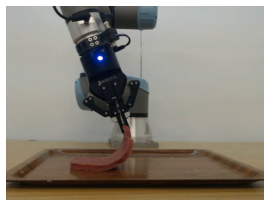


0: 480x640 1 LDO, 9.4ms
Speed: 0.7ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 15


<Figure size 518.4x691.2 with 0 Axes>

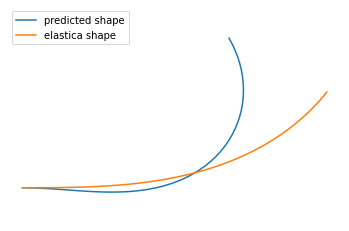

Labels: [0.395, 0.099, 0.05]
UNorm Label: (2.185, 0.396, -0.3889)
pred (0.48583984375, 0.11981201171875, 0.470947265625)
UNorm pred [2.45751953125, 0.479248046875, 0.22652490234374995]
shape_error: 2.9302940335602496e-08, elastica_error: 0.06196053916049004
-------------------------------------------------------------


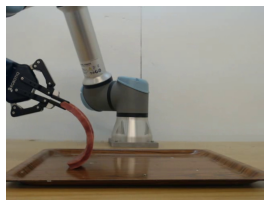


0: 480x640 1 LDO, 8.7ms
Speed: 0.8ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 4


<Figure size 518.4x691.2 with 0 Axes>

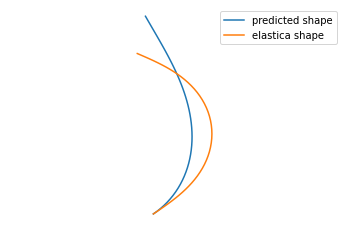

Labels: [0.33, 0.083, 0.48]
UNorm Label: (1.99, 0.332, 0.23975999999999992)
pred (0.89111328125, 0.455078125, 0.39111328125)
UNorm pred [3.67333984375, 1.8203125, 0.10980761718749993]
shape_error: 8.825574648146492e-08, elastica_error: 0.15373036475626625
-------------------------------------------------------------


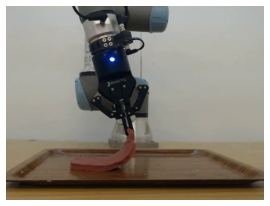


0: 480x640 1 LDO, 8.9ms
Speed: 0.7ms preprocess, 8.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 16


<Figure size 518.4x691.2 with 0 Axes>

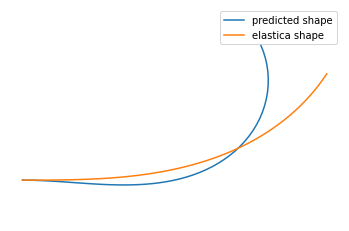

Labels: [0.363, 0.091, 0.05]
UNorm Label: (2.089, 0.364, -0.3889)
pred (0.69189453125, 0.154541015625, 0.195556640625)
UNorm pred [3.07568359375, 0.6181640625, -0.17609619140625005]
shape_error: 3.157551093984932e-09, elastica_error: 0.04446526966094971
-------------------------------------------------------------


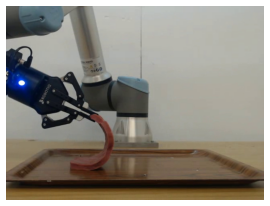


0: 480x640 1 LDO, 9.5ms
Speed: 0.8ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
frame num 10


<Figure size 518.4x691.2 with 0 Axes>

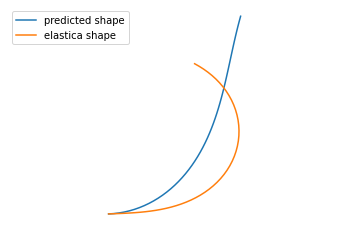

Labels: [0.434, 0.108, 0.07]
UNorm Label: (2.302, 0.432, -0.35966)
pred (0.8564453125, 0.4619140625, 0.365966796875)
UNorm pred [3.5693359375, 1.84765625, 0.07304345703124998]
shape_error: 3.298137619736307e-07, elastica_error: 0.13043718351364134
-------------------------------------------------------------
total time: 23.886921882629395


<Figure size 384x256 with 0 Axes>

In [22]:
real_data_path_beef = './data_real_shapes/video_with_planner/videos/data/beef/beef'

df_beef = real_path_loop(real_data_path_beef)


#### Path display

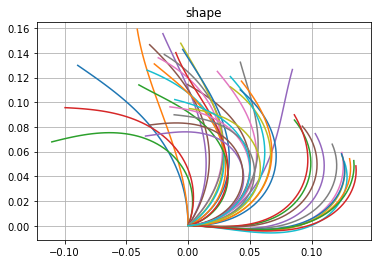

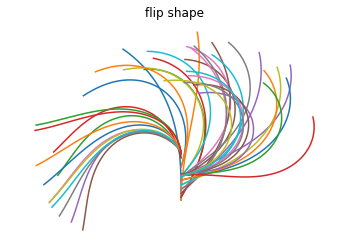

In [24]:
# Trajectory Display 
for x,y in zip(df_beef.x_shape,df_beef.y_shape):
    plt.plot((x-x[0])*(L-l),(y-y[0])*(L-l))
plt.title("shape")
plt.axis('equal')
plt.grid('minor')
# plt.axis('off')
plt.show()
for x,y in zip(df_beef.x_flip,df_beef.y_flip):
    plt.plot((x-x[0])*(L-l),(-y-y[0])*(L-l))
plt.title("flip shape")
plt.axis('equal')
plt.grid('minor')
plt.axis('off')
plt.show()

### Salmon path

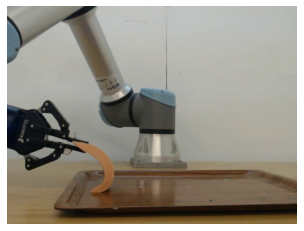


0: 480x640 1 LDO, 10.7ms
Speed: 15.7ms preprocess, 10.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 4


<Figure size 518.4x691.2 with 0 Axes>

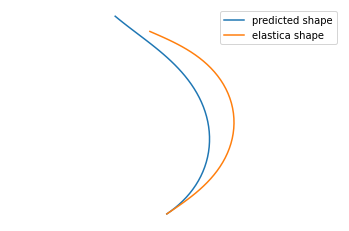

Labels: [0.224, 0.056, 0.48]
UNorm Label: (1.6720000000000002, 0.224, 0.23975999999999992)
pred (0.452880859375, 0.2203369140625, 0.62451171875)
UNorm pred [2.358642578125, 0.88134765625, 0.45103613281249993]
shape_error: 4.9580329911661006e-08, elastica_error: 0.03342556865596771
-------------------------------------------------------------


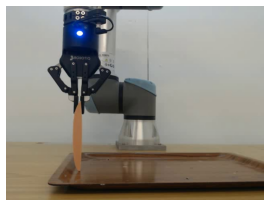


0: 480x640 1 LDO, 8.9ms
Speed: 0.7ms preprocess, 8.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 0


<Figure size 518.4x691.2 with 0 Axes>

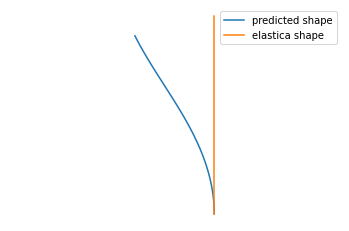

Labels: [0.224, 0.056, 1.0]
UNorm Label: (1.6720000000000002, 0.224, 1.0)
pred (0.8603515625, 0.493408203125, 0.7734375)
UNorm pred [3.5810546875, 1.9736328125, 0.668765625]
shape_error: 7.674034351883807e-07, elastica_error: 0.21586660455449422
-------------------------------------------------------------


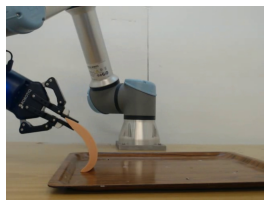


0: 480x640 1 LDO, 9.4ms
Speed: 0.7ms preprocess, 9.4ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
frame num 3


<Figure size 518.4x691.2 with 0 Axes>

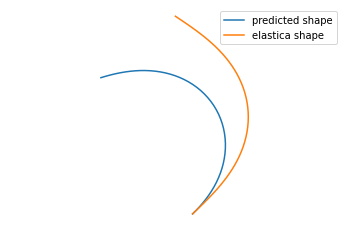

Labels: [0.224, 0.056, 0.626]
UNorm Label: (1.6720000000000002, 0.224, 0.453212)
pred (0.63916015625, 0.2496337890625, 0.357177734375)
UNorm pred [2.91748046875, 0.99853515625, 0.060193847656249966]
shape_error: 5.796832997558575e-07, elastica_error: 0.09403913669999442
-------------------------------------------------------------


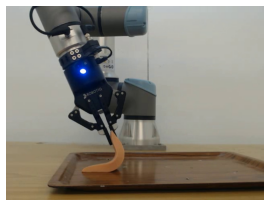


0: 480x640 1 LDO, 9.4ms
Speed: 0.8ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 11


<Figure size 518.4x691.2 with 0 Axes>

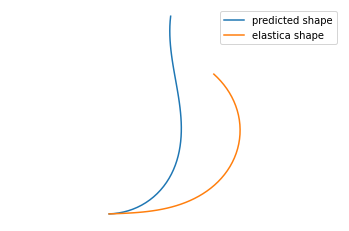

Labels: [0.32, 0.08, 0.094]
UNorm Label: (1.96, 0.32, -0.324572)
pred (0.43212890625, 0.247802734375, 0.56396484375)
UNorm pred [2.29638671875, 0.9912109375, 0.36251660156249993]
shape_error: 9.149374981391306e-07, elastica_error: 0.08719920121383667
-------------------------------------------------------------


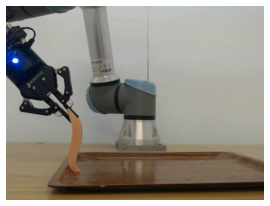


0: 480x640 1 LDO, 8.6ms
Speed: 0.8ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
frame num 2


<Figure size 518.4x691.2 with 0 Axes>

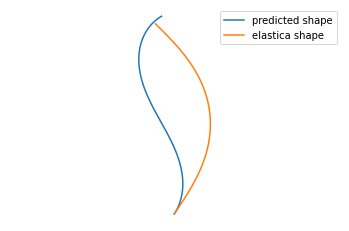

Labels: [0.224, 0.056, 0.77]
UNorm Label: (1.6720000000000002, 0.224, 0.66374)
pred (0.470458984375, 0.33837890625, 0.1239013671875)
UNorm pred [2.411376953125, 1.353515625, -0.28085620117187504]
shape_error: 2.808227805283751e-07, elastica_error: 0.18597444033209487
-------------------------------------------------------------


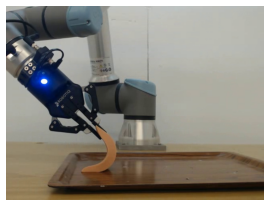


0: 480x640 1 LDO, 9.5ms
Speed: 0.8ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 9


<Figure size 518.4x691.2 with 0 Axes>

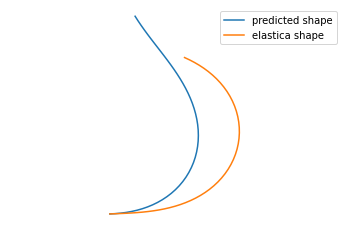

Labels: [0.277, 0.069, 0.104]
UNorm Label: (1.831, 0.276, -0.309952)
pred (0.3447265625, 0.1669921875, 0.5869140625)
UNorm pred [2.0341796875, 0.66796875, 0.396068359375]
shape_error: 2.4318520961890393e-07, elastica_error: 0.08246511594645183
-------------------------------------------------------------


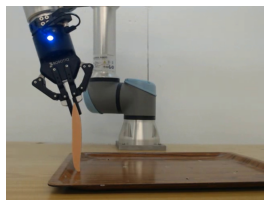


0: 480x640 1 LDO, 8.7ms
Speed: 0.7ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 1


<Figure size 518.4x691.2 with 0 Axes>

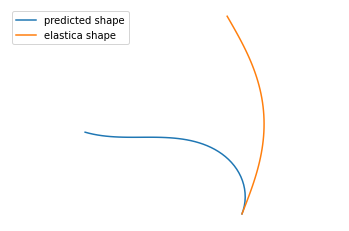

Labels: [0.224, 0.056, 0.901]
UNorm Label: (1.6720000000000002, 0.224, 0.855262)
pred (0.59814453125, 0.341796875, 0.1494140625)
UNorm pred [2.79443359375, 1.3671875, -0.24355664062500001]
shape_error: 1.875290384003439e-05, elastica_error: 0.26218180182393397
-------------------------------------------------------------


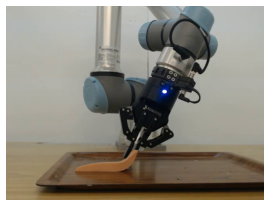


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 15


<Figure size 518.4x691.2 with 0 Axes>

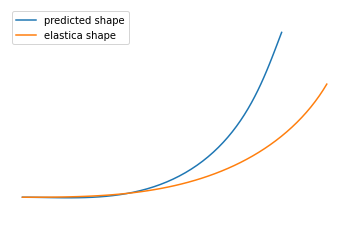

Labels: [0.27, 0.068, 0.07]
UNorm Label: (1.81, 0.272, -0.35966)
pred (0.27294921875, 0.09649658203125, 0.87548828125)
UNorm pred [1.81884765625, 0.385986328125, 0.8179638671875]
shape_error: 2.0920773464517497e-09, elastica_error: 0.2165440414365927
-------------------------------------------------------------


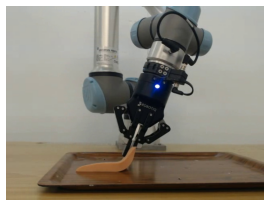


0: 480x640 1 LDO, 10.0ms
Speed: 0.8ms preprocess, 10.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 14


<Figure size 518.4x691.2 with 0 Axes>

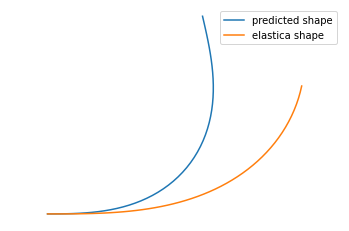

Labels: [0.293, 0.073, 0.07]
UNorm Label: (1.879, 0.292, -0.35966)
pred (0.344482421875, 0.1300048828125, 0.7412109375)
UNorm pred [2.033447265625, 0.52001953125, 0.6216503906249999]
shape_error: 8.684398127115979e-08, elastica_error: 0.15214137301540373
-------------------------------------------------------------


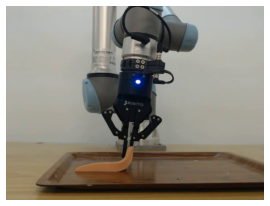


0: 480x640 1 LDO, 8.9ms
Speed: 0.9ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
frame num 16


<Figure size 518.4x691.2 with 0 Axes>

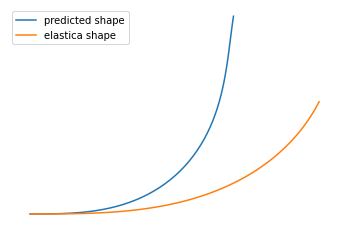

Labels: [0.25, 0.062, 0.06]
UNorm Label: (1.75, 0.248, -0.37428000000000006)
pred (0.283203125, 0.1142578125, 0.8291015625)
UNorm pred [1.849609375, 0.45703125, 0.7501464843750001]
shape_error: 2.343665547823725e-08, elastica_error: 0.19845017997233072
-------------------------------------------------------------


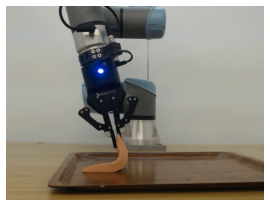


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 12


<Figure size 518.4x691.2 with 0 Axes>

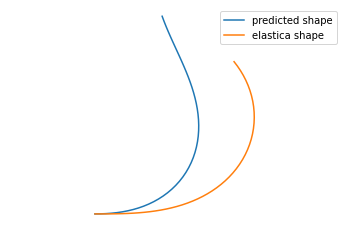

Labels: [0.336, 0.084, 0.09]
UNorm Label: (2.008, 0.336, -0.33042000000000005)
pred (0.3232421875, 0.15234375, 0.6650390625)
UNorm pred [1.9697265625, 0.609375, 0.5102871093749999]
shape_error: 5.525042200250618e-07, elastica_error: 0.11183451778157553
-------------------------------------------------------------


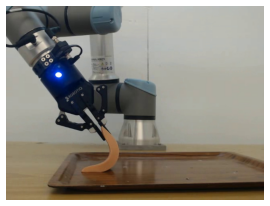


0: 480x640 1 LDO, 10.0ms
Speed: 0.7ms preprocess, 10.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 10


<Figure size 518.4x691.2 with 0 Axes>

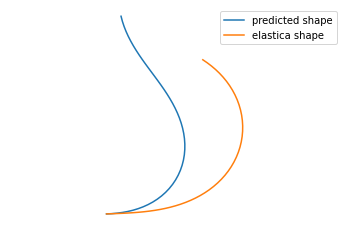

Labels: [0.298, 0.074, 0.1]
UNorm Label: (1.894, 0.296, -0.3158)
pred (0.2452392578125, 0.13720703125, 0.60546875)
UNorm pred [1.7357177734375, 0.548828125, 0.4231953124999999]
shape_error: 1.1802039518521289e-06, elastica_error: 0.08742582731405894
-------------------------------------------------------------


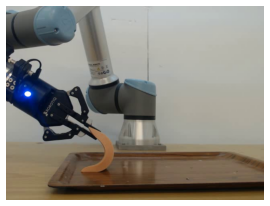


0: 480x640 1 LDO, 9.0ms
Speed: 0.8ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 8


<Figure size 518.4x691.2 with 0 Axes>

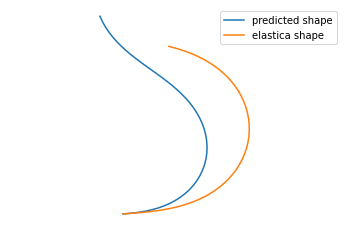

Labels: [0.255, 0.064, 0.11]
UNorm Label: (1.7650000000000001, 0.256, -0.30118)
pred (0.1971435546875, 0.11199951171875, 0.53955078125)
UNorm pred [1.5914306640625, 0.447998046875, 0.3268232421875]
shape_error: 3.9338752004331563e-07, elastica_error: 0.06338839835397403
-------------------------------------------------------------


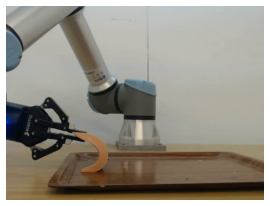


0: 480x640 1 LDO, 9.8ms
Speed: 0.9ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 6


<Figure size 518.4x691.2 with 0 Axes>

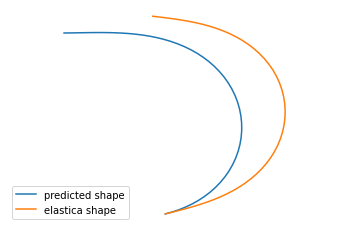

Labels: [0.224, 0.056, 0.18]
UNorm Label: (1.6720000000000002, 0.224, -0.19884000000000002)
pred (0.487060546875, 0.2213134765625, 0.277587890625)
UNorm pred [2.461181640625, 0.88525390625, -0.056166503906250054]
shape_error: 2.712362669317387e-07, elastica_error: 0.035350931083997096
-------------------------------------------------------------


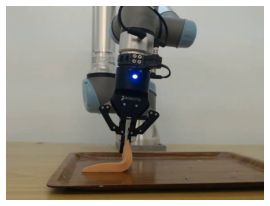


0: 480x640 1 LDO, 9.8ms
Speed: 0.8ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 13


<Figure size 518.4x691.2 with 0 Axes>

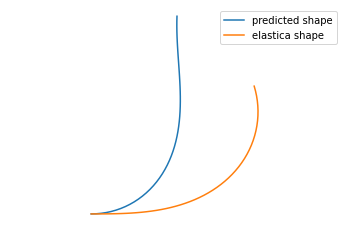

Labels: [0.314, 0.079, 0.08]
UNorm Label: (1.942, 0.316, -0.34504)
pred (0.58837890625, 0.3154296875, 0.51123046875)
UNorm pred [2.76513671875, 1.26171875, 0.28541894531249995]
shape_error: 7.925130962596639e-07, elastica_error: 0.10571416616821289
-------------------------------------------------------------


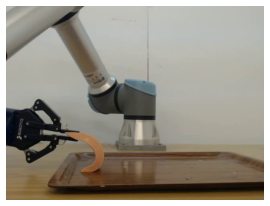


0: 480x640 1 LDO, 9.4ms
Speed: 0.8ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 5


<Figure size 518.4x691.2 with 0 Axes>

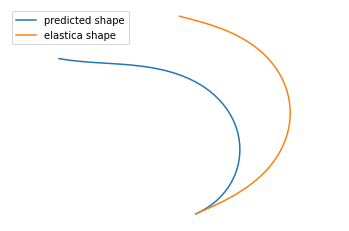

Labels: [0.224, 0.056, 0.326]
UNorm Label: (1.6720000000000002, 0.224, 0.014611999999999958)
pred (0.4892578125, 0.250732421875, 0.2379150390625)
UNorm pred [2.4677734375, 1.0029296875, -0.11416821289062501]
shape_error: 1.6540640984176105e-06, elastica_error: 0.038680461188316355
-------------------------------------------------------------


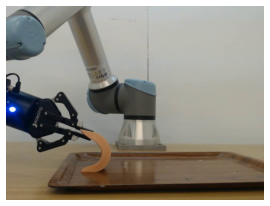


0: 480x640 1 LDO, 9.4ms
Speed: 0.7ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 7


<Figure size 518.4x691.2 with 0 Axes>

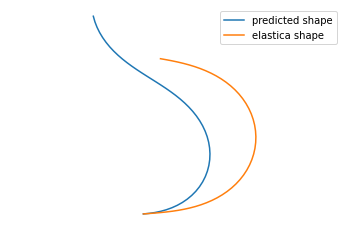

Labels: [0.234, 0.059, 0.114]
UNorm Label: (1.702, 0.236, -0.29533200000000004)
pred (0.2161865234375, 0.1351318359375, 0.48046875)
UNorm pred [1.6485595703125, 0.54052734375, 0.24044531249999995]
shape_error: 6.442904778755325e-07, elastica_error: 0.046804240372339885
-------------------------------------------------------------
total time: 10.368633270263672


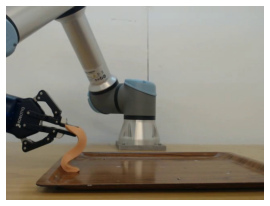


0: 480x640 1 LDO, 9.6ms
Speed: 0.7ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 4


<Figure size 518.4x691.2 with 0 Axes>

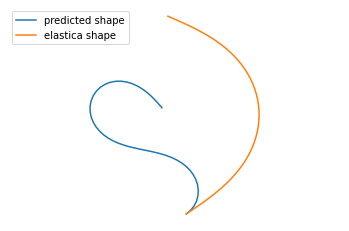

Labels: [0.224, 0.056, 0.48]
UNorm Label: (1.6720000000000002, 0.224, 0.23975999999999992)
pred (0.10321044921875, 0.15283203125, 0.08673095703125)
UNorm pred [1.30963134765625, 0.611328125, -0.33519934082031255]
shape_error: 6.183238192170259e-06, elastica_error: 0.05954236600383122
-------------------------------------------------------------


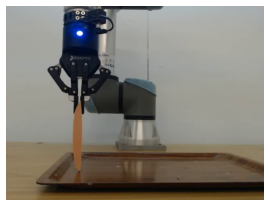


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 0


<Figure size 518.4x691.2 with 0 Axes>

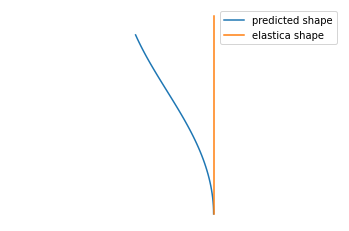

Labels: [0.224, 0.056, 1.0]
UNorm Label: (1.6720000000000002, 0.224, 1.0)
pred (0.85009765625, 0.496337890625, 0.75146484375)
UNorm pred [3.55029296875, 1.9853515625, 0.6366416015625]
shape_error: 7.408418721324533e-07, elastica_error: 0.21588848565800986
-------------------------------------------------------------


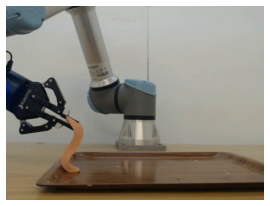


0: 480x640 1 LDO, 9.5ms
Speed: 0.7ms preprocess, 9.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 3


<Figure size 518.4x691.2 with 0 Axes>

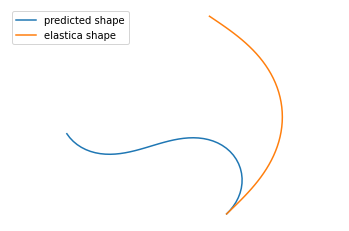

Labels: [0.224, 0.056, 0.626]
UNorm Label: (1.6720000000000002, 0.224, 0.453212)
pred (0.2249755859375, 0.1578369140625, 0.327392578125)
UNorm pred [1.6749267578125, 0.63134765625, 0.016647949218749958]
shape_error: 1.702312581834284e-05, elastica_error: 0.03317936707750956
-------------------------------------------------------------


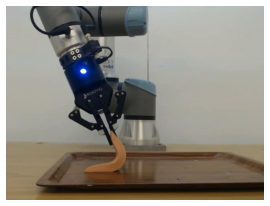


0: 480x640 1 LDO, 9.7ms
Speed: 0.7ms preprocess, 9.7ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 11


<Figure size 518.4x691.2 with 0 Axes>

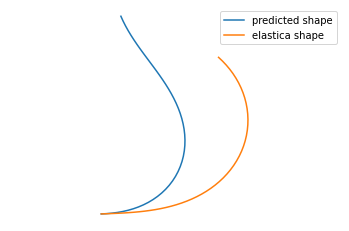

Labels: [0.32, 0.08, 0.094]
UNorm Label: (1.96, 0.32, -0.324572)
pred (0.2880859375, 0.1492919921875, 0.60107421875)
UNorm pred [1.8642578125, 0.59716796875, 0.41677050781249997]
shape_error: 1.4516416227027354e-06, elastica_error: 0.08764805029582978
-------------------------------------------------------------


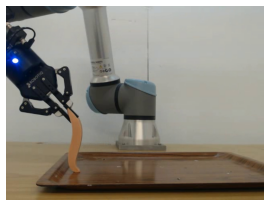


0: 480x640 1 LDO, 9.4ms
Speed: 0.8ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 2


<Figure size 518.4x691.2 with 0 Axes>

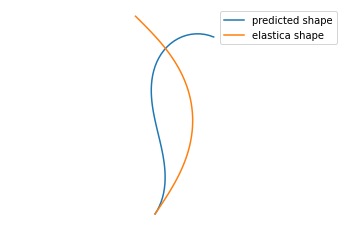

Labels: [0.224, 0.056, 0.77]
UNorm Label: (1.6720000000000002, 0.224, 0.66374)
pred (0.397216796875, 0.319091796875, 0.196533203125)
UNorm pred [2.191650390625, 1.2763671875, -0.17466845703125]
shape_error: 1.70843826761315e-07, elastica_error: 0.14269517314020794
-------------------------------------------------------------


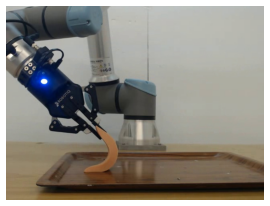


0: 480x640 1 LDO, 9.9ms
Speed: 0.8ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 9


<Figure size 518.4x691.2 with 0 Axes>

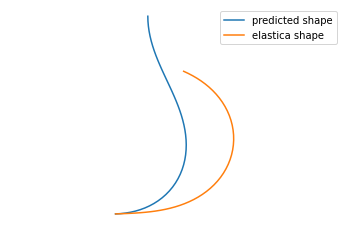

Labels: [0.277, 0.069, 0.104]
UNorm Label: (1.831, 0.276, -0.309952)
pred (0.281982421875, 0.1651611328125, 0.623046875)
UNorm pred [1.845947265625, 0.66064453125, 0.44889453124999995]
shape_error: 5.168106999564693e-07, elastica_error: 0.09289381547959646
-------------------------------------------------------------


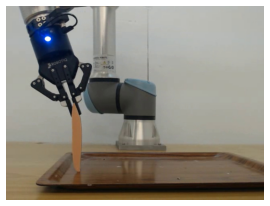


0: 480x640 1 LDO, 9.4ms
Speed: 0.7ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 1


<Figure size 518.4x691.2 with 0 Axes>

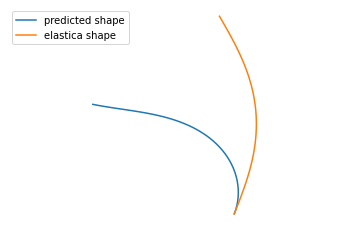

Labels: [0.224, 0.056, 0.901]
UNorm Label: (1.6720000000000002, 0.224, 0.855262)
pred (0.81494140625, 0.43115234375, 0.1566162109375)
UNorm pred [3.44482421875, 1.724609375, -0.23302709960937504]
shape_error: 8.684590062551304e-06, elastica_error: 0.3480194173536301
-------------------------------------------------------------


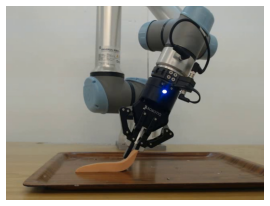


0: 480x640 1 LDO, 8.6ms
Speed: 0.8ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 15


<Figure size 518.4x691.2 with 0 Axes>

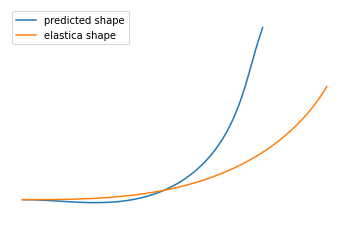

Labels: [0.27, 0.068, 0.07]
UNorm Label: (1.81, 0.272, -0.35966)
pred (0.1873779296875, 0.07086181640625, 0.84814453125)
UNorm pred [1.5621337890625, 0.283447265625, 0.7779873046875001]
shape_error: 5.2131653488723285e-09, elastica_error: 0.20411450267004963
-------------------------------------------------------------


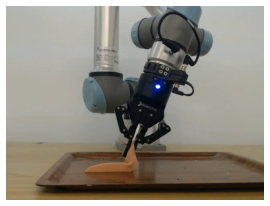


0: 480x640 1 LDO, 10.1ms
Speed: 0.8ms preprocess, 10.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 14


<Figure size 518.4x691.2 with 0 Axes>

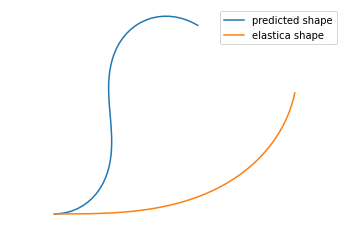

Labels: [0.293, 0.073, 0.07]
UNorm Label: (1.879, 0.292, -0.35966)
pred (0.1676025390625, 0.1710205078125, 0.5078125)
UNorm pred [1.5028076171875, 0.68408203125, 0.280421875]
shape_error: 1.1990131005390782e-06, elastica_error: 0.0723374427725474
-------------------------------------------------------------


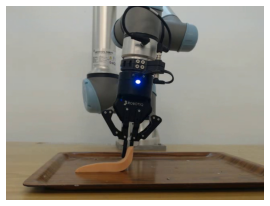


0: 480x640 1 LDO, 8.6ms
Speed: 0.8ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
frame num 16


<Figure size 518.4x691.2 with 0 Axes>

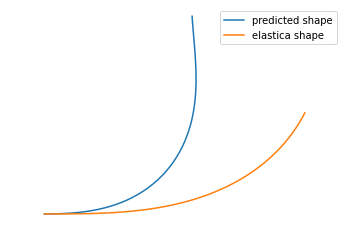

Labels: [0.25, 0.062, 0.06]
UNorm Label: (1.75, 0.248, -0.37428000000000006)
pred (0.3232421875, 0.1363525390625, 0.77587890625)
UNorm pred [1.9697265625, 0.54541015625, 0.6723349609375]
shape_error: 8.019598006342921e-08, elastica_error: 0.17445844216950732
-------------------------------------------------------------


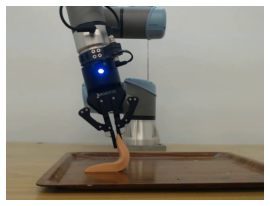


0: 480x640 1 LDO, 9.5ms
Speed: 0.8ms preprocess, 9.5ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 12


<Figure size 518.4x691.2 with 0 Axes>

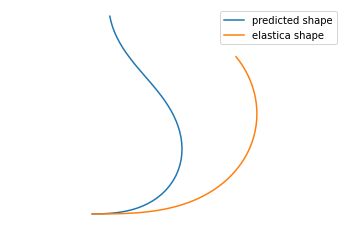

Labels: [0.336, 0.084, 0.09]
UNorm Label: (2.008, 0.336, -0.33042000000000005)
pred (0.1890869140625, 0.10748291015625, 0.59619140625)
UNorm pred [1.5672607421875, 0.429931640625, 0.4096318359374999]
shape_error: 2.676764808441649e-06, elastica_error: 0.09278821388347945
-------------------------------------------------------------


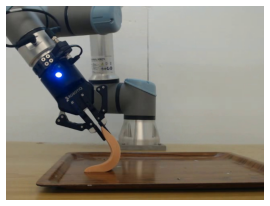


0: 480x640 1 LDO, 9.0ms
Speed: 0.7ms preprocess, 9.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
frame num 10


<Figure size 518.4x691.2 with 0 Axes>

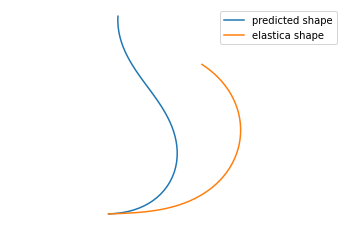

Labels: [0.298, 0.074, 0.1]
UNorm Label: (1.894, 0.296, -0.3158)
pred (0.2100830078125, 0.1324462890625, 0.59765625)
UNorm pred [1.6302490234375, 0.52978515625, 0.4117734375]
shape_error: 1.9746675730891866e-06, elastica_error: 0.08626903646151225
-------------------------------------------------------------


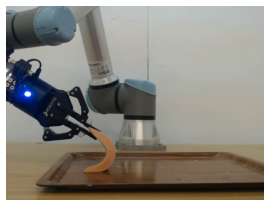


0: 480x640 1 LDO, 9.4ms
Speed: 0.7ms preprocess, 9.4ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
frame num 8


<Figure size 518.4x691.2 with 0 Axes>

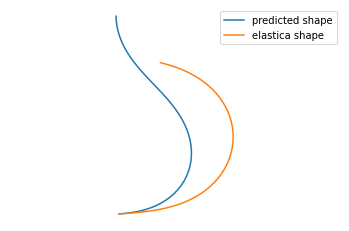

Labels: [0.255, 0.064, 0.11]
UNorm Label: (1.7650000000000001, 0.256, -0.30118)
pred (0.180908203125, 0.114501953125, 0.59130859375)
UNorm pred [1.542724609375, 0.4580078125, 0.40249316406249996]
shape_error: 3.9825094469607817e-07, elastica_error: 0.07989933468373617
-------------------------------------------------------------


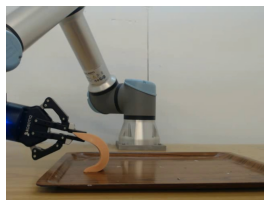


0: 480x640 1 LDO, 9.7ms
Speed: 0.8ms preprocess, 9.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
frame num 6


<Figure size 518.4x691.2 with 0 Axes>

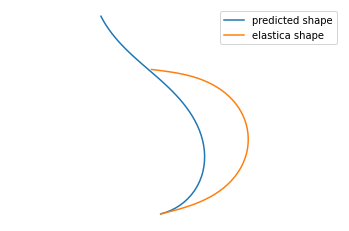

Labels: [0.224, 0.056, 0.18]
UNorm Label: (1.6720000000000002, 0.224, -0.19884000000000002)
pred (0.451416015625, 0.261474609375, 0.293212890625)
UNorm pred [2.354248046875, 1.0458984375, -0.03332275390625006]
shape_error: 5.533594201107975e-07, elastica_error: 0.035585005954742434
-------------------------------------------------------------


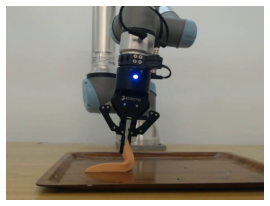


0: 480x640 1 LDO, 9.8ms
Speed: 0.7ms preprocess, 9.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 13


<Figure size 518.4x691.2 with 0 Axes>

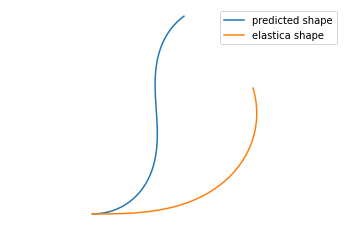

Labels: [0.314, 0.079, 0.08]
UNorm Label: (1.942, 0.316, -0.34504)
pred (0.26416015625, 0.1912841796875, 0.60986328125)
UNorm pred [1.79248046875, 0.76513671875, 0.4296201171875]
shape_error: 1.6336580157293985e-06, elastica_error: 0.09861561461671196
-------------------------------------------------------------


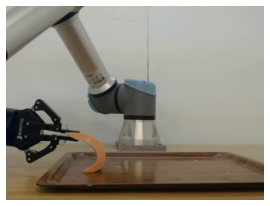


0: 480x640 1 LDO, 9.2ms
Speed: 0.8ms preprocess, 9.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
frame num 5


<Figure size 518.4x691.2 with 0 Axes>

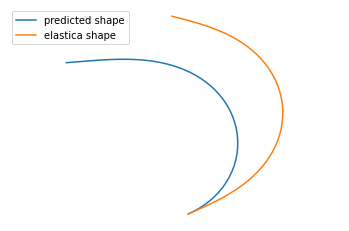

Labels: [0.224, 0.056, 0.326]
UNorm Label: (1.6720000000000002, 0.224, 0.014611999999999958)
pred (0.556640625, 0.26220703125, 0.2275390625)
UNorm pred [2.669921875, 1.048828125, -0.129337890625]
shape_error: 9.694350460467874e-07, elastica_error: 0.05428856045023601
-------------------------------------------------------------


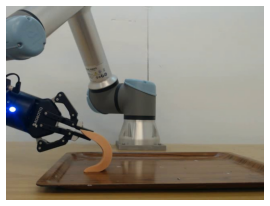


0: 480x640 1 LDO, 10.2ms
Speed: 0.9ms preprocess, 10.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 7


<Figure size 518.4x691.2 with 0 Axes>

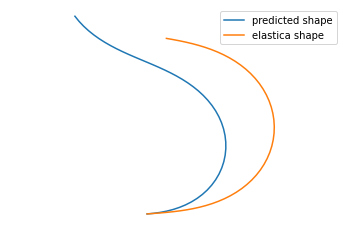

Labels: [0.234, 0.059, 0.114]
UNorm Label: (1.702, 0.236, -0.29533200000000004)
pred (0.2420654296875, 0.1373291015625, 0.43505859375)
UNorm pred [1.7261962890625, 0.54931640625, 0.1740556640625]
shape_error: 6.105558920794423e-07, elastica_error: 0.03642637330945333
-------------------------------------------------------------


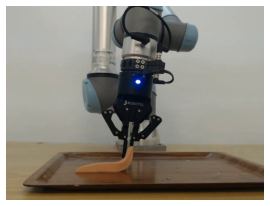


0: 480x640 1 LDO, 9.0ms
Speed: 0.7ms preprocess, 9.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
frame num 17


<Figure size 518.4x691.2 with 0 Axes>

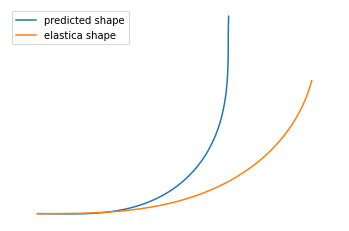

Labels: [0.227, 0.057, 0.06]
UNorm Label: (1.681, 0.228, -0.37428000000000006)
pred (0.2491455078125, 0.0970458984375, 0.7978515625)
UNorm pred [1.7474365234375, 0.38818359375, 0.704458984375]
shape_error: 1.2330392256220498e-08, elastica_error: 0.18217300859387717
-------------------------------------------------------------
total time: 21.456812381744385


<Figure size 384x256 with 0 Axes>

In [25]:
real_data_path_salmon = './data_real_shapes/video_with_planner/videos/data/salmon/salmon'

df_salmon = real_path_loop(real_data_path_salmon)


#### Path display

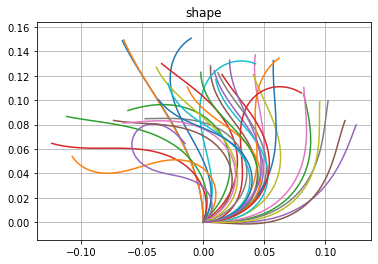

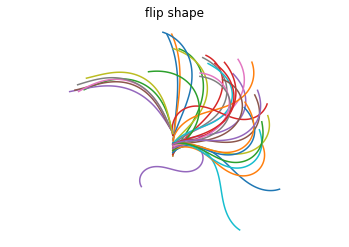

In [26]:
for x,y in zip(df_salmon.x_shape,df_salmon.y_shape):
    plt.plot((x-x[0])*(L-l),(y-y[0])*(L-l))
plt.title("shape")
plt.axis('equal')
plt.grid('minor')
# plt.axis('off')
plt.show()
for x,y in zip(df_salmon.x_flip,df_salmon.y_flip):
    plt.plot((x-x[0])*(L-l),(-y-y[0])*(L-l))
plt.title("flip shape")
plt.axis('equal')
plt.grid('minor')
plt.axis('off')
plt.show()

### Bass filet path

In [ ]:
real_data_path_bass = './data_real_shapes/video_with_planner/videos/data/bass/bass'

df_bass = real_path_loop(real_data_path_bass)


#### Path display

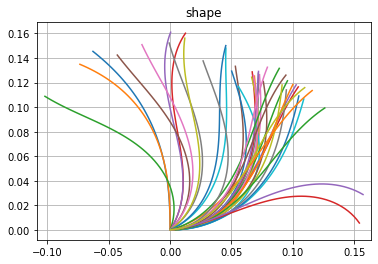

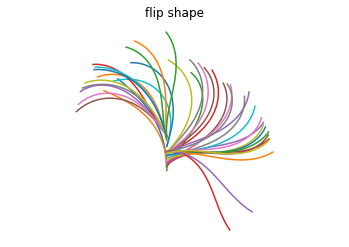

In [28]:
for x,y in zip(df_bass.x_shape,df_bass.y_shape):
    plt.plot((x-x[0])*(L-l),(y-y[0])*(L-l))
plt.title("shape")
plt.axis('equal')
plt.grid('minor')
# plt.axis('off')
plt.show()
for x,y in zip(df_bass.x_flip,df_bass.y_flip):
    plt.plot((x-x[0])*(L-l),(-y-y[0])*(L-l))
plt.title("flip shape")
plt.axis('equal')
plt.grid('minor')
plt.axis('off')
plt.show()

### Yellow cheese path

In [ ]:
real_data_path_yellowcheese = './data_real_shapes/video_with_planner/videos/data/yellowcheese/yellowcheese'

df_yellowcheese = real_path_loop(real_data_path_yellowcheese)

### Statistical Results for Real Case

#### Separate boxplot and hist

total time: 490.2103953361511
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.0916 ± 0.0546
Tangent_error: 0.1231 ± 0.2289


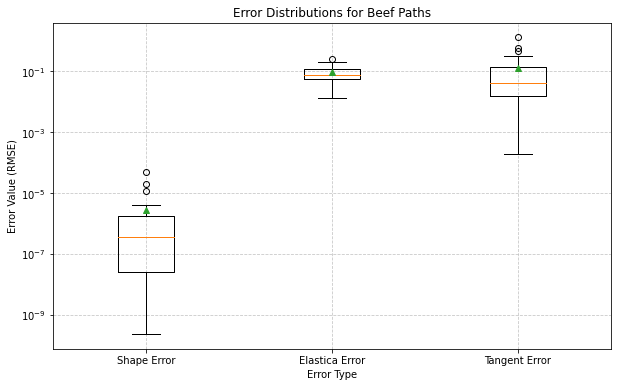

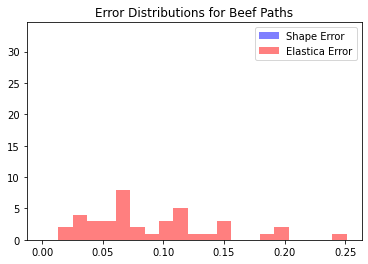


Summary Statistics:
        shape_error  elastica_error  tangent_error
count  4.000000e+01       40.000000      40.000000
mean   2.717234e-06        0.091604       0.123076
std    8.285243e-06        0.054613       0.228922
min    2.368583e-10        0.013141       0.000189
25%    2.499062e-08        0.054021       0.015672
50%    3.497181e-07        0.075578       0.041675
75%    1.811962e-06        0.118990       0.139800
max    4.851202e-05        0.251110       1.284122
--------------------------------------------------------------
total time: 379.07091546058655
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.1176 ± 0.0762
Tangent_error: 1.2915 ± 4.7122


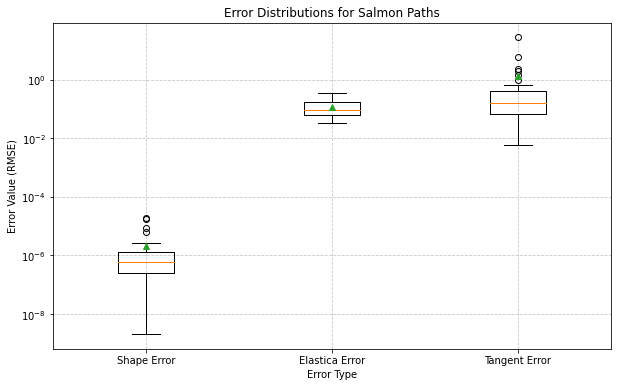

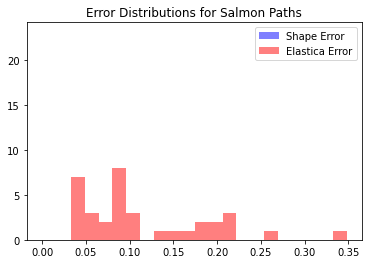


Summary Statistics:
        shape_error  elastica_error  tangent_error
count  3.500000e+01       35.000000      35.000000
mean   2.059246e-06        0.117552       1.291512
std    4.318969e-06        0.076237       4.712216
min    2.092077e-09        0.033179       0.006125
25%    2.572107e-07        0.061465       0.068540
50%    6.105559e-07        0.092788       0.163550
75%    1.325327e-06        0.178316       0.402406
max    1.875290e-05        0.348019      27.643462
--------------------------------------------------------------
total time: 464.94176626205444
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.1763 ± 0.0808
Tangent_error: 2.3396 ± 7.9317


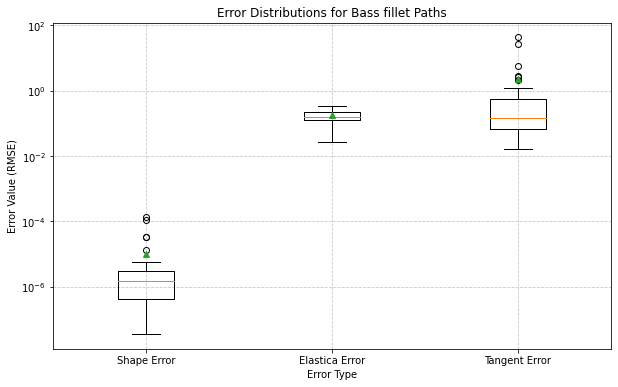

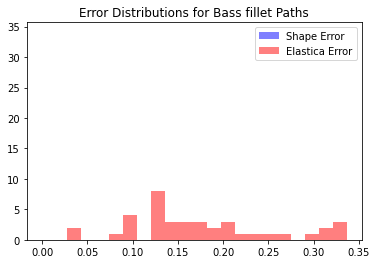


Summary Statistics:
        shape_error  elastica_error  tangent_error
count  3.900000e+01       39.000000      39.000000
mean   9.815810e-06        0.176287       2.339631
std    2.825624e-05        0.080823       7.931744
min    3.634341e-08        0.027583       0.016782
25%    4.311623e-07        0.124490       0.067650
50%    1.507211e-06        0.157635       0.149397
75%    3.092829e-06        0.217261       0.552124
max    1.358354e-04        0.336381      42.324653
--------------------------------------------------------------
total time: 220.19354581832886
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.1211 ± 0.0936
Tangent_error: 2.6000 ± 6.1179


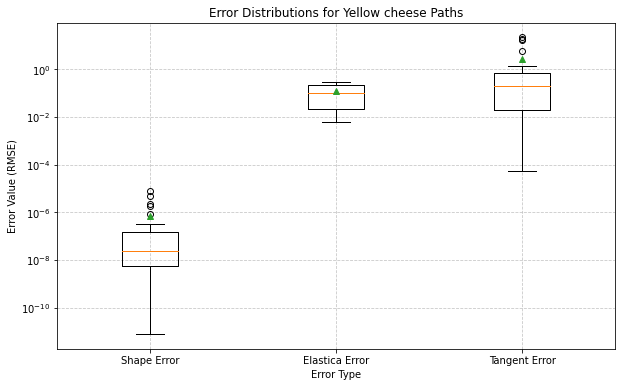

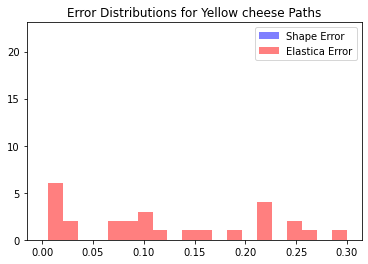


Summary Statistics:
        shape_error  elastica_error  tangent_error
count  2.700000e+01       27.000000      27.000000
mean   6.930036e-07        0.121122       2.599972
std    1.770926e-06        0.093609       6.117868
min    7.747959e-12        0.005866       0.000056
25%    5.319001e-09        0.022300       0.020587
50%    2.471993e-08        0.100886       0.201554
75%    1.415527e-07        0.213178       0.734344
max    7.758938e-06        0.299680      21.784477
--------------------------------------------------------------


In [31]:
food_types = ['Beef', 'Salmon', 'Bass fillet', 'Yellow cheese']
food_dfs = {
    'Beef': df_beef,
    'Salmon': df_salmon,
    'Bass fillet': df_bass,
    'Yellow cheese': df_yellowcheese
}
for food_type, df_real in food_dfs.items():
    # Create boxplot data
    box_data = [
        df_real['shape_error'],
        df_real['elastica_error'],
        df_real['tangent_error']
    ]

    # Create boxplot
    plt.figure(figsize=(10, 6),facecolor='white')
    bp = plt.boxplot(box_data, labels=['Shape Error', 'Elastica Error', 'Tangent Error'],showmeans=True, ) #showfliers=False
    # Customize the plot
    plt.title(f'Error Distributions for {food_type} Paths')
    plt.xlabel('Error Type')
    plt.ylabel('Error Value (RMSE)')
    plt.grid(True, linestyle='--', alpha=0.7)

    # Add some statistics as text

    trajectory_total_time = df_real['time'].sum()
    print(f"total time: {trajectory_total_time}")

    for i, metric in enumerate(['shape_error', 'elastica_error', 'tangent_error'], 1):
        mean_val = df_real[metric].mean()
        std_val = df_real[metric].std()
        print(f"{metric.capitalize()}: {mean_val:.4f} ± {std_val:.4f}")

    plt.yscale('log')
    plt.show()
    hist = plt.hist(df_real['shape_error'], bins=20, alpha=0.5, color='b', label='Shape Error')
    hist = plt.hist(df_real['elastica_error'], bins=20, alpha=0.5, color='r', label='Elastica Error')
    # hist = plt.hist(df_real['tangent_error'], bins=20, alpha=0.5, color='g', label='Tangent Error')
    plt.legend()
    plt.title(f'Error Distributions for {food_type} Paths')        
    plt.show()

    # Print summary statistics
    print("\nSummary Statistics:")
    print(df_real[['shape_error', 'elastica_error', 'tangent_error']].describe())
    print("--------------------------------------------------------------")


#### Combined boxplots


Beef Statistics:
Total time: 490.21
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.0916 ± 0.0546
Tangent_error: 0.1231 ± 0.2289
Time: 12.2553 ± 6.9551

Salmon Statistics:
Total time: 379.07
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.1176 ± 0.0762
Tangent_error: 1.2915 ± 4.7122
Time: 10.8306 ± 6.3014

Bass fillet Statistics:
Total time: 464.94
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.1763 ± 0.0808
Tangent_error: 2.3396 ± 7.9317
Time: 11.9216 ± 6.7470

Yellow cheese Statistics:
Total time: 220.19
Shape_error: 0.0000 ± 0.0000
Elastica_error: 0.1211 ± 0.0936
Tangent_error: 2.6000 ± 6.1179
Time: 8.1553 ± 4.6450


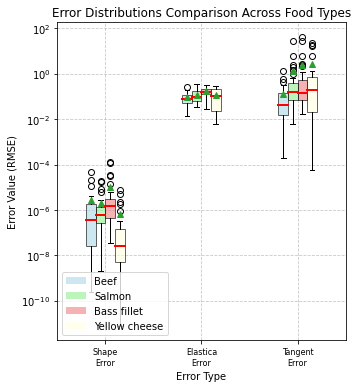


Beef Summary Statistics:
        shape_error  elastica_error  tangent_error
count  4.000000e+01       40.000000      40.000000
mean   2.717234e-06        0.091604       0.123076
std    8.285243e-06        0.054613       0.228922
min    2.368583e-10        0.013141       0.000189
25%    2.499062e-08        0.054021       0.015672
50%    3.497181e-07        0.075578       0.041675
75%    1.811962e-06        0.118990       0.139800
max    4.851202e-05        0.251110       1.284122
--------------------------------------------------------------

Salmon Summary Statistics:
        shape_error  elastica_error  tangent_error
count  3.500000e+01       35.000000      35.000000
mean   2.059246e-06        0.117552       1.291512
std    4.318969e-06        0.076237       4.712216
min    2.092077e-09        0.033179       0.006125
25%    2.572107e-07        0.061465       0.068540
50%    6.105559e-07        0.092788       0.163550
75%    1.325327e-06        0.178316       0.402406
max    1.875290e

In [32]:
import matplotlib.pyplot as plt
import numpy as np

# Create figure
plt.figure(figsize=(5, 5.5), facecolor='white')

# Calculate positions for grouped boxplots
num_foods = len(food_types)
num_metrics = 3
positions = np.arange(num_metrics)
width = 0.1  # Width of each boxplot

# Create grouped boxplots
for i, (food_type, df_real) in enumerate(food_dfs.items()):
    # Offset each food type's boxplots
    pos = positions + (i - num_foods/2 + 0.5) * width
    
    # Create boxplot data
    box_data = [
        df_real['shape_error'],
        df_real['elastica_error'],
        df_real['tangent_error']
    ]
    
    # Plot boxplots for this food type
    bp = plt.boxplot(box_data, 
                     positions=pos,
                     widths=width,
                     patch_artist=True,
                     showmeans=True,
                     showfliers=True,
                     labels=[''] * num_metrics)
    
    # Customize boxplot colors
    colors = ['lightblue', 'lightgreen', 'lightcoral', 'lightyellow']
    for patch in bp['boxes']:
        patch.set_facecolor(colors[i])
        patch.set_alpha(0.6)
    
    # Change median line color
    for median in bp['medians']:
        median.set_color('red') 
        median.set_linewidth(2) 
    
    # Print statistics
    trajectory_total_time = df_real['time'].sum()
    print(f"\n{food_type} Statistics:")
    print(f"Total time: {trajectory_total_time:.2f}")
    for metric in ['shape_error', 'elastica_error', 'tangent_error', 'time']:
        mean_val = df_real[metric].mean()
        std_val = df_real[metric].std()
        print(f"{metric.capitalize()}: {mean_val:.4f} ± {std_val:.4f}")

# Customize plot
plt.yscale('log')
plt.grid(True, linestyle='--', alpha=0.7)
plt.title('Error Distributions Comparison Across Food Types')
plt.xlabel('Error Type')
plt.ylabel('Error Value (RMSE)')

# Set x-ticks in the middle of each group
plt.xticks(positions, ['Shape\nError', 'Elastica\nError', 'Tangent\nError'], 
           fontsize=8) 
plt.xlim(-0.5, num_metrics - 0.5)  # Tighter x-axis limits

# Add legend
legend_elements = [plt.Rectangle((0,0),1,1, facecolor=colors[i], alpha=0.6) 
                  for i in range(len(food_types))]
plt.legend(legend_elements, food_types, loc='lower left')

plt.tight_layout()
plt.show()

# Print summary statistics for all food types
for food_type, df_real in food_dfs.items():
    print(f"\n{food_type} Summary Statistics:")
    print(df_real[['shape_error', 'elastica_error', 'tangent_error']].describe())
    print("--------------------------------------------------------------")